In [1]:
"""Analyse the recorded spot data, the delayed actions and the processed/sampled training data."""

import pickle
from typing import List, Union, Tuple
import numpy as np
import jax.numpy as jnp
import os
import glob
import matplotlib.pyplot as plt
from experiments.data_provider import (
    get_spot_recorded_data,
    _load_spot_datasets,
    _prepare_spot_datasets,
)
from sim_transfer.sims.util import encode_angles as encode_angles_fn

# presets
state_labels_encoded = [
    "base_x",
    "base_y",
    "base_theta_sin",
    "base_theta_cos",
    "base_vx",
    "base_vy",
    "base_vtheta",
    "ee_x",
    "ee_y",
    "ee_z",
    "ee_vx",
    "ee_vy",
    "ee_vz",
]
state_labels_normal = [
    "base_x",
    "base_y",
    "base_theta",
    "base_vx",
    "base_vy",
    "base_vtheta",
    "ee_x",
    "ee_y",
    "ee_z",
    "ee_vx",
    "ee_vy",
    "ee_vz",
]
action_labels = ["base_vx", "base_vy", "base_vtheta", "ee_vx", "ee_vy", "ee_vz"]

# load data
recordings_dirs = [
    "/home/bhoffman/Documents/MT_FS24/simulation_transfer/data/single_movement_spot_new"
]
files = sorted(
    [
        file
        for dir_path in recordings_dirs
        for file in glob.glob(os.path.join(dir_path, "*.pickle"))
    ]
)

files = files[9:10]

print(files)

# load datasets
data_raw = _load_spot_datasets(files)
data_set = data_raw[0]
x, u, y = data_set
print(f"Loaded data set with {len(x)} samples")

# cut data
cut_idx_start = 0
cut_idx_end = len(x)
x, u, y = (
    x[cut_idx_start:cut_idx_end],
    u[cut_idx_start:cut_idx_end],
    y[cut_idx_start:cut_idx_end],
)

# delay actions
action_delay_base = 2
action_delay_ee = 1
u_base, u_ee = u[:, :3], u[:, 3:]
if action_delay_base > 0:
    u_delayed_start = jnp.zeros_like(u_base[:action_delay_base])
    u_delayed_base = jnp.concatenate([u_delayed_start, u_base[:-action_delay_base]])
    assert (
        u_delayed_base.shape == u_base.shape
    ), "Something went wrong with the base action delay"
    u_base = u_delayed_base

if action_delay_ee > 0:
    u_delayed_start = jnp.zeros_like(u_ee[:action_delay_ee])
    u_delayed_ee = jnp.concatenate([u_delayed_start, u_ee[:-action_delay_ee]])
    assert (
        u_delayed_ee.shape == u_ee.shape
    ), "Something went wrong with the ee action delay"
    u_ee = u_delayed_ee

u_delayed = jnp.concatenate([u_base, u_ee], axis=-1)

# plot raw data
fig, axs = plt.subplots(len(state_labels_normal), 1, figsize=(20, 30))

# states
for i, label in enumerate(state_labels_normal):
    axs[i].set_title(label)
    axs[i].plot(x[:, i], label=label)

# actions
axs[0].plot(u[:, 0], label="action", linestyle="--")
axs[1].plot(u[:, 1], label="action", linestyle="--")
axs[2].plot(u[:, 2], label="action", linestyle="--")
axs[3].plot(u[:, 0], label="action", linestyle="--")
axs[4].plot(u[:, 1], label="action", linestyle="--")
axs[5].plot(u[:, 2], label="action", linestyle="--")

axs[6].plot(u[:, 3], label="action", linestyle="--")
axs[7].plot(u[:, 4], label="action", linestyle="--")
axs[8].plot(u[:, 5], label="action", linestyle="--")
axs[9].plot(u[:, 3], label="action", linestyle="--")
axs[10].plot(u[:, 4], label="action", linestyle="--")
axs[11].plot(u[:, 5], label="action", linestyle="--")

# actions delayed
axs[0].plot(u_delayed[:, 0], label="action delayed", linestyle="-.")
axs[1].plot(u_delayed[:, 1], label="action delayed", linestyle="-.")
axs[2].plot(u_delayed[:, 2], label="action delayed", linestyle="-.")
axs[3].plot(u_delayed[:, 0], label="action delayed", linestyle="-.")
axs[4].plot(u_delayed[:, 1], label="action delayed", linestyle="-.")
axs[5].plot(u_delayed[:, 2], label="action delayed", linestyle="-.")

axs[6].plot(u_delayed[:, 3], label="action delayed", linestyle="-.")
axs[7].plot(u_delayed[:, 4], label="action delayed", linestyle="-.")
axs[8].plot(u_delayed[:, 5], label="action delayed", linestyle="-.")
axs[9].plot(u_delayed[:, 3], label="action delayed", linestyle="-.")
axs[10].plot(u_delayed[:, 4], label="action delayed", linestyle="-.")
axs[11].plot(u_delayed[:, 5], label="action delayed", linestyle="-.")

# plot
for ax in axs:
    ax.legend()
fig.suptitle("Raw data")
fig.subplots_adjust(top=0.95)
fig.show()

# plot 2D trajectory for base and ee
# make sure axes both go from -2 to 2
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
ax.plot(x[:, 0], x[:, 1], label="base", color="red")
ax.plot(x[:, 6], x[:, 7], label="ee", color="blue")
# add start and end points as markers
ax.plot(x[0, 0], x[0, 1], "o", label="start base", color="red")
ax.plot(x[0, 6], x[0, 7], "o", label="start ee", color="blue")
ax.plot(x[-1, 0], x[-1, 1], "x", label="end base", color="red")
ax.plot(x[-1, 6], x[-1, 7], "x", label="end ee", color="blue")
ax.set_xlim(-2, 2)
ax.set_ylim(-2, 2)

ax.legend()
fig.suptitle("2D trajectory for base and ee")
fig.show()

# plot interactive 3D trajectory for ee, make sure I can move it around
# make sure axes both go from -2 to 2
fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111, projection="3d")
ax.plot(x[:, 6], x[:, 7], x[:, 8], label="ee", color="blue")
# add start and end points as markers
ax.plot(x[0, 6], x[0, 7], x[0, 8], "o", label="start ee", color="blue")
ax.plot(x[-1, 6], x[-1, 7], x[-1, 8], "x", label="end ee", color="blue")
ax.set_xlim(-2, 2)
ax.set_ylim(-2, 2)
ax.set_zlim(-2, 2)

ax.legend()
fig.suptitle("3D trajectory for ee")
fig.show()

# process data, ie. sample data for training
x_train, y_train, x_test, y_test = get_spot_recorded_data(
    encode_angle=False,
    skip_first_n_points=10,
    action_delay_base=2,
    action_delay_ee=1,
    action_stacking=False,
    angle_idx=2,
)

# cut data
x_train, y_train = (
    x_train[cut_idx_start:cut_idx_end],
    y_train[cut_idx_start:cut_idx_end],
)

# plot processed data
fig, axs = plt.subplots(len(state_labels_normal), 1, figsize=(20, 30))

# states
for i, label in enumerate(state_labels_normal):
    axs[i].plot(x_train[:, i], label=label)
    axs[i].set_title(label)

# actions
split_idx = 12
axs[0].plot(x_train[:, split_idx], label="action", linestyle="--")
axs[1].plot(x_train[:, split_idx + 1], label="action", linestyle="--")
axs[2].plot(x_train[:, split_idx + 2], label="action", linestyle="--")
axs[3].plot(x_train[:, split_idx], label="action", linestyle="--")
axs[4].plot(x_train[:, split_idx + 1], label="action", linestyle="--")
axs[5].plot(x_train[:, split_idx + 2], label="action", linestyle="--")

axs[6].plot(x_train[:, split_idx + 3], label="action", linestyle="--")
axs[7].plot(x_train[:, split_idx + 4], label="action", linestyle="--")
axs[8].plot(x_train[:, split_idx + 5], label="action", linestyle="--")
axs[9].plot(x_train[:, split_idx + 3], label="action", linestyle="--")
axs[10].plot(x_train[:, split_idx + 4], label="action", linestyle="--")
axs[11].plot(x_train[:, split_idx + 5], label="action", linestyle="--")

# plot
for ax in axs:
    ax.legend()
fig.suptitle("Processed data for training")
fig.subplots_adjust(top=0.95)
fig.show()

0.00s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - to python to disable frozen modules.
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.


KeyboardInterrupt: 

(50, 120, 15) (50, 120, 6)
Trajectory 1


/tmp/ipykernel_3746529/253087054.py:41: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "go" (-> marker='o'). The keyword argument will take precedence.
  ax1.plot(data[0, 0], data[0, 1], 'go', marker='o', label="Base Start")
/tmp/ipykernel_3746529/253087054.py:42: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "gs" (-> marker='s'). The keyword argument will take precedence.
  ax1.plot(data[-1, 0], data[-1, 1], 'gs', marker='s', label="Base End")
/tmp/ipykernel_3746529/253087054.py:43: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "bo" (-> marker='o'). The keyword argument will take precedence.
  ax1.plot(data[0, 6], data[0, 7], 'bo', marker='o', label="EE Start")
/tmp/ipykernel_3746529/253087054.py:44: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "bs" (-> marker='s'). The keyword argument will 

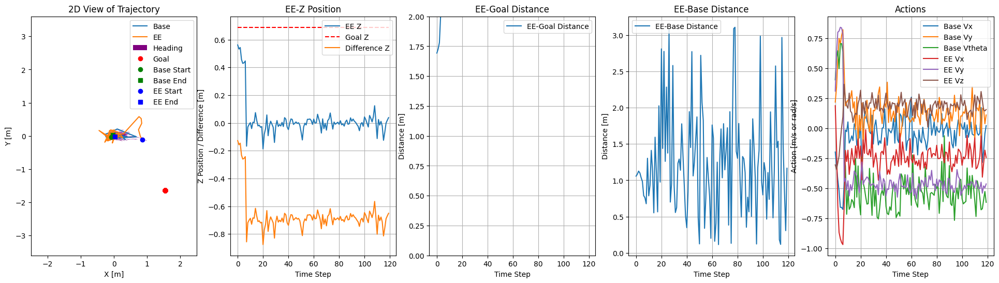

Trajectory 2


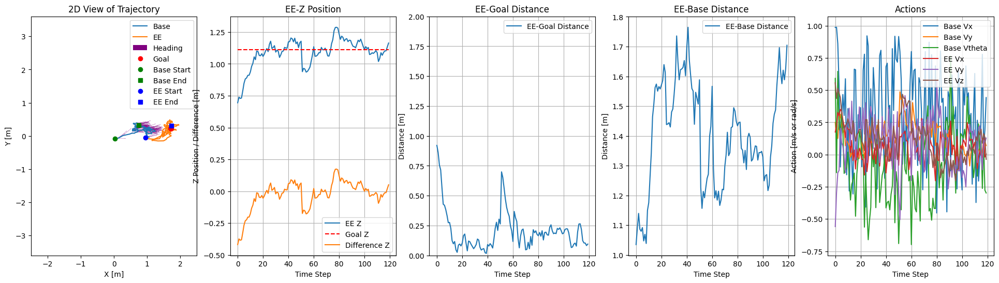

Trajectory 3


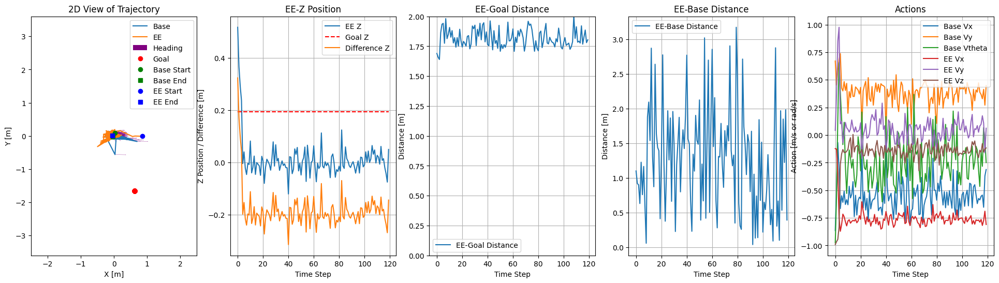

Trajectory 4


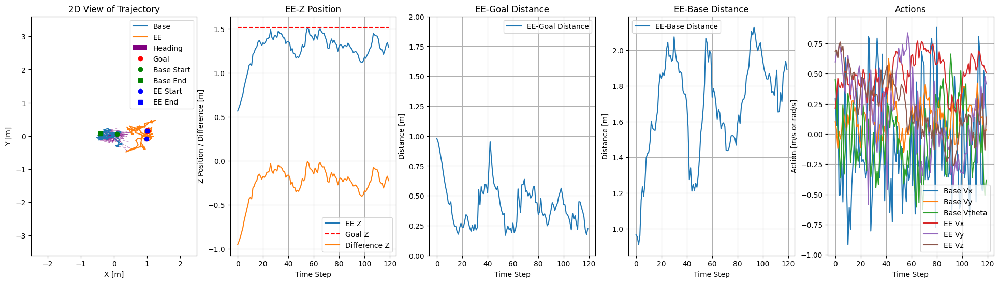

Trajectory 5


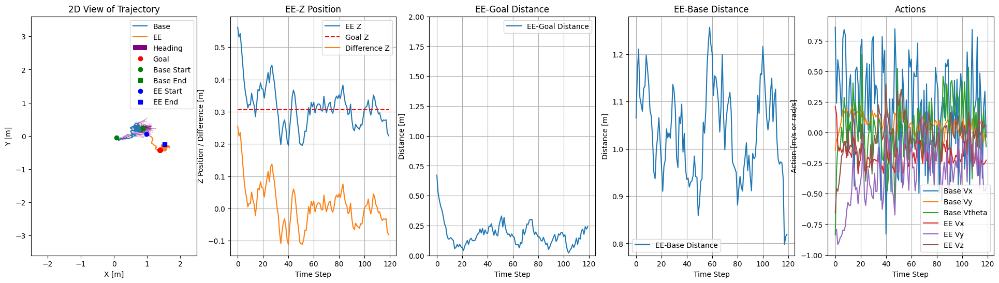

Trajectory 6


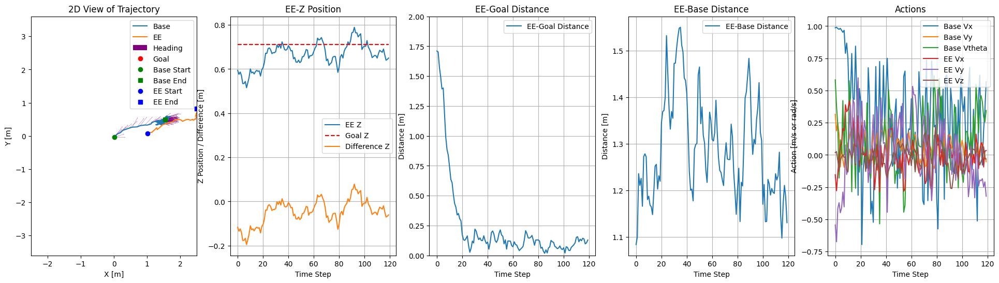

Trajectory 7


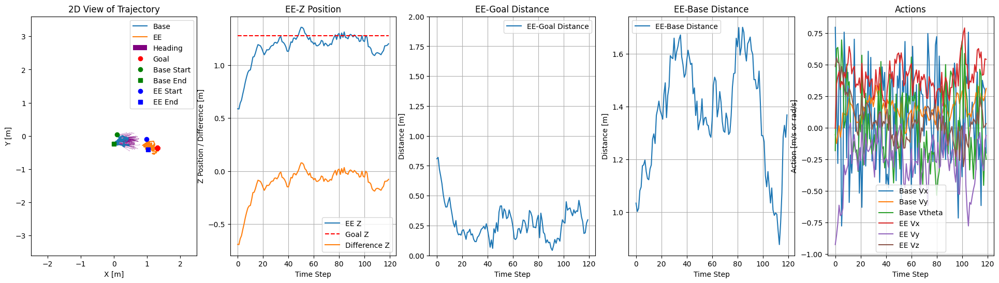

Trajectory 8


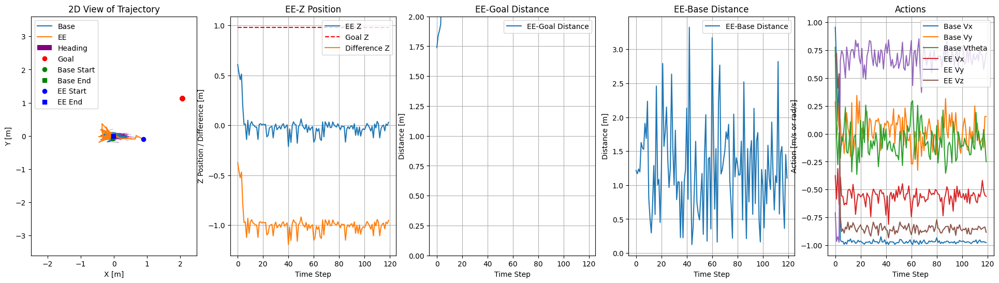

Trajectory 9


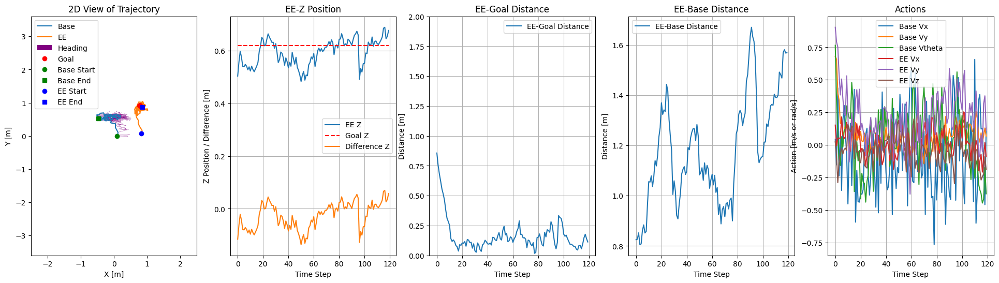

Trajectory 10


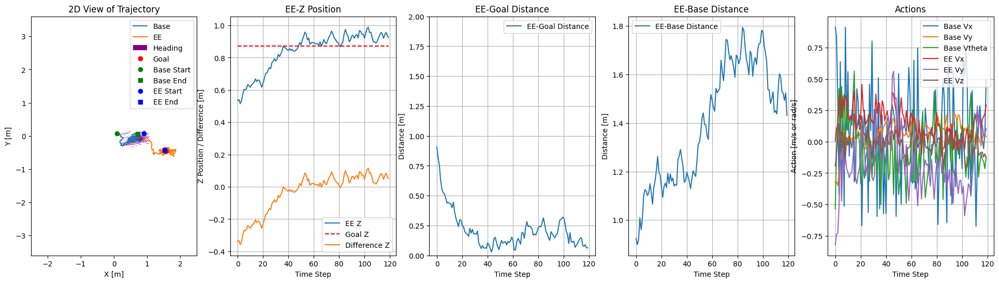

Trajectory 11


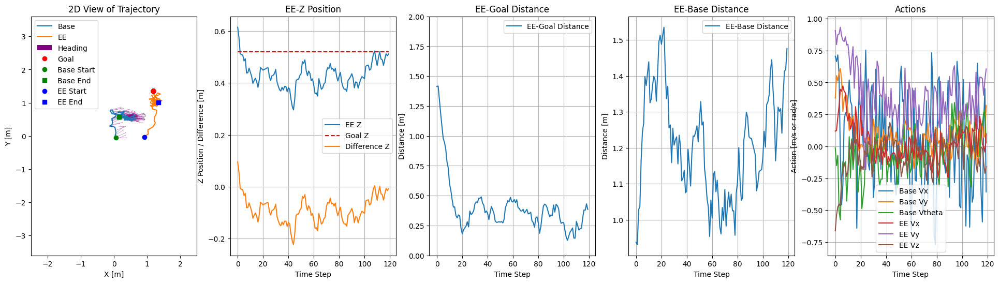

Trajectory 12


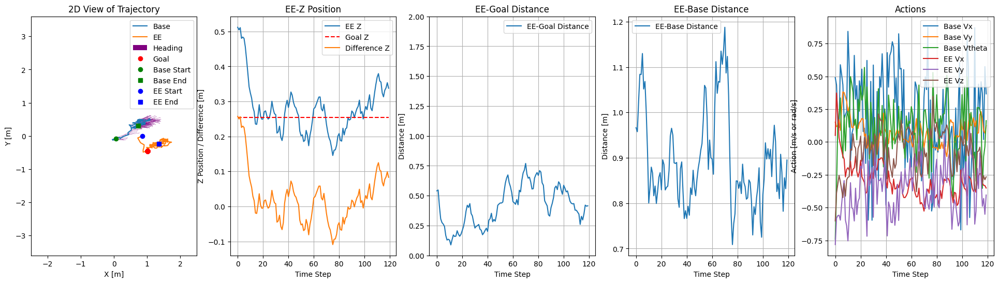

Trajectory 13


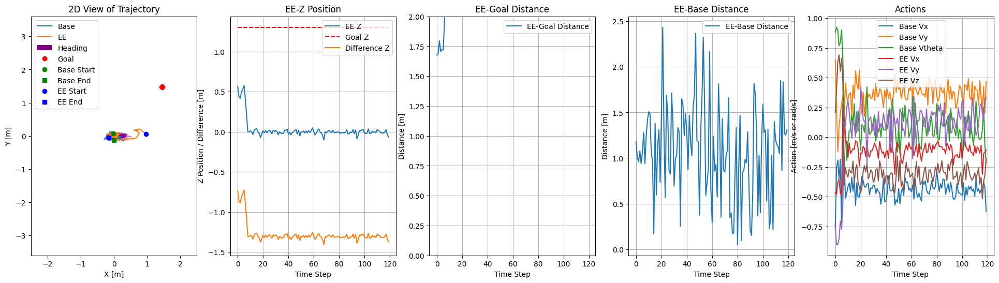

Trajectory 14


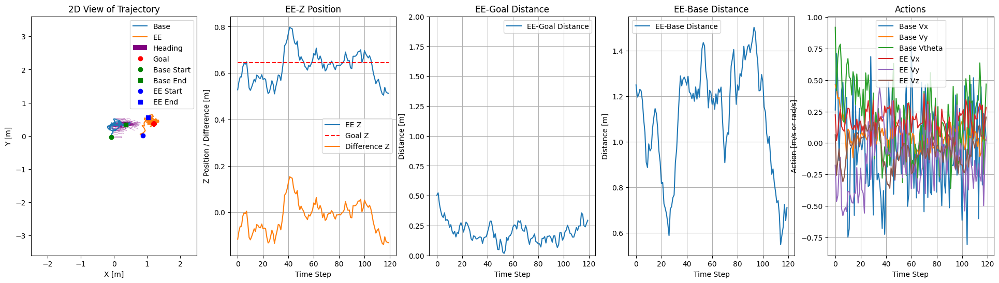

Trajectory 15


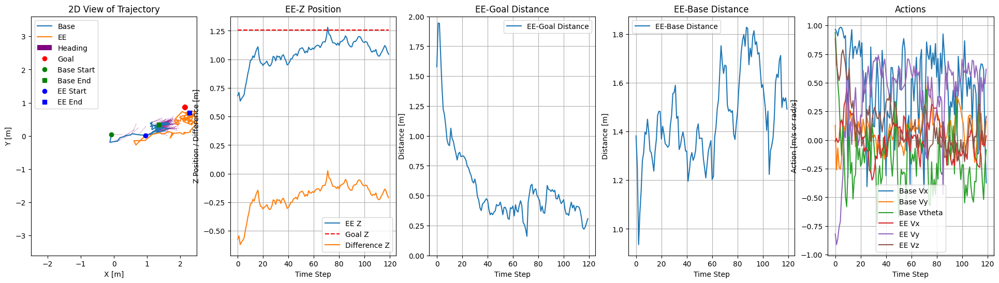

Trajectory 16


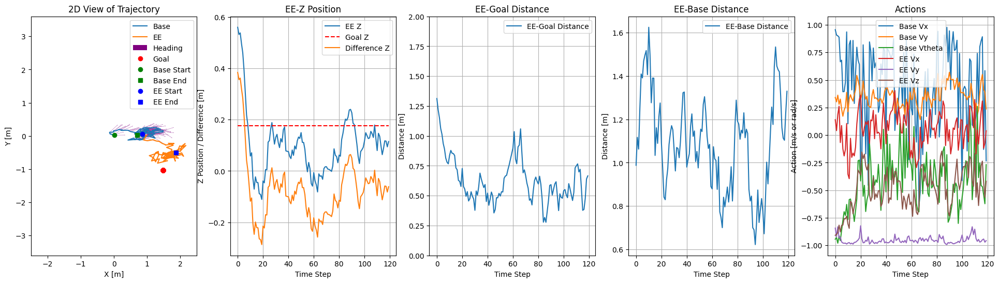

Trajectory 17


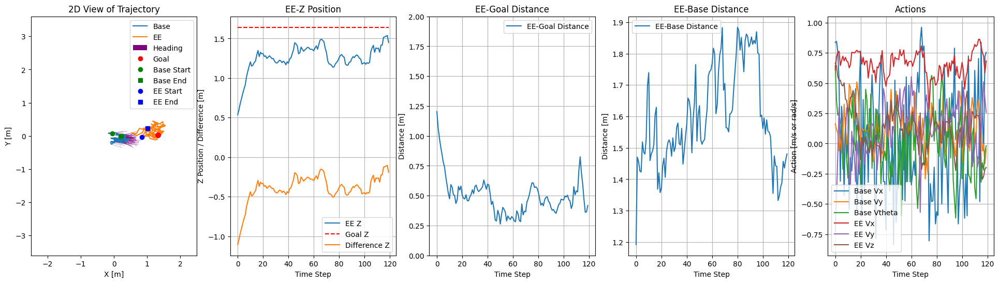

Trajectory 18


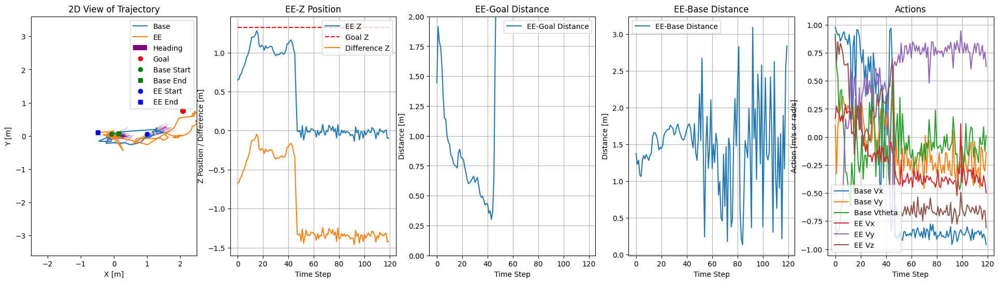

Trajectory 19


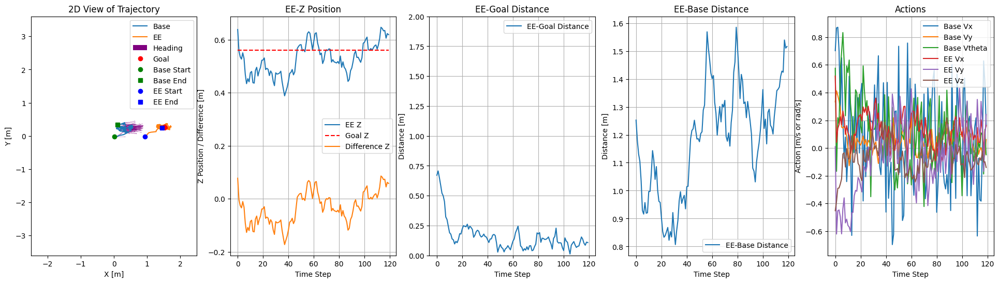

Trajectory 20


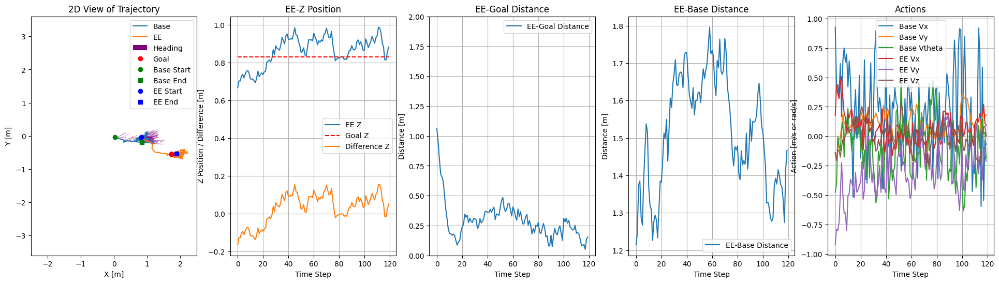

Trajectory 21


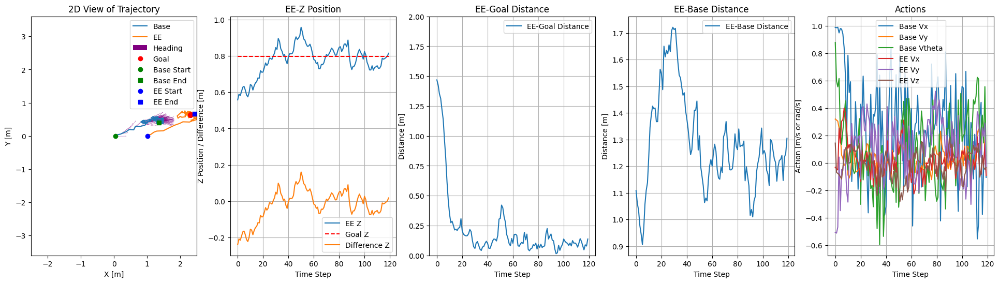

Trajectory 22


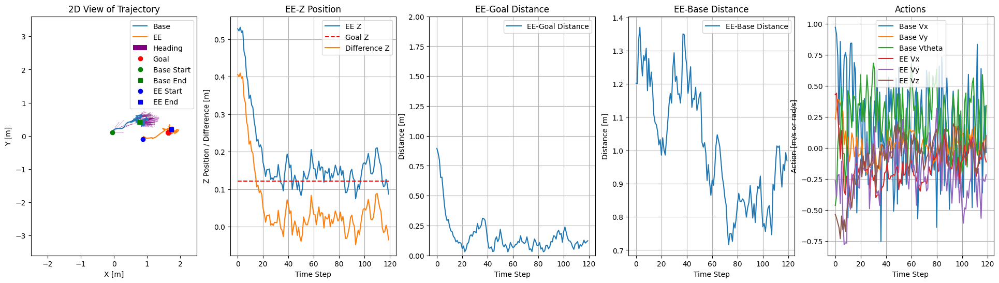

Trajectory 23


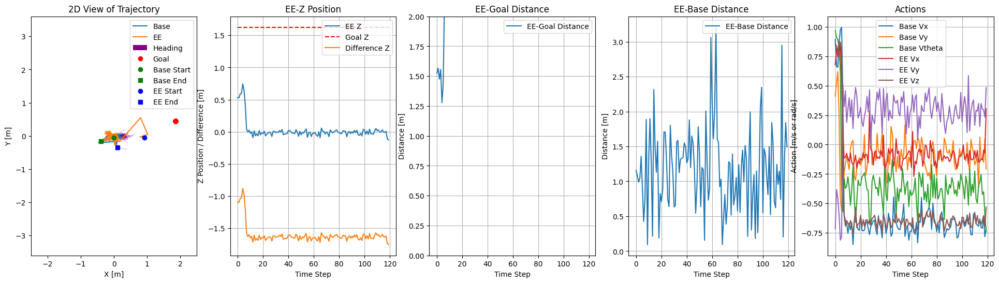

Trajectory 24


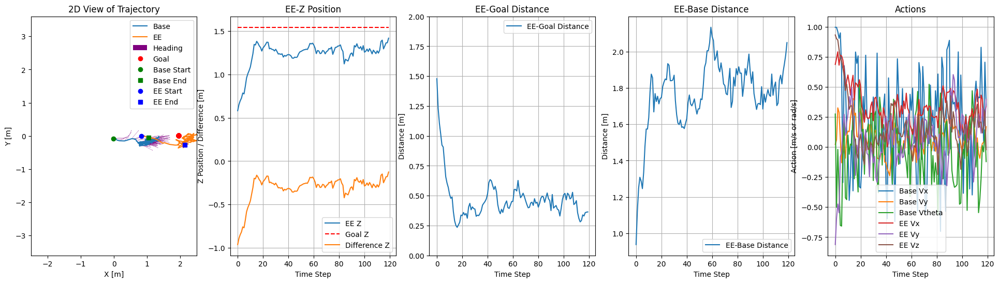

Trajectory 25


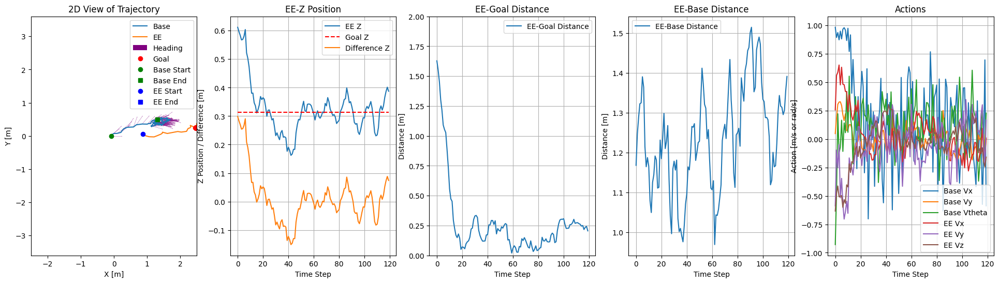

Trajectory 26


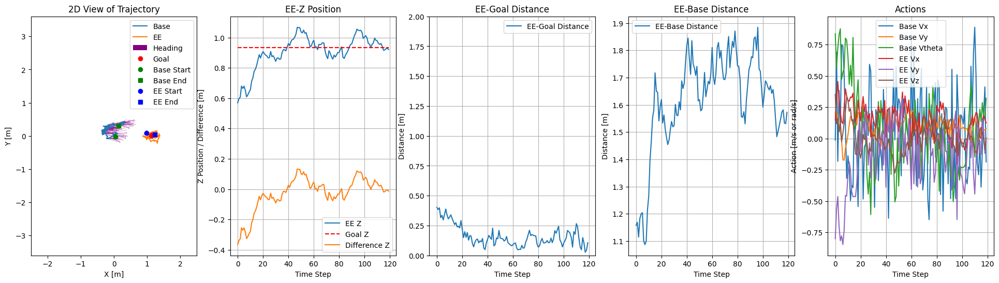

Trajectory 27


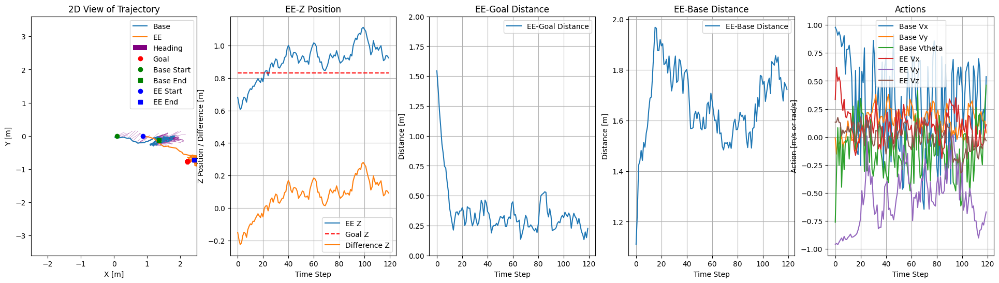

Trajectory 28


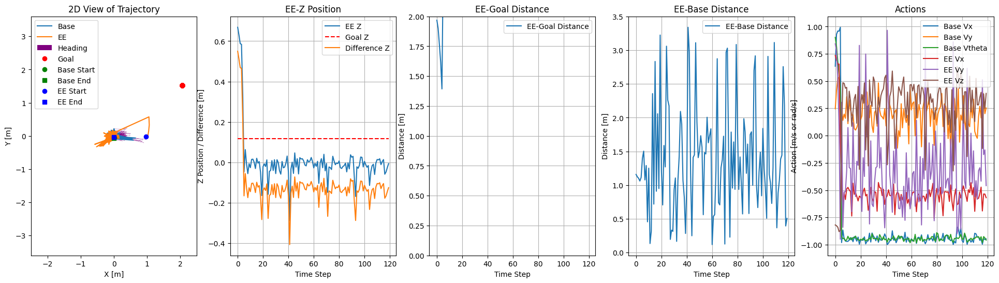

Trajectory 29


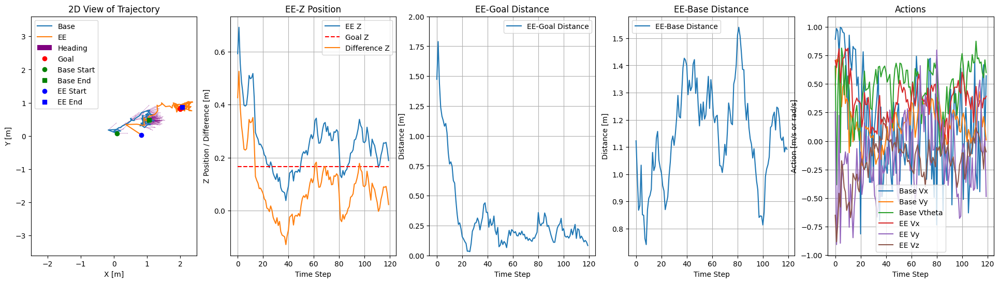

Trajectory 30


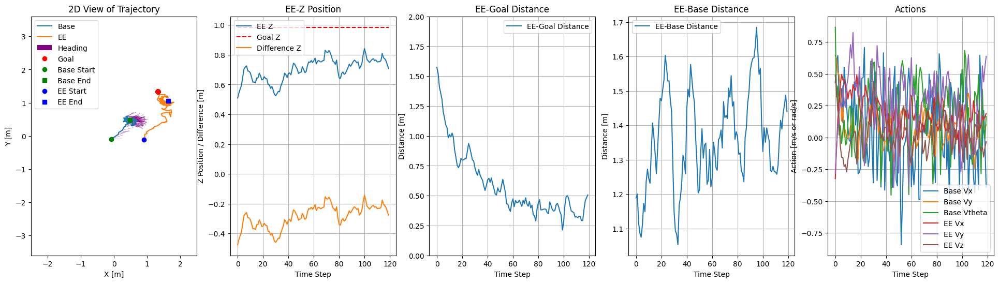

Trajectory 31


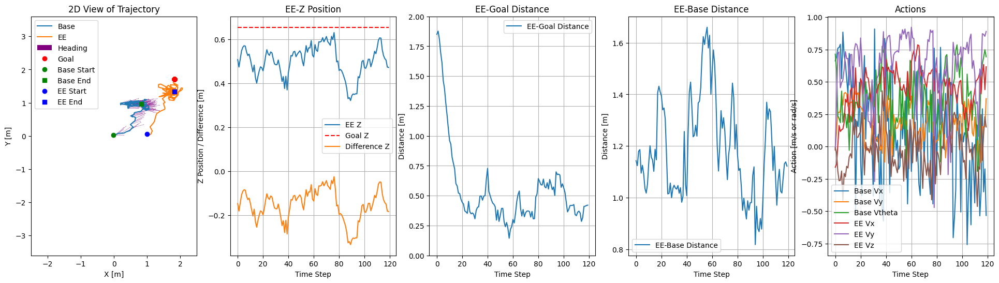

Trajectory 32


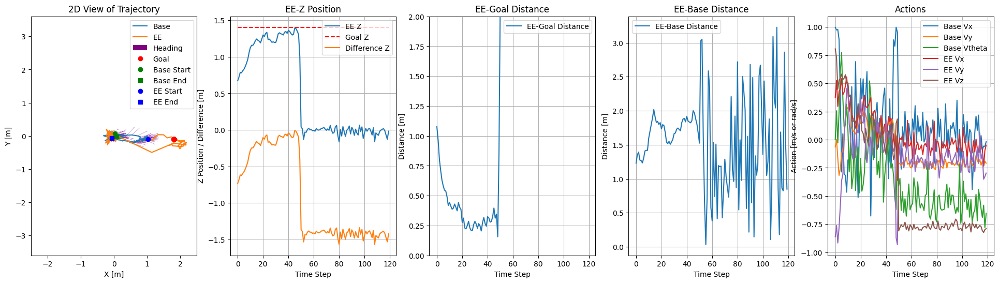

Trajectory 33


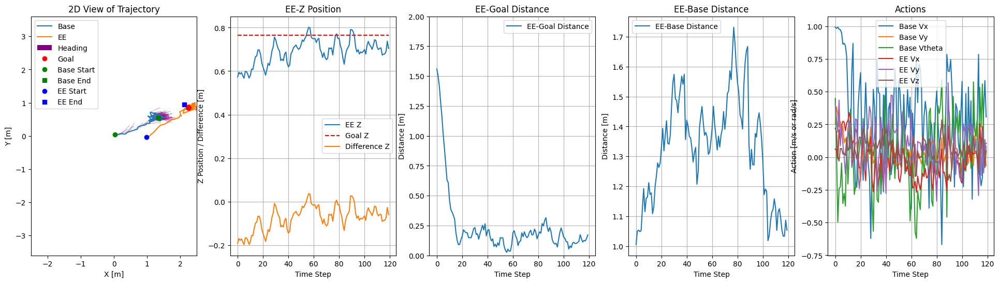

Trajectory 34


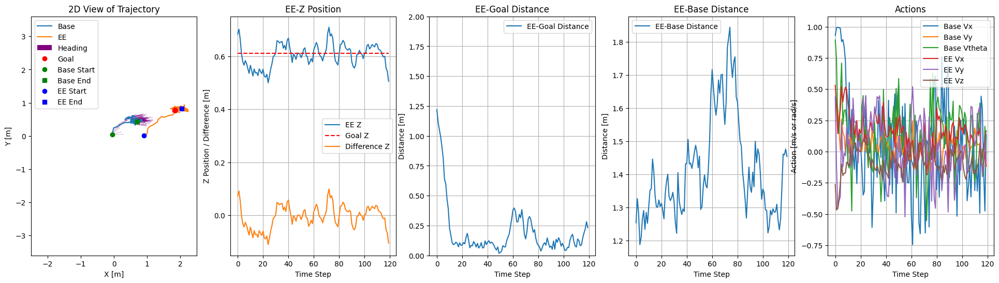

Trajectory 35


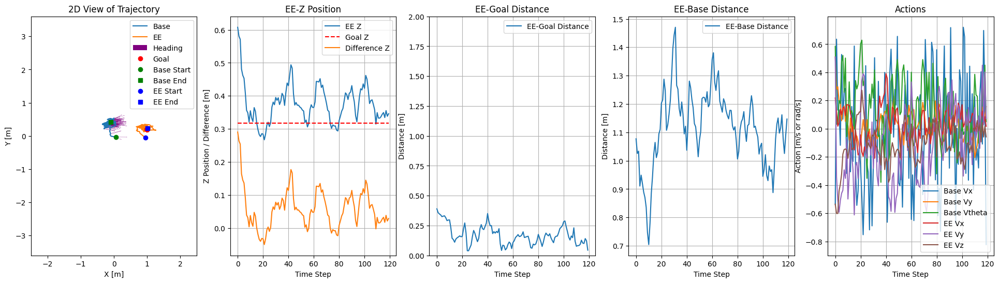

Trajectory 36


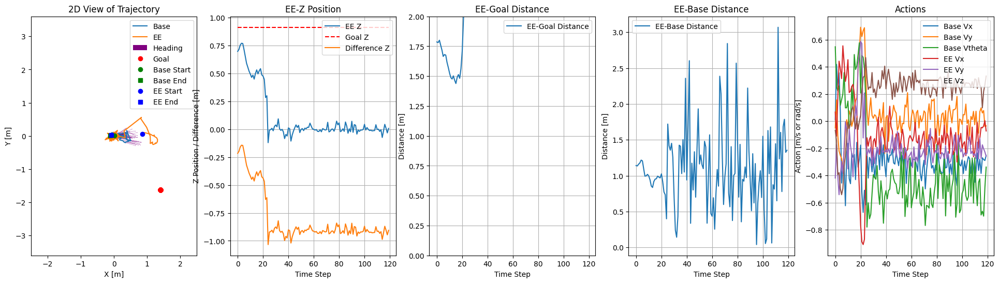

Trajectory 37


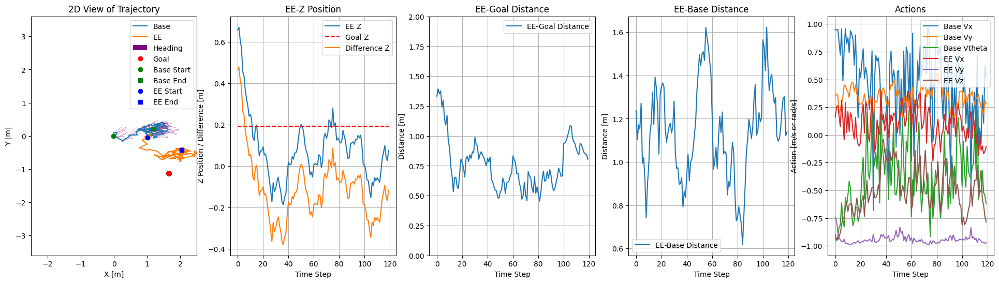

Trajectory 38


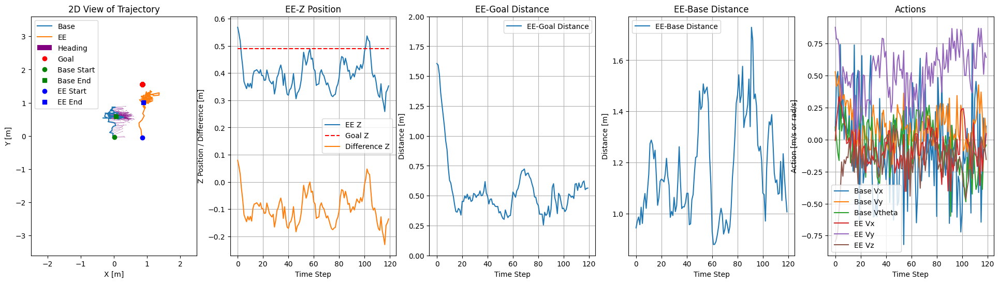

Trajectory 39


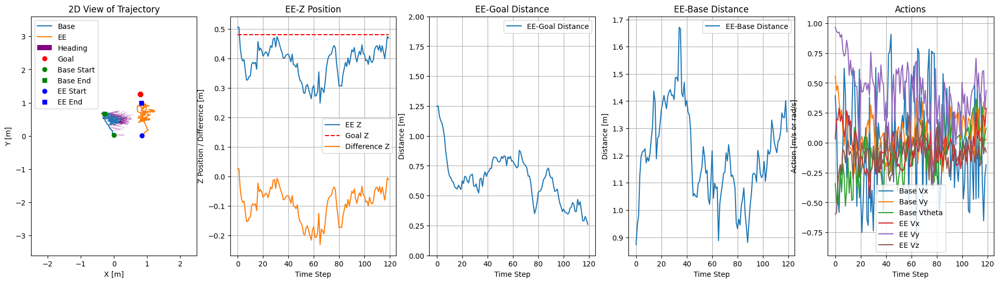

Trajectory 40


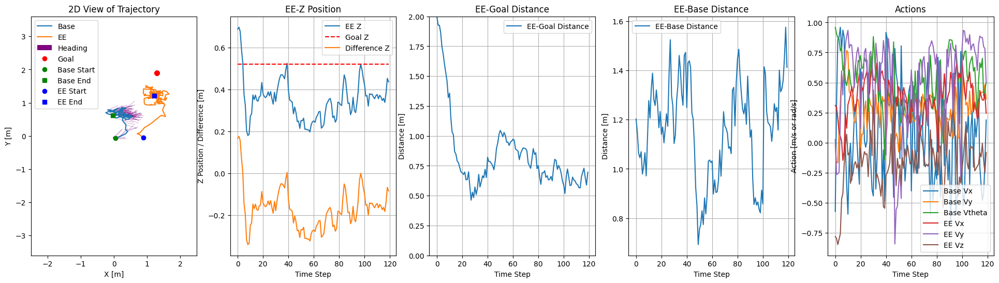

Trajectory 41


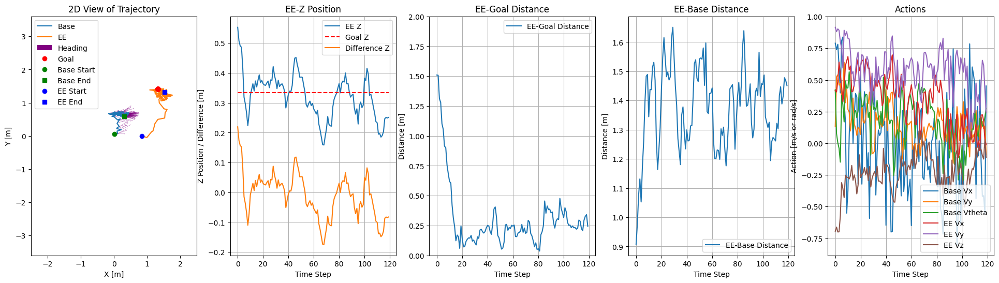

Trajectory 42


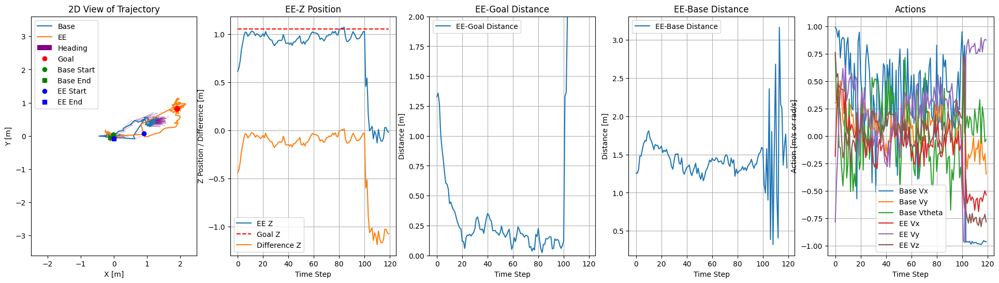

Trajectory 43


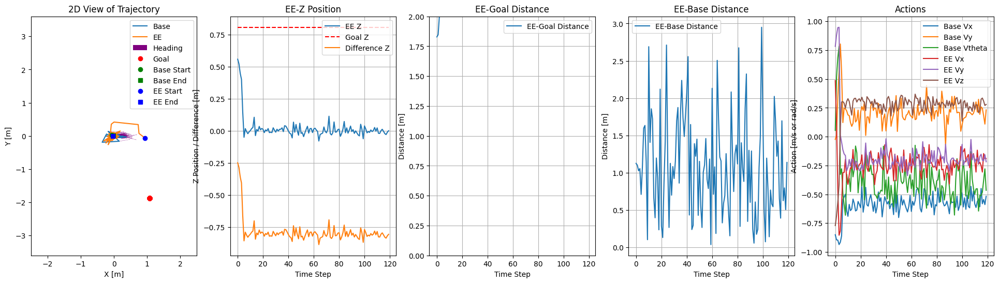

Trajectory 44


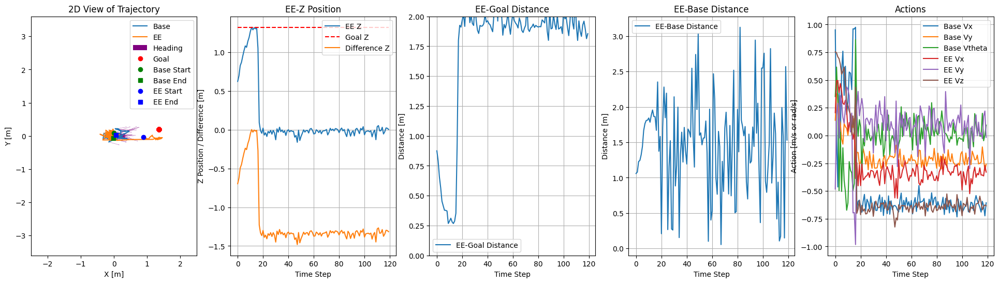

Trajectory 45


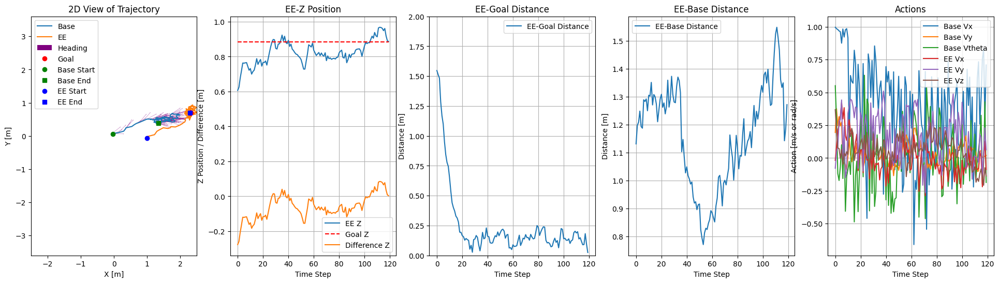

Trajectory 46


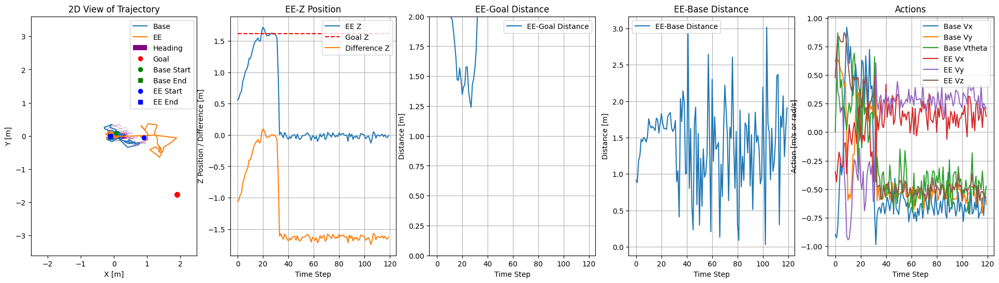

Trajectory 47


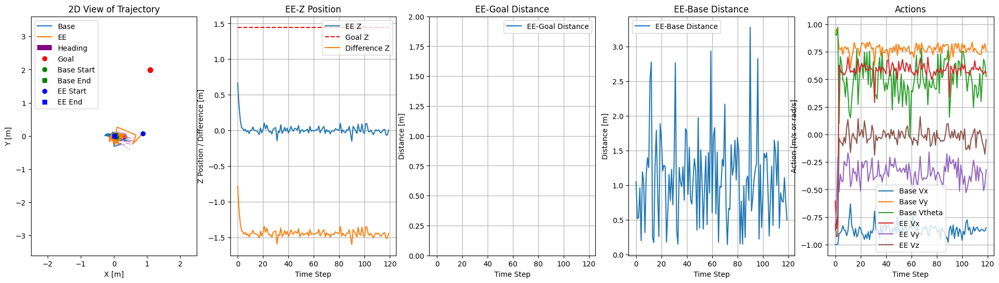

Trajectory 48


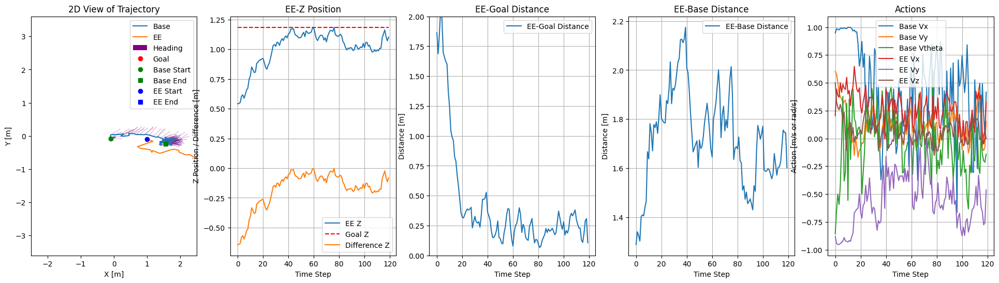

Trajectory 49


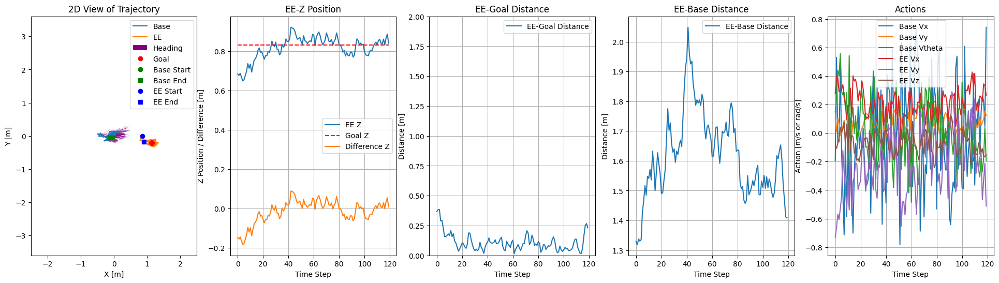

Trajectory 50


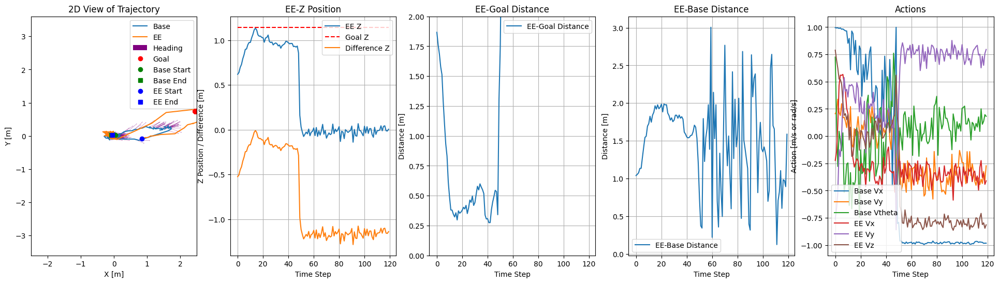

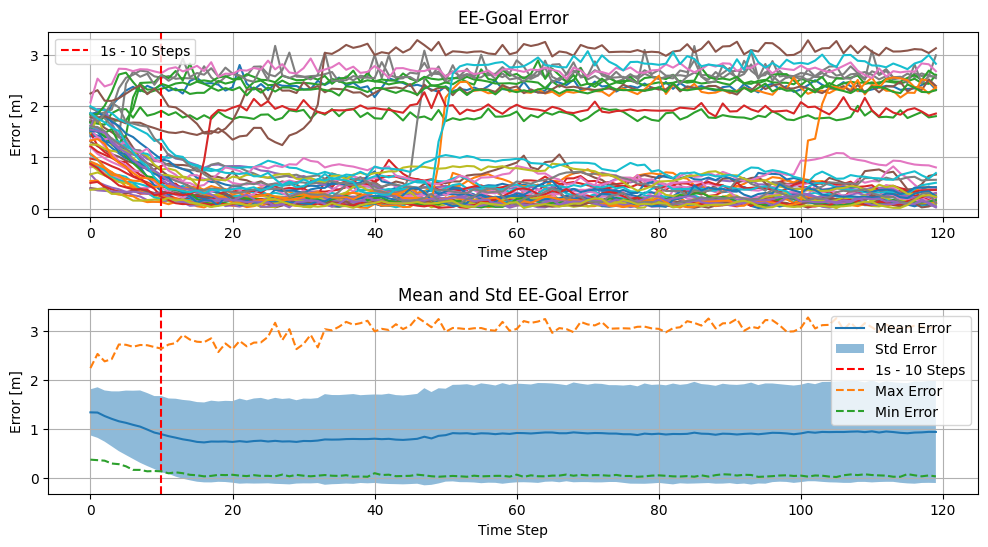

In [11]:
"""Evaluate trajectory created with policy in simulation"""

import pickle
import numpy as np
import matplotlib.pyplot as plt
from sim_transfer.sims.util import plot_spot_trajectory, decode_angles


# load trajectory from policy simulation
file_path = "/home/bhoffman/Documents/MT_FS24/simulation_transfer/results/policies_traj/6g4zyfpf/learned_model/trajectories_all.pkl"
with open(file_path, "rb") as file:
    traj = pickle.load(file)

# convert transitions to trajectory
observations = traj.observation
actions = traj.action
rewards = traj.reward
next_observations = traj.next_observation

# extract from observations
if observations.shape[-1] == 16:
    observations = decode_angles(observations, 2)
    next_observations = decode_angles(next_observations, 2)
base_pos = observations[:, :3]
ee_pos = observations[:, 6:9]
goal = observations[:, -3:]


def plot_goal_and_traj(traj_curr, actions_curr):
    fig, axs = plt.subplots(1, 5, figsize=(24, 6))
    ax1, ax2, ax3, ax4, ax5 = axs

    # 1. 2D View
    for idx, data in enumerate(traj_curr):
        u = np.cos(data[:, 3])
        v = np.sin(data[:, 3])
        if idx == 0:
            ax1.plot(data[:, 0], data[:, 1], label="Base")
            ax1.plot(data[:, 6], data[:, 7], label="EE")
            ax1.quiver(
                data[:, 0],
                data[:, 1],
                u,
                v,
                angles="xy",
                scale_units="xy",
                scale=3,
                width=0.001,
                color="purple",
                label="Heading",
            )
            ax1.plot(data[:, -3], data[:, -2], "ro", label="Goal")
            ax1.plot(data[0, 0], data[0, 1], "go", marker="o", label="Base Start")
            ax1.plot(data[-1, 0], data[-1, 1], "gs", marker="s", label="Base End")
            ax1.plot(data[0, 6], data[0, 7], "bo", marker="o", label="EE Start")
            ax1.plot(data[-1, 6], data[-1, 7], "bs", marker="s", label="EE End")
        else:
            ax1.plot(data[:, 0], data[:, 1], label=f"Base" if idx == 0 else None)
            ax1.plot(data[:, 6], data[:, 7], label=f"EE" if idx == 0 else None)
            ax1.quiver(
                data[:, 0],
                data[:, 1],
                u,
                v,
                angles="xy",
                scale_units="xy",
                scale=3,
                width=0.001,
                color="purple",
            )
            ax1.plot(data[:, -3], data[:, -2], "ro")
            ax1.plot(data[0, 0], data[0, 1], "go", marker="o")
            ax1.plot(data[-1, 0], data[-1, 1], "gs", marker="s")
            ax1.plot(data[0, 6], data[0, 7], "bo", marker="o")
            ax1.plot(data[-1, 6], data[-1, 7], "bs", marker="s")
    ax1.set_title("2D View of Trajectory")
    ax1.legend()
    ax1.set_xlabel("X [m]")
    ax1.set_ylabel("Y [m]")
    ax1.axis("equal")
    ax1.set_xlim(-2.5, 2.5)
    ax1.set_ylim(-4.5, 4.5)

    # 2. Z Component Analysis
    for idx, data in enumerate(traj_curr):
        ee_z = data[:, 8]
        goal_z = data[0, -1]
        time_steps = np.arange(data.shape[0])
        label_ee_z = f"EE Z" if idx == 0 else None
        label_goal_z = f"Goal Z" if idx == 0 else None
        label_diff_z = f"Difference Z" if idx == 0 else None
        ax2.plot(time_steps, ee_z, label=label_ee_z)
        ax2.hlines(
            goal_z,
            time_steps[0],
            time_steps[-1],
            colors="r",
            linestyles="--",
            label=label_goal_z,
        )
        diff_z = ee_z - goal_z
        ax2.plot(time_steps, diff_z, label=label_diff_z)
    ax2.set_title("EE-Z Position")
    ax2.set_xlabel("Time Step")
    ax2.set_ylabel("Z Position / Difference [m]")
    ax2.legend()
    ax2.grid(True)

    # 3. EE-Goal Distance
    for idx, data in enumerate(traj_curr):
        ee_pos = data[:, 6:9]
        goal_pos = data[:, -3:]
        distance = np.linalg.norm(ee_pos - goal_pos, axis=1)
        time_steps = np.arange(data.shape[0])
        label_distance = f"EE-Goal Distance" if idx == 0 else None
        ax3.plot(time_steps, distance, label=label_distance)
    ax3.set_title("EE-Goal Distance")
    ax3.set_xlabel("Time Step")
    ax3.set_ylabel("Distance [m]")
    ax3.set_ylim(0, 2)
    ax3.legend()
    ax3.grid(True)

    # 4. EE-Base Distance
    for idx, data in enumerate(traj_curr):
        ee_pos = data[:, 6:9]
        base_pos = data[:, 0:3]
        distance = np.linalg.norm(ee_pos - base_pos, axis=1)
        time_steps = np.arange(data.shape[0])
        label_distance = f"EE-Base Distance" if idx == 0 else None
        ax4.plot(time_steps, distance, label=label_distance)
    ax4.set_title("EE-Base Distance")
    ax4.set_xlabel("Time Step")
    ax4.set_ylabel("Distance [m]")
    ax4.legend()
    ax4.grid(True)

    # 5. Actions
    for idx, data in enumerate(actions_curr):
        time_steps = np.arange(data.shape[0])
        ax5.plot(time_steps, data[:, 0], label="Base Vx" if idx == 0 else None)
        ax5.plot(time_steps, data[:, 1], label="Base Vy" if idx == 0 else None)
        ax5.plot(time_steps, data[:, 2], label="Base Vtheta" if idx == 0 else None)
        ax5.plot(time_steps, data[:, 3], label="EE Vx" if idx == 0 else None)
        ax5.plot(time_steps, data[:, 4], label="EE Vy" if idx == 0 else None)
        ax5.plot(time_steps, data[:, 5], label="EE Vz" if idx == 0 else None)
    ax5.set_title("Actions")
    ax5.set_xlabel("Time Step")
    ax5.set_ylabel("Action [m/s or rad/s]")
    ax5.legend()
    ax5.grid(True)

    plt.show()


def plot_ee_goal_error(trajs):
    # calculate error between EE and Goal
    ee_goal_error = []
    for traj in trajs:
        ee_pos = traj[:, 6:9]
        goal_pos = traj[:, -3:]
        error = np.linalg.norm(ee_pos - goal_pos, axis=1)
        ee_goal_error.append(error)
    ee_goal_error = np.array(ee_goal_error)

    # plot errors
    fig, ax = plt.subplots(2, 1, figsize=(12, 6))
    fig.subplots_adjust(hspace=0.5)

    # plot all errors
    for idx, error in enumerate(ee_goal_error):
        time_steps = np.arange(error.shape[0])
        ax[0].plot(time_steps, error)
    ax[0].axvline(10, color="r", linestyle="--", label="1s - 10 Steps")
    ax[0].set_title("EE-Goal Error")
    ax[0].set_xlabel("Time Step")
    ax[0].set_ylabel("Error [m]")
    ax[0].legend()
    ax[0].grid(True)

    # plot mean error and std
    mean_error = np.mean(ee_goal_error, axis=0)
    std_error = np.std(ee_goal_error, axis=0)
    time_steps = np.arange(mean_error.shape[0])
    ax[1].plot(time_steps, mean_error, label="Mean Error")
    ax[1].fill_between(
        time_steps,
        mean_error - std_error,
        mean_error + std_error,
        alpha=0.5,
        label="Std Error",
    )
    ax[1].axvline(10, color="r", linestyle="--", label="1s - 10 Steps")
    ax[1].set_title("Mean and Std EE-Goal Error")
    ax[1].set_xlabel("Time Step")
    ax[1].set_ylabel("Error [m]")
    ax[1].legend()
    ax[1].grid(True)

    # plot max and min error
    max_error = np.max(ee_goal_error, axis=0)
    min_error = np.min(ee_goal_error, axis=0)
    ax[1].plot(time_steps, max_error, linestyle="--", label="Max Error")
    ax[1].plot(time_steps, min_error, linestyle="--", label="Min Error")
    ax[1].legend()

    plt.show()


print(observations.shape, actions.shape)

for (
    id,
    obs,
) in enumerate(observations):
    print(f"Trajectory {id+1}")
    plot_goal_and_traj(observations[id : id + 1], actions[id : id + 1])

plot_ee_goal_error(observations)

(51, 16)
Decoding angles
Trajectory 1


/tmp/ipykernel_3895707/4037269592.py:70: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "go" (-> marker='o'). The keyword argument will take precedence.
  ax1.plot(data[0, 0], data[0, 1], 'go', marker='o', label="Base Start")
/tmp/ipykernel_3895707/4037269592.py:71: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "gs" (-> marker='s'). The keyword argument will take precedence.
  ax1.plot(data[-1, 0], data[-1, 1], 'gs', marker='s', label="Base End")
/tmp/ipykernel_3895707/4037269592.py:72: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "bo" (-> marker='o'). The keyword argument will take precedence.
  ax1.plot(data[0, 6], data[0, 7], 'bo', marker='o', label="EE Start")
/tmp/ipykernel_3895707/4037269592.py:73: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "bs" (-> marker='s'). The keyword argument w

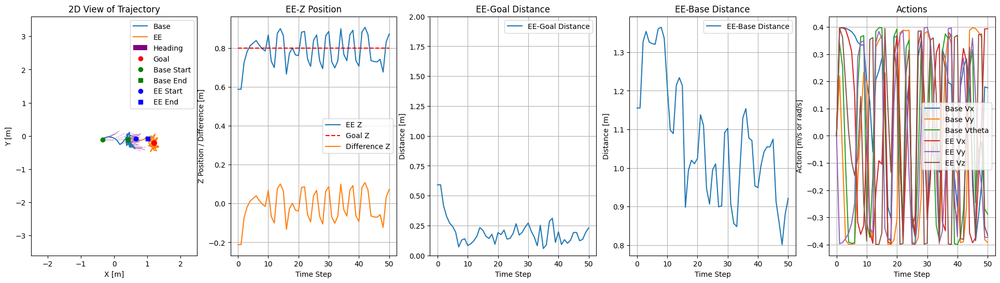

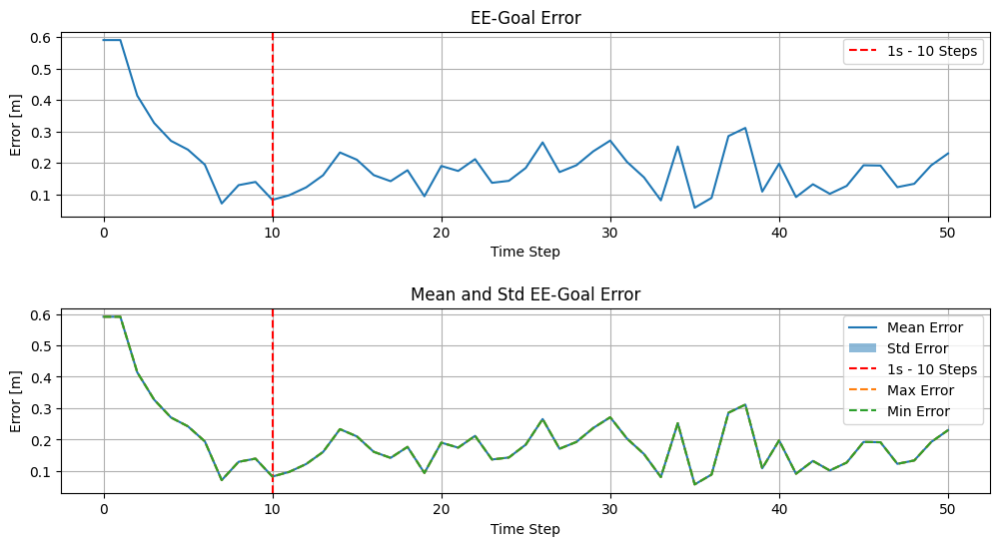

In [5]:
"""Evaluate trajectory created with policy on real robot"""

import pickle
import numpy as np
import matplotlib.pyplot as plt
from sim_transfer.sims.util import plot_spot_trajectory, decode_angles
from brax.training.types import Transition
import jax.tree_util as jtu
import jax.numpy as jnp


# load trajectory from policy simulation
file_path = "/home/bhoffman/Documents/MT_FS24/simulation_transfer/results/demo_081024/sim_model_trajectory.pickle"
with open(file_path, "rb") as file:
    traj_raw = pickle.load(file)

# for each obs and next obs, add goal
goal = jnp.array([1.2, -0.2, 0.8])

# add goal to observations


def add_goal_to_obs(obs: jnp.ndarray, goal: jnp.ndarray) -> jnp.ndarray:
    return jnp.concatenate([obs, goal])


new_traj = []

# add goal
for i in range(len(traj_raw)):
    obs = traj_raw[i].observation
    next_obs = traj_raw[i].next_observation
    obs = add_goal_to_obs(obs, goal)
    next_obs = add_goal_to_obs(next_obs, goal)
    new_traj.append(
        Transition(
            observation=obs,
            action=traj_raw[i].action,
            reward=traj_raw[i].reward,
            next_observation=next_obs,
            discount=traj_raw[i].discount,
        )
    )


traj = jtu.tree_map(lambda *xs: jnp.stack(xs, axis=0), *new_traj)

# convert transitions to trajectory
observations = traj.observation
actions = traj.action
rewards = traj.reward
next_observations = traj.next_observation

print(observations.shape)

# extract from observations
if observations.shape[-1] == 16:
    print("Decoding angles")
    observations = decode_angles(observations, 2)
    next_observations = decode_angles(next_observations, 2)
base_pos = observations[:, :3]
ee_pos = observations[:, 6:9]
goal = observations[:, -3:]


def plot_goal_and_traj(traj_curr, actions_curr):
    fig, axs = plt.subplots(1, 5, figsize=(24, 6))
    ax1, ax2, ax3, ax4, ax5 = axs

    # 1. 2D View
    for idx, data in enumerate(traj_curr):
        u = np.cos(data[:, 3])
        v = np.sin(data[:, 3])
        if idx == 0:
            ax1.plot(data[:, 0], data[:, 1], label="Base")
            ax1.plot(data[:, 6], data[:, 7], label="EE")
            ax1.quiver(
                data[:, 0],
                data[:, 1],
                u,
                v,
                angles="xy",
                scale_units="xy",
                scale=3,
                width=0.001,
                color="purple",
                label="Heading",
            )
            ax1.plot(data[:, -3], data[:, -2], "ro", label="Goal")
            ax1.plot(data[0, 0], data[0, 1], "go", marker="o", label="Base Start")
            ax1.plot(data[-1, 0], data[-1, 1], "gs", marker="s", label="Base End")
            ax1.plot(data[0, 6], data[0, 7], "bo", marker="o", label="EE Start")
            ax1.plot(data[-1, 6], data[-1, 7], "bs", marker="s", label="EE End")
        else:
            ax1.plot(data[:, 0], data[:, 1], label=f"Base" if idx == 0 else None)
            ax1.plot(data[:, 6], data[:, 7], label=f"EE" if idx == 0 else None)
            ax1.quiver(
                data[:, 0],
                data[:, 1],
                u,
                v,
                angles="xy",
                scale_units="xy",
                scale=3,
                width=0.001,
                color="purple",
            )
            ax1.plot(data[:, -3], data[:, -2], "ro")
            ax1.plot(data[0, 0], data[0, 1], "go", marker="o")
            ax1.plot(data[-1, 0], data[-1, 1], "gs", marker="s")
            ax1.plot(data[0, 6], data[0, 7], "bo", marker="o")
            ax1.plot(data[-1, 6], data[-1, 7], "bs", marker="s")
    ax1.set_title("2D View of Trajectory")
    ax1.legend()
    ax1.set_xlabel("X [m]")
    ax1.set_ylabel("Y [m]")
    ax1.axis("equal")
    ax1.set_xlim(-2.5, 2.5)
    ax1.set_ylim(-4.5, 4.5)

    # 2. Z Component Analysis
    for idx, data in enumerate(traj_curr):
        ee_z = data[:, 8]
        goal_z = data[0, -1]
        time_steps = np.arange(data.shape[0])
        label_ee_z = f"EE Z" if idx == 0 else None
        label_goal_z = f"Goal Z" if idx == 0 else None
        label_diff_z = f"Difference Z" if idx == 0 else None
        ax2.plot(time_steps, ee_z, label=label_ee_z)
        ax2.hlines(
            goal_z,
            time_steps[0],
            time_steps[-1],
            colors="r",
            linestyles="--",
            label=label_goal_z,
        )
        diff_z = ee_z - goal_z
        ax2.plot(time_steps, diff_z, label=label_diff_z)
    ax2.set_title("EE-Z Position")
    ax2.set_xlabel("Time Step")
    ax2.set_ylabel("Z Position / Difference [m]")
    ax2.legend()
    ax2.grid(True)

    # 3. EE-Goal Distance
    for idx, data in enumerate(traj_curr):
        ee_pos = data[:, 6:9]
        goal_pos = data[:, -3:]
        distance = np.linalg.norm(ee_pos - goal_pos, axis=1)
        time_steps = np.arange(data.shape[0])
        label_distance = f"EE-Goal Distance" if idx == 0 else None
        ax3.plot(time_steps, distance, label=label_distance)
    ax3.set_title("EE-Goal Distance")
    ax3.set_xlabel("Time Step")
    ax3.set_ylabel("Distance [m]")
    ax3.set_ylim(0, 2)
    ax3.legend()
    ax3.grid(True)

    # 4. EE-Base Distance
    for idx, data in enumerate(traj_curr):
        ee_pos = data[:, 6:9]
        base_pos = data[:, 0:3]
        distance = np.linalg.norm(ee_pos - base_pos, axis=1)
        time_steps = np.arange(data.shape[0])
        label_distance = f"EE-Base Distance" if idx == 0 else None
        ax4.plot(time_steps, distance, label=label_distance)
    ax4.set_title("EE-Base Distance")
    ax4.set_xlabel("Time Step")
    ax4.set_ylabel("Distance [m]")
    ax4.legend()
    ax4.grid(True)

    # 5. Actions
    for idx, data in enumerate(actions_curr):
        time_steps = np.arange(data.shape[0])
        ax5.plot(time_steps, data[:, 0], label="Base Vx" if idx == 0 else None)
        ax5.plot(time_steps, data[:, 1], label="Base Vy" if idx == 0 else None)
        ax5.plot(time_steps, data[:, 2], label="Base Vtheta" if idx == 0 else None)
        ax5.plot(time_steps, data[:, 3], label="EE Vx" if idx == 0 else None)
        ax5.plot(time_steps, data[:, 4], label="EE Vy" if idx == 0 else None)
        ax5.plot(time_steps, data[:, 5], label="EE Vz" if idx == 0 else None)
    ax5.set_title("Actions")
    ax5.set_xlabel("Time Step")
    ax5.set_ylabel("Action [m/s or rad/s]")
    ax5.legend()
    ax5.grid(True)

    plt.show()


def plot_ee_goal_error(trajs):
    # calculate error between EE and Goal
    ee_goal_error = []
    for traj in trajs:
        ee_pos = traj[:, 6:9]
        goal_pos = traj[:, -3:]
        error = np.linalg.norm(ee_pos - goal_pos, axis=1)
        ee_goal_error.append(error)
    ee_goal_error = np.array(ee_goal_error)

    # plot errors
    fig, ax = plt.subplots(2, 1, figsize=(12, 6))
    fig.subplots_adjust(hspace=0.5)

    # plot all errors
    for idx, error in enumerate(ee_goal_error):
        time_steps = np.arange(error.shape[0])
        ax[0].plot(time_steps, error)
    ax[0].axvline(10, color="r", linestyle="--", label="1s - 10 Steps")
    ax[0].set_title("EE-Goal Error")
    ax[0].set_xlabel("Time Step")
    ax[0].set_ylabel("Error [m]")
    ax[0].legend()
    ax[0].grid(True)

    # plot mean error and std
    mean_error = np.mean(ee_goal_error, axis=0)
    std_error = np.std(ee_goal_error, axis=0)
    time_steps = np.arange(mean_error.shape[0])
    ax[1].plot(time_steps, mean_error, label="Mean Error")
    ax[1].fill_between(
        time_steps,
        mean_error - std_error,
        mean_error + std_error,
        alpha=0.5,
        label="Std Error",
    )
    ax[1].axvline(10, color="r", linestyle="--", label="1s - 10 Steps")
    ax[1].set_title("Mean and Std EE-Goal Error")
    ax[1].set_xlabel("Time Step")
    ax[1].set_ylabel("Error [m]")
    ax[1].legend()
    ax[1].grid(True)

    # plot max and min error
    max_error = np.max(ee_goal_error, axis=0)
    min_error = np.min(ee_goal_error, axis=0)
    ax[1].plot(time_steps, max_error, linestyle="--", label="Max Error")
    ax[1].plot(time_steps, min_error, linestyle="--", label="Min Error")
    ax[1].legend()

    plt.show()


# reshape from (51,16) to (1, 51, 16)
observations = np.expand_dims(observations, axis=0)
actions = np.expand_dims(actions, axis=0)


for (
    id,
    obs,
) in enumerate(observations):
    print(f"Trajectory {id+1}")
    plot_goal_and_traj(observations[id : id + 1], actions[id : id + 1])

plot_ee_goal_error(observations)

In [6]:
import ikpy.chain
import pickle
import numpy as np
import matplotlib.pyplot as plt
import ikpy.utils.plot as plot_utils

# Load trajectory from policy simulation
file_path = "/home/bhoffman/Documents/MT_FS24/simulation_transfer/results/policies_traj/6g4zyfpf/learned_model/trajectories_all.pkl"
with open(file_path, "rb") as file:
    traj = pickle.load(file)

# convert transitions to trajectory
observations = traj.observation
actions = traj.action
rewards = traj.reward
next_observations = traj.next_observation

# extract from observations
if observations.shape[-1] == 16:
    observations = decode_angles(observations, 2)
    next_observations = decode_angles(next_observations, 2)
base_pos = observations[:, :3]
ee_pos = observations[:, 6:9]
goal = observations[:, -3:]

data = observations


# Transform ee positions from world to body frame
def world_to_body_frame(base_pos, theta, ee_pos):
    cos_theta = np.cos(theta)
    sin_theta = np.sin(theta)
    ee_x_local = cos_theta * (ee_pos[0] - base_pos[0]) + sin_theta * (
        ee_pos[1] - base_pos[1]
    )
    ee_y_local = -sin_theta * (ee_pos[0] - base_pos[0]) + cos_theta * (
        ee_pos[1] - base_pos[1]
    )
    ee_z_local = ee_pos[2]
    ee_body = [ee_x_local, ee_y_local, ee_z_local]
    return ee_body


# Transform ee positions from body to world frame
def body_to_world_frame(base_pos, theta, ee_pos):
    cos_theta = np.cos(theta)
    sin_theta = np.sin(theta)
    ee_x_world = cos_theta * ee_pos[0] - sin_theta * ee_pos[1] + base_pos[0]
    ee_y_world = sin_theta * ee_pos[0] + cos_theta * ee_pos[1] + base_pos[1]
    ee_z_world = ee_pos[2]
    ee_world = [ee_x_world, ee_y_world, ee_z_world]
    return ee_world


# Get base and ee positions
base_positions = np.concatenate([data[:, 0:2], 0.445 * np.ones((len(data), 1))], axis=1)
base_theta = data[:, 2]
ee_positions_world = data[:, 6:9]
ee_positions_body = np.array(
    [
        world_to_body_frame(base_positions[i], base_theta[i], ee_positions_world[i])
        for i in range(len(data))
    ]
)
data_ee_transformed = np.concatenate(
    [base_positions, base_theta.reshape(-1, 1), ee_positions_body], axis=1
)

# Build inverse kinematics chain
ik_chain = ikpy.chain.Chain.from_urdf_file(
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/alrd/spot_gym/model/spot_urdf_model/spot_with_arm.urdf",
    base_elements=["base"],
    last_link_vector=[0.19557, 0, 0],
    active_links_mask=[
        True,
        True,
        True,
        True,
        True,
        False,
        False,
        False,
        False,
    ],
)

# Get joints and fk positions
ik_arm_joint_positions = [
    ik_chain.inverse_kinematics(ee_position_body)
    for ee_position_body in ee_positions_body
]
ee_fk_positions_body = np.array(
    [
        ik_chain.forward_kinematics(arm_joint_position)[:3, 3]
        for arm_joint_position in ik_arm_joint_positions
    ]
)
ee_fk_positions_world = np.array(
    [
        body_to_world_frame(base_positions[i], base_theta[i], ee_fk_positions_body[i])
        for i in range(len(data))
    ]
)

# Define labels
labels_state = [
    "base_x",
    "base_y",
    "base_theta",
    "base_vx",
    "base_vy",
    "base_vz",
    "ee_x",
    "ee_y",
    "ee_z",
    "ee_vx",
    "ee_vy",
    "ee_vz",
]
labels_pos = [
    "base_x",
    "base_y",
    "base_z",
    "base_theta",
    "ee_x_body",
    "ee_y_body",
    "ee_z_body",
]

# Plot all states
fig, axs = plt.subplots(12, 1, figsize=(10, 15))
for i in range(12):
    axs[i].plot(data[:, i], label=f"{labels_state[i]}")
    axs[i].set_title(labels_state[i])
    axs[i].legend()
    axs[i].set_xlabel("Timestep")
    if "x" in labels_state[i] or "y" in labels_state[i] or "z" in labels_state[i]:
        axs[i].set_ylabel("[m]")
fig.suptitle("All States", fontsize=16)
plt.show()

# Plot individual positions
fig, axs = plt.subplots(7, 1, figsize=(10, 10))
for i in range(7):
    axs[i].plot(data_ee_transformed[:, i], label=f"{labels_pos[i]}")
    if i > 3:
        axs[i].plot(ee_fk_positions_body[:, i - 4], label=f"{labels_pos[i]} fk")
    axs[i].set_title(labels_pos[i])
    axs[i].legend()
    axs[i].set_xlabel("Timestep")
    if "x" in labels_pos[i] or "y" in labels_pos[i] or "z" in labels_pos[i]:
        axs[i].set_ylabel("[m]")
fig.suptitle("Positions (Normal and FK)", fontsize=16)
plt.show()

# Plot 2D view
fig, axs = plt.subplots(1, 1, figsize=(10, 10))
u = np.cos(data[:, 3])
v = np.sin(data[:, 3])
axs.plot(data[:, 0], data[:, 1], label="Base")
axs.plot(data[:, 6], data[:, 7], label="EE")
axs.plot(ee_fk_positions_world[:, 0], ee_fk_positions_world[:, 1], label="EE fk")
axs.quiver(
    data[:, 0],
    data[:, 1],
    u,
    v,
    angles="xy",
    scale_units="xy",
    scale=3,
    width=0.001,
    color="purple",
    label="heading",
)
axs.plot(data[:, -3], data[:, -2], "ro", label="Goal")
axs.plot(data[0, 0], data[0, 1], "go", label="Base Start")
axs.plot(data[-1, 0], data[-1, 1], "gs", label="Base End")
axs.plot(data[0, 6], data[0, 7], "bo", label="EE start")
axs.plot(data[-1, 6], data[-1, 7], "bs", label="EE end")
axs.set_title("2D View")
axs.legend()
axs.set_xlabel("X [m]")
axs.set_ylabel("Y [m]")
axs.axis("equal")
axs.set_xlim(-2.5, 2.5)
axs.set_ylim(-4.5, 4.5)
fig.suptitle("2D View of Trajectory", fontsize=16)
plt.show()

# Plot the fk and normal ee positions
fig, axs = plt.subplots(3, 1, figsize=(10, 15))
ee_names = ["ee_x", "ee_y", "ee_z"]
for i in range(3):
    axs[i].plot(data_ee_transformed[:, 4 + i], label="EE")
    axs[i].plot(ee_fk_positions_body[:, i], label="EE ik")
    axs[i].set_title(ee_names[i])
    axs[i].legend()
    axs[i].set_xlabel("Timestep")
    axs[i].set_ylabel("[m]")
fig.suptitle("EE Positions (Normal and FK)", fontsize=16)
plt.show()

# Plot distance between ee and body
distance = np.linalg.norm(ee_positions_world - base_positions, axis=1)
fig, axs = plt.subplots(1, 1, figsize=(10, 5))
axs.plot(distance, label="distance")
axs.axhline(y=np.max(distance), color="r", linestyle="--")
axs.axhline(y=1.3, color="g", linestyle="--")
axs.set_xlabel("Timestep")
axs.set_ylabel("Distance [m]")
axs.legend()
fig.suptitle("Distance between EE and Body", fontsize=16)
plt.show()

Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150458_policy_testing_partial_v4_hck2b2u0_sim-model_800_3_0__0.8/brax_transitions.pickle
Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150610_policy_testing_partial_v4_chn3iu4r_sim-model_2000_3_0__0.8/brax_transitions.pickle
Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150732_policy_testing_partial_v4_yjgeqtmy_sim-model_5000_3_0__0.8/brax_transitions.pickle
Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150840_policy_testing_partial_v4_sq0k6akn_bnn-sim-fsvgd_800_3_0__0.8/brax_transitions.pickle
Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150940_policy_testing_partial_v4_k5kepn4q_bnn-sim-fsvgd_2000_3_0__0.8/brax_transitions.pickle
Decoding angle

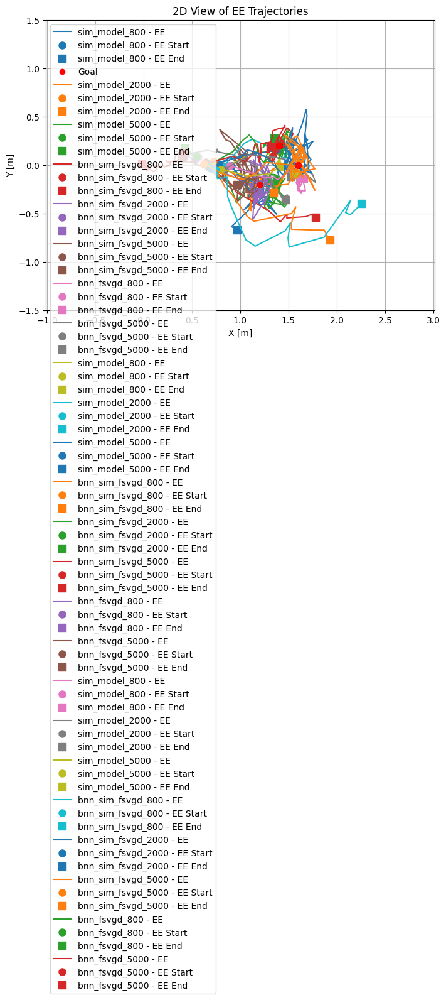

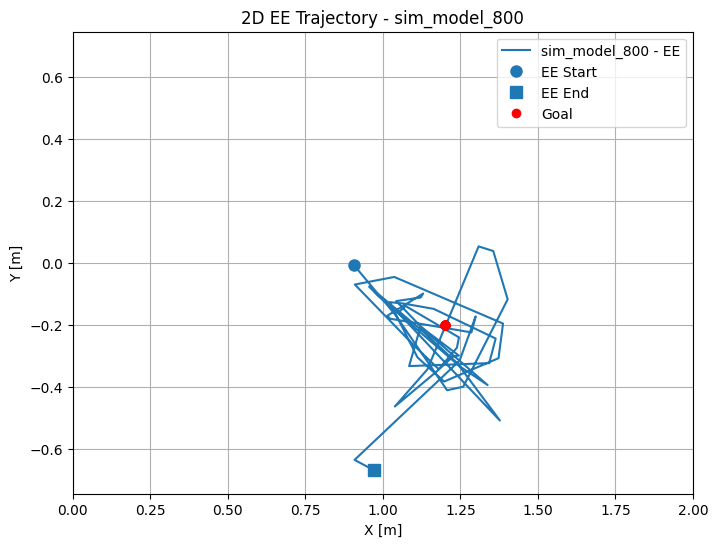

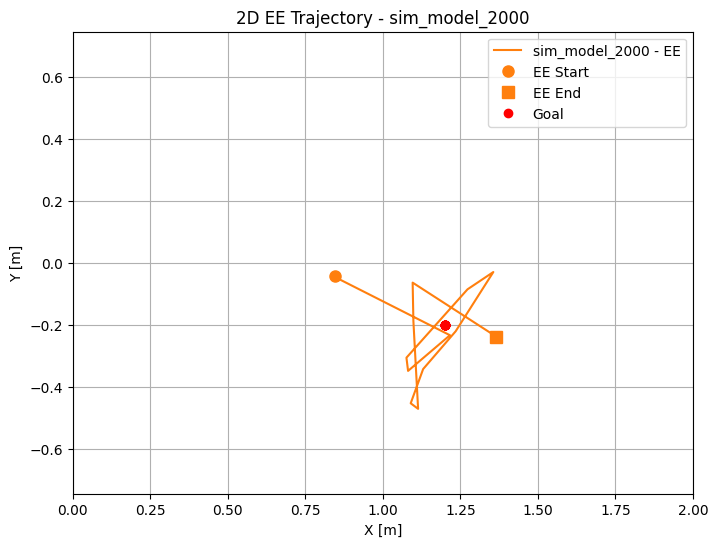

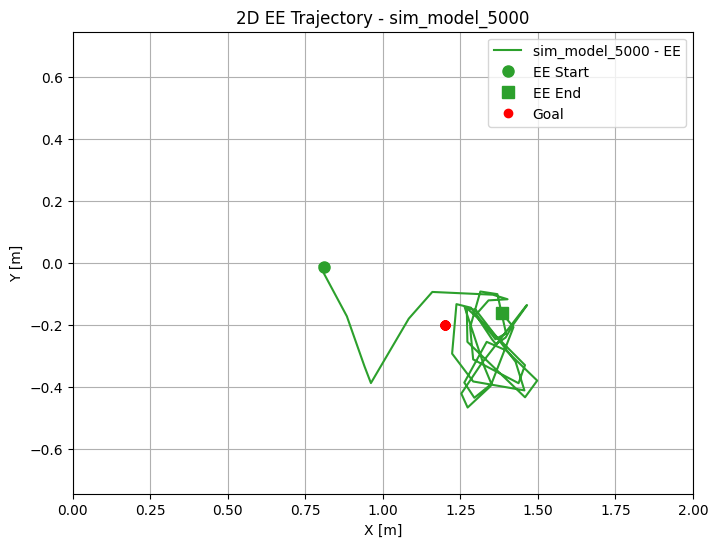

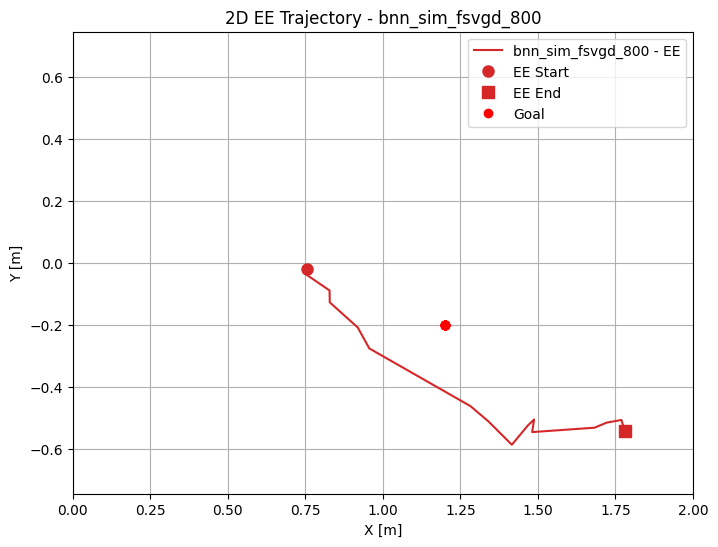

...

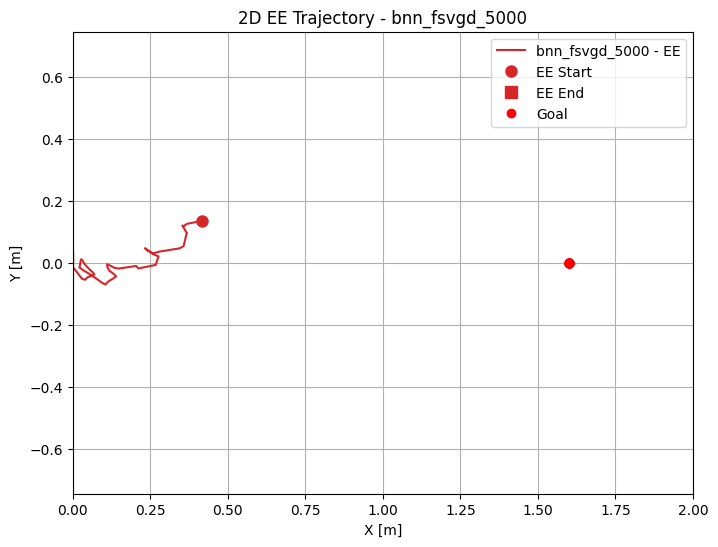

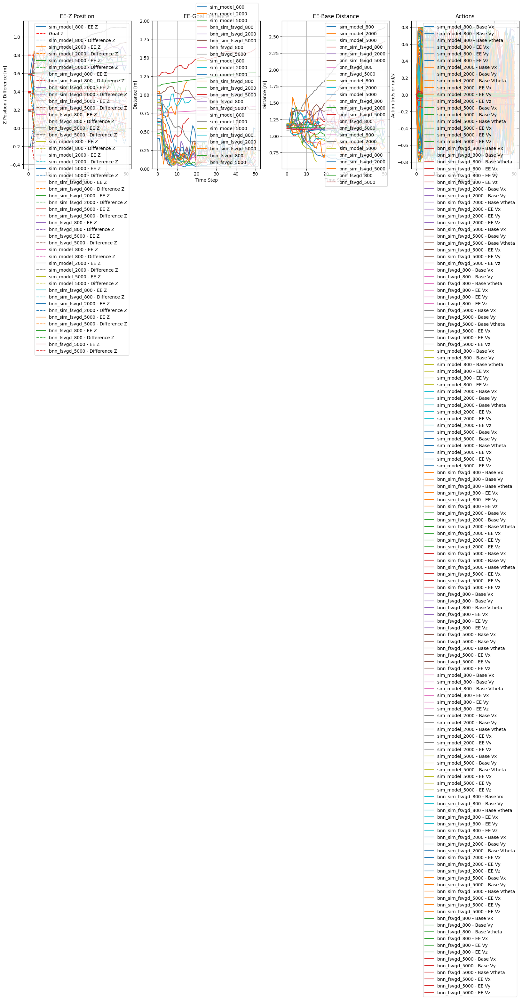

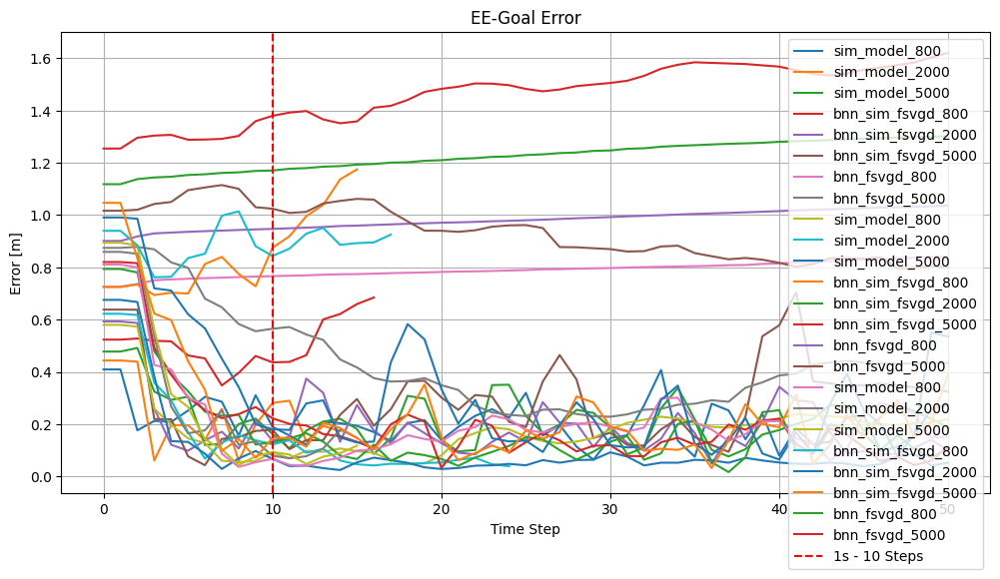

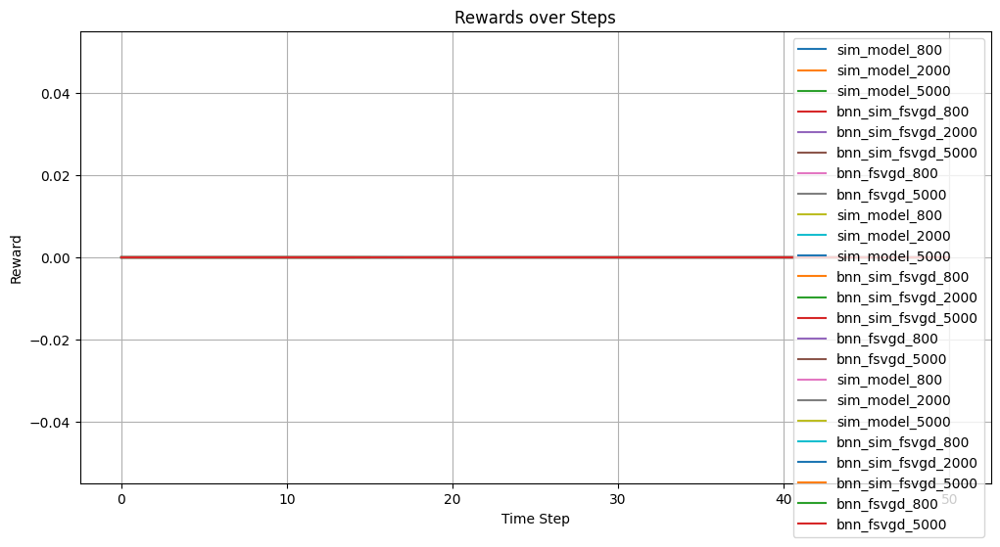

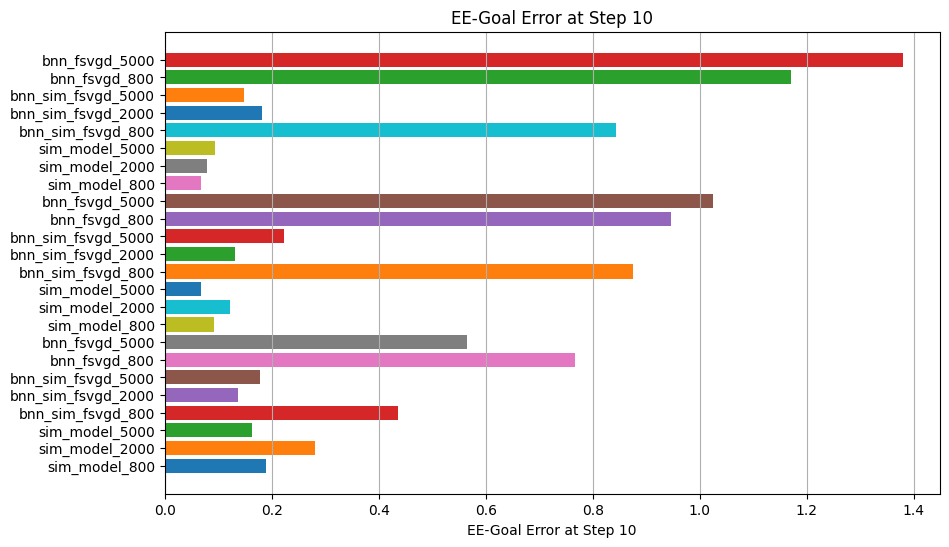

In [16]:
import pickle
import numpy as np
import matplotlib.pyplot as plt
from sim_transfer.sims.util import plot_spot_trajectory, decode_angles
from brax.training.types import Transition
import jax.tree_util as jtu
import jax.numpy as jnp
import re  # Import regular expressions module

# Define the list of trajectory files and their corresponding labels
file_paths = [
    # uses goal 0
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150458_policy_testing_partial_v4_hck2b2u0_sim-model_800_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150610_policy_testing_partial_v4_chn3iu4r_sim-model_2000_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150732_policy_testing_partial_v4_yjgeqtmy_sim-model_5000_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150840_policy_testing_partial_v4_sq0k6akn_bnn-sim-fsvgd_800_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150940_policy_testing_partial_v4_k5kepn4q_bnn-sim-fsvgd_2000_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151040_policy_testing_partial_v4_891g63gq_bnn-sim-fsvgd_5000_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151158_policy_testing_partial_v4_hjbw63y8_bnn-fsvgd_800_3_0__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151259_policy_testing_partial_v4_0dslu87b_bnn-fsvgd_2000_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151342_policy_testing_partial_v4_hq7f5yzu_bnn-fsvgd_5000_3_0__0.8/brax_transitions.pickle",
    
    # uses goal 1
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151922_policy_testing_partial_v4_hck2b2u0_sim-model_800_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152030_policy_testing_partial_v4_chn3iu4r_sim-model_2000_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152121_policy_testing_partial_v4_yjgeqtmy_sim-model_5000_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152233_policy_testing_partial_v4_sq0k6akn_bnn-sim-fsvgd_800_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152321_policy_testing_partial_v4_k5kepn4q_bnn-sim-fsvgd_2000_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152422_policy_testing_partial_v4_891g63gq_bnn-sim-fsvgd_5000_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152521_policy_testing_partial_v4_hjbw63y8_bnn-fsvgd_800_3_1__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152618_policy_testing_partial_v4_0dslu87b_bnn-fsvgd_2000_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152707_policy_testing_partial_v4_hq7f5yzu_bnn-fsvgd_5000_3_1__0.8/brax_transitions.pickle",

    # uses goal 2
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153401_policy_testing_partial_v4_hck2b2u0_sim-model_800_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153511_policy_testing_partial_v4_chn3iu4r_sim-model_2000_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153617_policy_testing_partial_v4_yjgeqtmy_sim-model_5000_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153718_policy_testing_partial_v4_sq0k6akn_bnn-sim-fsvgd_800_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153806_policy_testing_partial_v4_k5kepn4q_bnn-sim-fsvgd_2000_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153907_policy_testing_partial_v4_891g63gq_bnn-sim-fsvgd_5000_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-154010_policy_testing_partial_v4_hjbw63y8_bnn-fsvgd_800_3_2__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-154103_policy_testing_partial_v4_0dslu87b_bnn-fsvgd_2000_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-154148_policy_testing_partial_v4_hq7f5yzu_bnn-fsvgd_5000_3_2__0.8/brax_transitions.pickle",
]

labels = [
    # uses goal 0
    "sim_model_800",
    "sim_model_2000",
    "sim_model_5000",
    "bnn_sim_fsvgd_800",
    "bnn_sim_fsvgd_2000",
    "bnn_sim_fsvgd_5000",
    "bnn_fsvgd_800",
    # "bnn_fsvgd_2000",
    "bnn_fsvgd_5000",
    
    # uses goal 1
    "sim_model_800",
    "sim_model_2000",
    "sim_model_5000",
    "bnn_sim_fsvgd_800",
    "bnn_sim_fsvgd_2000",
    "bnn_sim_fsvgd_5000",
    "bnn_fsvgd_800",
    # "bnn_fsvgd_2000",
    "bnn_fsvgd_5000",

    # uses goal 2
    "sim_model_800",
    "sim_model_2000",
    "sim_model_5000",
    "bnn_sim_fsvgd_800",
    "bnn_sim_fsvgd_2000",
    "bnn_sim_fsvgd_5000",
    "bnn_fsvgd_800",
    # "bnn_fsvgd_2000",
    "bnn_fsvgd_5000",
]

goal_1 = jnp.array([1.2, -0.2, 0.8])
goal_2 = jnp.array([1.4, 0.2, 0.4])
goal_3 = jnp.array([1.6, 0.0, 0.2])

goals = [goal_1, goal_2, goal_3]

# Set global x and y limits for the 2D plots
x_limits = (0.0, 2)
y_limits = (-1.5, 1.5)

# Initialize lists to store observations, actions, rewards, and EE-Goal errors at step 10
all_observations = []
all_actions = []
all_rewards = []
ee_goal_errors_at_step = []

# Loop over each trajectory file
for idx, file_path in enumerate(file_paths):
    # Load trajectory from policy simulation
    with open(file_path, "rb") as file:
        traj_raw = pickle.load(file)

    # Extract goal index from file path
    match = re.search(r'_3_(\d+)__', file_path)
    if match:
        goal_index = int(match.group(1))
    else:
        # Default to 0 or raise an error
        goal_index = 0
    if goal_index >= len(goals):
        print(f"Goal index {goal_index} out of range for file {file_path}")
        goal_index = 0  # Handle as appropriate

    goal = goals[goal_index]

    # Add goal to observations
    def add_goal_to_obs(obs: jnp.ndarray, goal: jnp.ndarray) -> jnp.ndarray:
        return jnp.concatenate([obs, goal])

    new_traj = []

    # Add goal to each observation in the trajectory
    for i in range(len(traj_raw)):
        obs = traj_raw[i].observation
        next_obs = traj_raw[i].next_observation
        obs = add_goal_to_obs(obs, goal)
        next_obs = add_goal_to_obs(next_obs, goal)
        new_traj.append(
            Transition(
                observation=obs,
                action=traj_raw[i].action,
                reward=jnp.array(0),
                next_observation=next_obs,
                discount=traj_raw[i].discount,
            )
        )

    traj = jtu.tree_map(lambda *xs: jnp.stack(xs, axis=0), *new_traj)

    # Convert transitions to trajectory
    observations = traj.observation
    actions = traj.action
    rewards = traj.reward

    # Decode angles if needed
    if observations.shape[-1] == 16:
        print(f"Decoding angles for {file_path}")
        observations = decode_angles(observations, 2)

    # Append observations, actions, and rewards to the lists
    observations_np = np.array(observations)
    all_observations.append(observations_np)
    all_actions.append(np.array(actions))
    all_rewards.append(np.array(rewards))

    # Calculate EE-Goal error at step 10 for this trajectory
    ee_pos = observations_np[:, 6:9]
    goal_pos = observations_np[:, -3:]
    error = np.linalg.norm(ee_pos - goal_pos, axis=1)
    step_index = 10  # Index for step 10
    if len(error) > step_index:
        ee_goal_errors_at_step.append(error[step_index])
    else:
        # Handle case where trajectory is shorter than 11 steps
        ee_goal_errors_at_step.append(np.nan)  # Use NaN as a placeholder

# Plotting functions remain unchanged

def plot_ee_2d_view(traj_curr, labels, x_limits, y_limits):
    """Plot EE trajectories for all models in a single plot."""
    plt.figure(figsize=(8, 6))
    cmap = plt.get_cmap("tab10")  # Define colormap outside the loop
    for idx, data in enumerate(traj_curr):
        # Use the colormap to assign consistent colors
        color = cmap(idx % 10)

        # Plot end-effector trajectory
        plt.plot(data[:, 6], data[:, 7], label=f"{labels[idx]} - EE", color=color)

        # Plot EE start and end points
        plt.plot(
            data[0, 6],
            data[0, 7],
            "o",
            color=color,
            markersize=8,
            label=f"{labels[idx]} - EE Start",
        )
        plt.plot(
            data[-1, 6],
            data[-1, 7],
            "s",
            color=color,
            markersize=8,
            label=f"{labels[idx]} - EE End",
        )

        # Plot goal position
        plt.plot(data[:, -3], data[:, -2], "ro", label="Goal" if idx == 0 else None)

    plt.title("2D View of EE Trajectories")
    plt.xlabel("X [m]")
    plt.ylabel("Y [m]")
    plt.axis("equal")
    plt.xlim(x_limits)
    plt.ylim(y_limits)
    plt.legend()
    plt.grid(True)
    plt.show()


def plot_individual_ee_trajectories(traj_curr, labels, x_limits, y_limits):
    """Plot individual EE trajectories for each model."""
    cmap = plt.get_cmap("tab10")  # Define colormap outside the loop
    for idx, data in enumerate(traj_curr):
        plt.figure(figsize=(8, 6))
        # Use the colormap to assign consistent colors
        color = cmap(idx % 10)

        # Plot end-effector trajectory
        plt.plot(data[:, 6], data[:, 7], label=f"{labels[idx]} - EE", color=color)

        # Plot EE start and end points
        plt.plot(
            data[0, 6], data[0, 7], "o", color=color, markersize=8, label="EE Start"
        )
        plt.plot(
            data[-1, 6], data[-1, 7], "s", color=color, markersize=8, label="EE End"
        )

        # Plot goal position
        plt.plot(data[:, -3], data[:, -2], "ro", label="Goal")

        plt.title(f"2D EE Trajectory - {labels[idx]}")
        plt.xlabel("X [m]")
        plt.ylabel("Y [m]")
        plt.axis("equal")
        plt.xlim(x_limits)
        plt.ylim(y_limits)
        plt.legend()
        plt.grid(True)
        plt.show()


def plot_goal_and_traj(traj_curr, actions_curr, labels):
    # Adjusted subplots to exclude the 2D view
    fig, axs = plt.subplots(1, 4, figsize=(20, 6))
    ax2, ax3, ax4, ax5 = axs

    cmap = plt.get_cmap("tab10")  # Define colormap for consistency

    # 2. Z Component Analysis
    for idx, data in enumerate(traj_curr):
        color = cmap(idx % 10)
        ee_z = data[:, 8]
        goal_z = data[0, -1]
        time_steps = np.arange(data.shape[0])
        ax2.plot(time_steps, ee_z, label=f"{labels[idx]} - EE Z", color=color)
        ax2.hlines(
            goal_z,
            time_steps[0],
            time_steps[-1],
            colors="r",
            linestyles="--",
            label="Goal Z" if idx == 0 else None,
        )
        diff_z = ee_z - goal_z
        ax2.plot(
            time_steps,
            diff_z,
            linestyle="--",
            label=f"{labels[idx]} - Difference Z",
            color=color,
        )
    ax2.set_title("EE-Z Position")
    ax2.set_xlabel("Time Step")
    ax2.set_ylabel("Z Position / Difference [m]")
    ax2.legend()
    ax2.grid(True)

    # 3. EE-Goal Distance
    for idx, data in enumerate(traj_curr):
        color = cmap(idx % 10)
        ee_pos = data[:, 6:9]
        goal_pos = data[:, -3:]
        distance = np.linalg.norm(ee_pos - goal_pos, axis=1)
        time_steps = np.arange(data.shape[0])
        ax3.plot(time_steps, distance, label=f"{labels[idx]}", color=color)
    ax3.set_title("EE-Goal Distance")
    ax3.set_xlabel("Time Step")
    ax3.set_ylabel("Distance [m]")
    ax3.set_ylim(0, 2)
    ax3.legend()
    ax3.grid(True)

    # 4. EE-Base Distance
    for idx, data in enumerate(traj_curr):
        color = cmap(idx % 10)
        ee_pos = data[:, 6:9]
        base_pos = data[:, 0:3]
        distance = np.linalg.norm(ee_pos - base_pos, axis=1)
        time_steps = np.arange(data.shape[0])
        ax4.plot(time_steps, distance, label=f"{labels[idx]}", color=color)
    ax4.set_title("EE-Base Distance")
    ax4.set_xlabel("Time Step")
    ax4.set_ylabel("Distance [m]")
    ax4.legend()
    ax4.grid(True)

    # 5. Actions
    for idx, data in enumerate(actions_curr):
        color = cmap(idx % 10)
        time_steps = np.arange(data.shape[0])
        ax5.plot(time_steps, data[:, 0], label=f"{labels[idx]} - Base Vx", color=color)
        ax5.plot(time_steps, data[:, 1], label=f"{labels[idx]} - Base Vy", color=color)
        ax5.plot(
            time_steps, data[:, 2], label=f"{labels[idx]} - Base Vtheta", color=color
        )
        ax5.plot(time_steps, data[:, 3], label=f"{labels[idx]} - EE Vx", color=color)
        ax5.plot(time_steps, data[:, 4], label=f"{labels[idx]} - EE Vy", color=color)
        ax5.plot(time_steps, data[:, 5], label=f"{labels[idx]} - EE Vz", color=color)
    ax5.set_title("Actions")
    ax5.set_xlabel("Time Step")
    ax5.set_ylabel("Action [m/s or rad/s]")
    ax5.legend()
    ax5.grid(True)

    plt.show()


def plot_ee_goal_error(trajs, labels):
    # Calculate error between EE and Goal
    ee_goal_error = []
    for traj in trajs:
        ee_pos = traj[:, 6:9]
        goal_pos = traj[:, -3:]
        error = np.linalg.norm(ee_pos - goal_pos, axis=1)
        ee_goal_error.append(error)
    # ee_goal_error = np.array(ee_goal_error)

    # Plot errors
    plt.figure(figsize=(12, 6))
    cmap = plt.get_cmap("tab10")

    # Plot all errors
    for idx, error in enumerate(ee_goal_error):
        color = cmap(idx % 10)
        time_steps = np.arange(error.shape[0])
        plt.plot(time_steps, error, label=f"{labels[idx]}", color=color)
    plt.axvline(10, color="r", linestyle="--", label="1s - 10 Steps")
    plt.title("EE-Goal Error")
    plt.xlabel("Time Step")
    plt.ylabel("Error [m]")
    plt.legend()
    plt.grid(True)
    plt.show()


def plot_rewards(all_rewards, labels):
    plt.figure(figsize=(12, 6))
    cmap = plt.get_cmap("tab10")
    for idx, rewards in enumerate(all_rewards):
        color = cmap(idx % 10)
        time_steps = np.arange(len(rewards))
        plt.plot(time_steps, rewards, label=f"{labels[idx]}", color=color)
    plt.title("Rewards over Steps")
    plt.xlabel("Time Step")
    plt.ylabel("Reward")
    plt.legend()
    plt.grid(True)
    plt.show()


def plot_ee_goal_error_at_step(errors, labels, step_index):
    """Plot a horizontal bar plot of EE-Goal errors at a specific step."""
    plt.figure(figsize=(10, 6))
    y_positions = np.arange(len(labels))
    cmap = plt.get_cmap("tab10")
    colors = [
        cmap(idx % 10) for idx in range(len(labels))
    ]  # Assign colors consistently

    plt.barh(y_positions, errors, align="center", color=colors)
    plt.yticks(y_positions, labels)
    plt.xlabel(f"EE-Goal Error at Step {step_index}")
    plt.title(f"EE-Goal Error at Step {step_index}")
    plt.grid(True, axis="x")
    plt.show()

# Plot the standalone 2D EE trajectory view with new x and y limits
plot_ee_2d_view(all_observations, labels, x_limits, y_limits)

# Plot individual 2D EE trajectories for each model with new x and y limits
plot_individual_ee_trajectories(all_observations, labels, x_limits, y_limits)

# Plot the other subplots without the 2D view
plot_goal_and_traj(all_observations, all_actions, labels)

# Plot EE-Goal Error without mean/std plot
plot_ee_goal_error(all_observations, labels)

# Plot rewards over steps
plot_rewards(all_rewards, labels)

# Plot EE-Goal Error at Step 10 using a horizontal bar plot with consistent colors
plot_ee_goal_error_at_step(ee_goal_errors_at_step, labels, step_index=10)


Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150458_policy_testing_partial_v4_hck2b2u0_sim-model_800_3_0__0.8/brax_transitions.pickle
Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150610_policy_testing_partial_v4_chn3iu4r_sim-model_2000_3_0__0.8/brax_transitions.pickle
Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150732_policy_testing_partial_v4_yjgeqtmy_sim-model_5000_3_0__0.8/brax_transitions.pickle
Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150840_policy_testing_partial_v4_sq0k6akn_bnn-sim-fsvgd_800_3_0__0.8/brax_transitions.pickle
Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150940_policy_testing_partial_v4_k5kepn4q_bnn-sim-fsvgd_2000_3_0__0.8/brax_transitions.pickle
Decoding angle

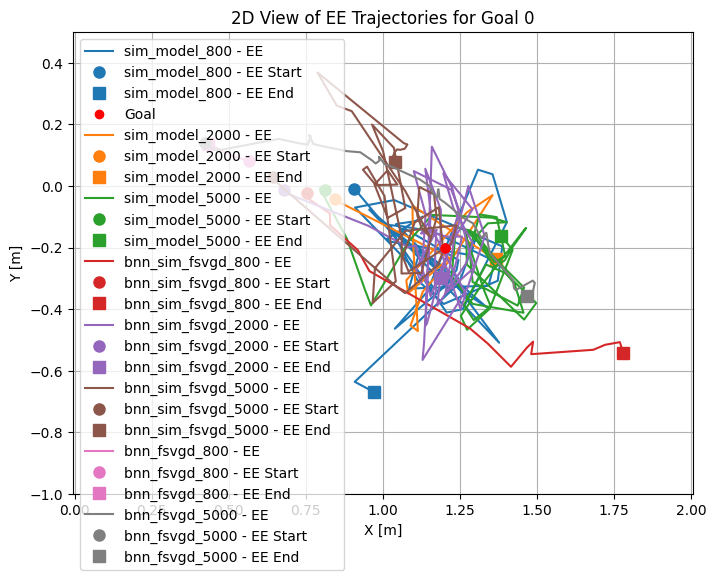

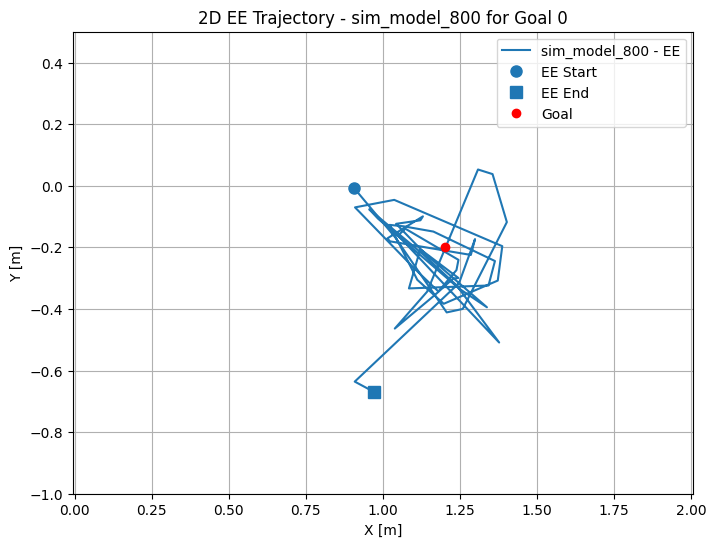

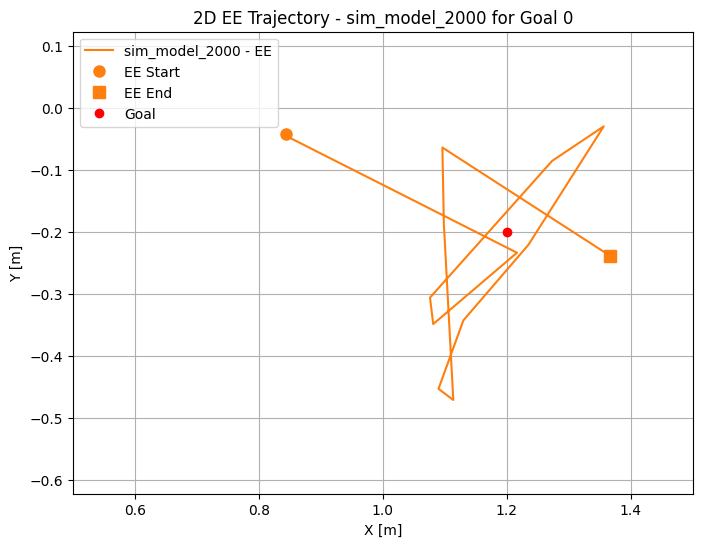

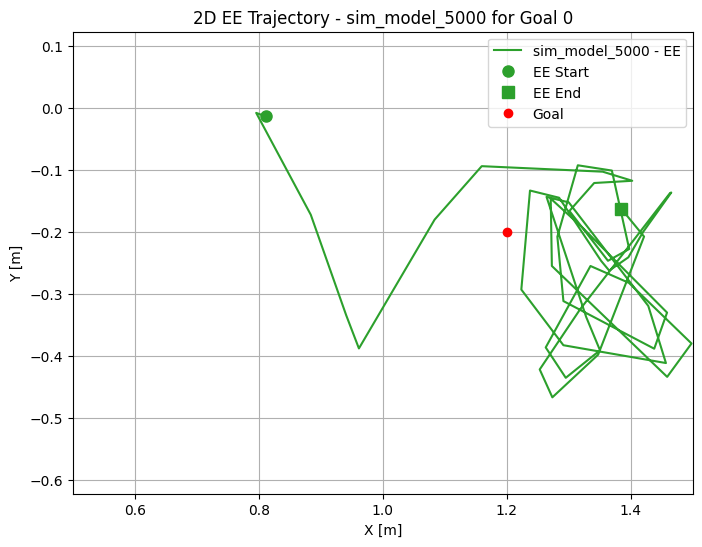

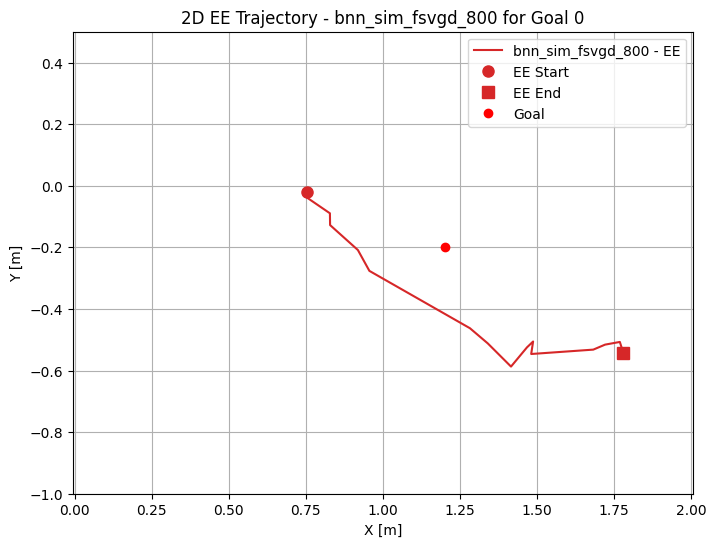

...

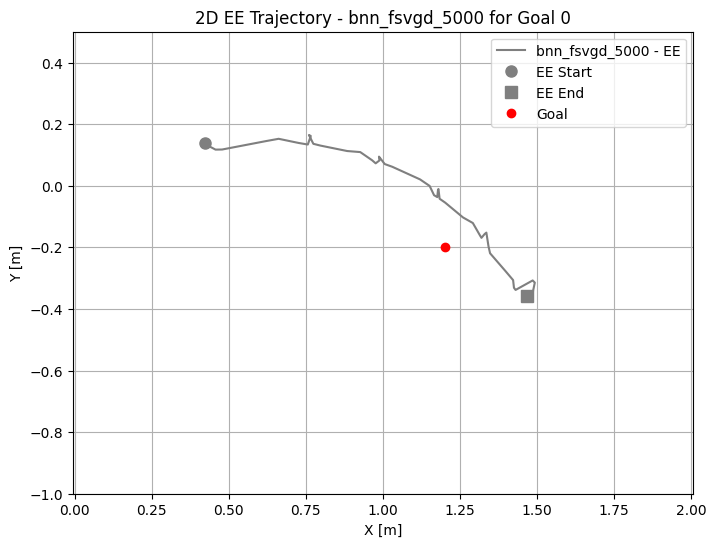

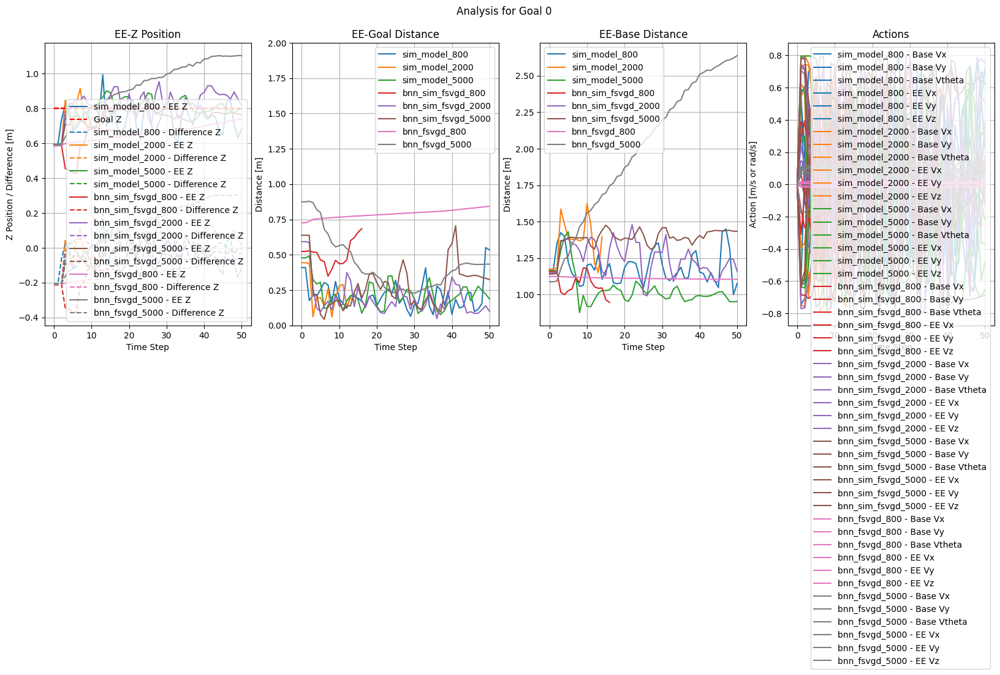

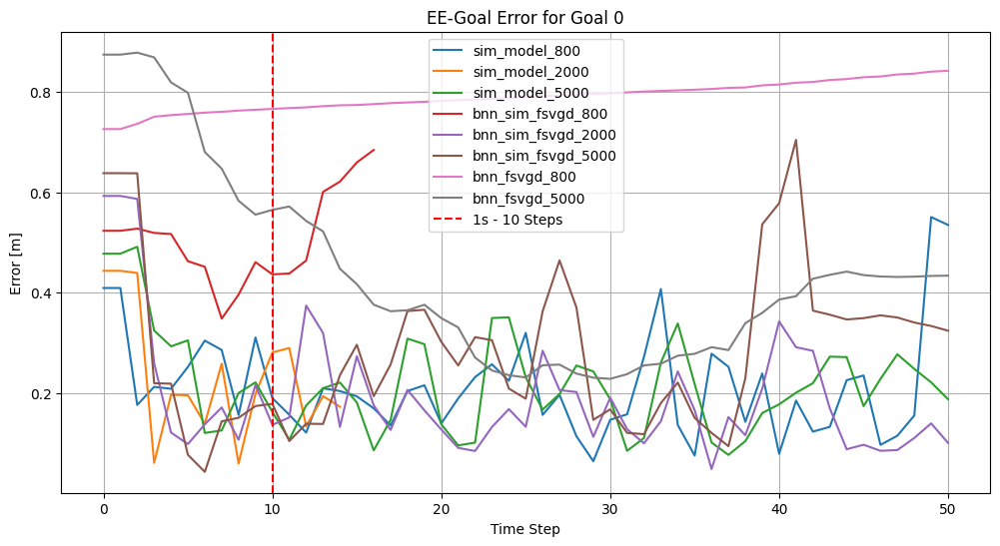

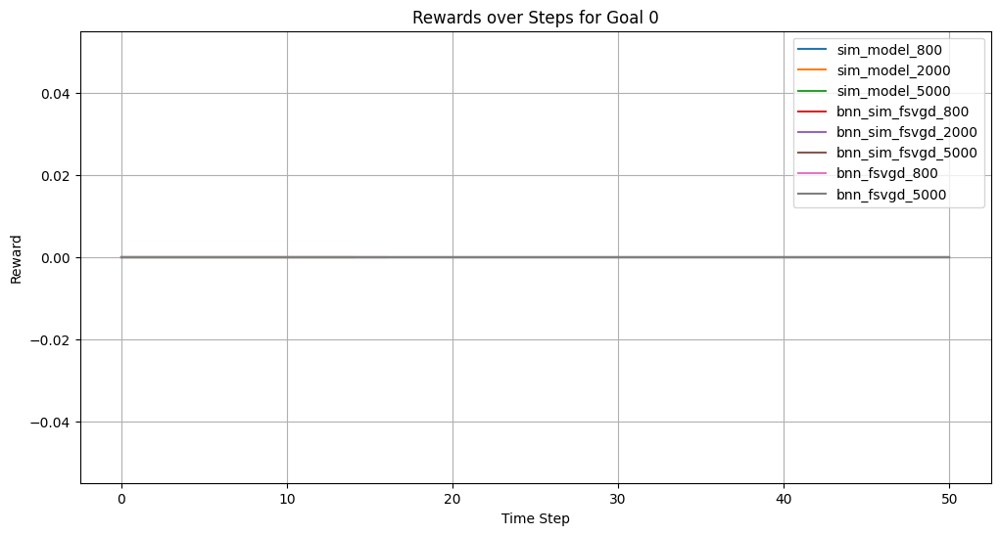

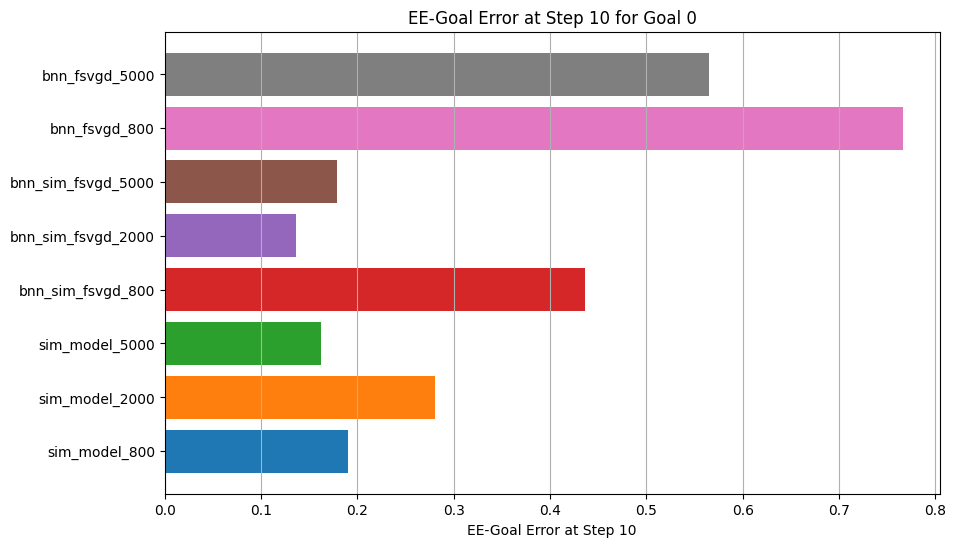

Performing analysis for Goal 1


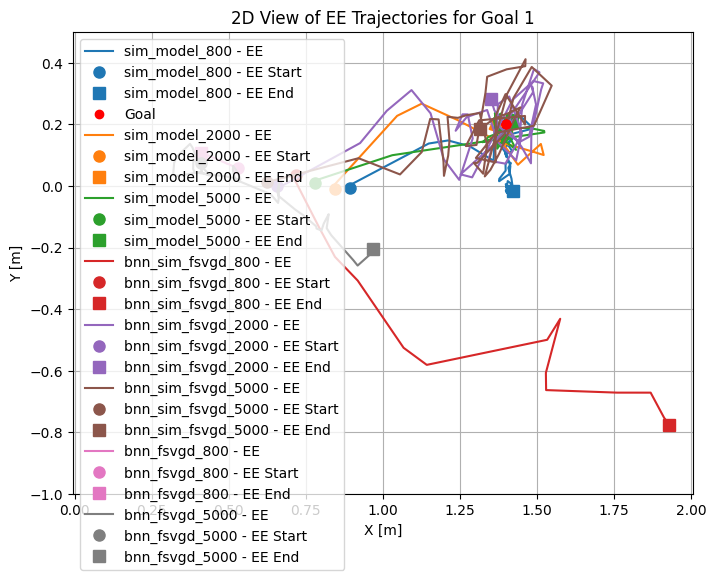

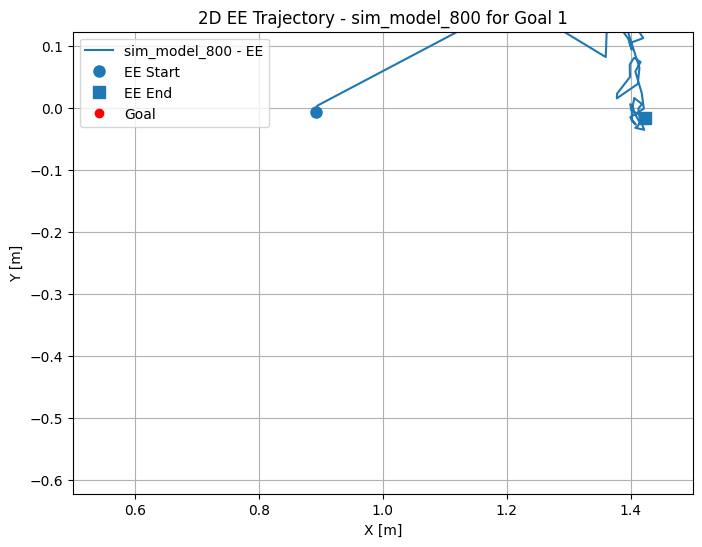

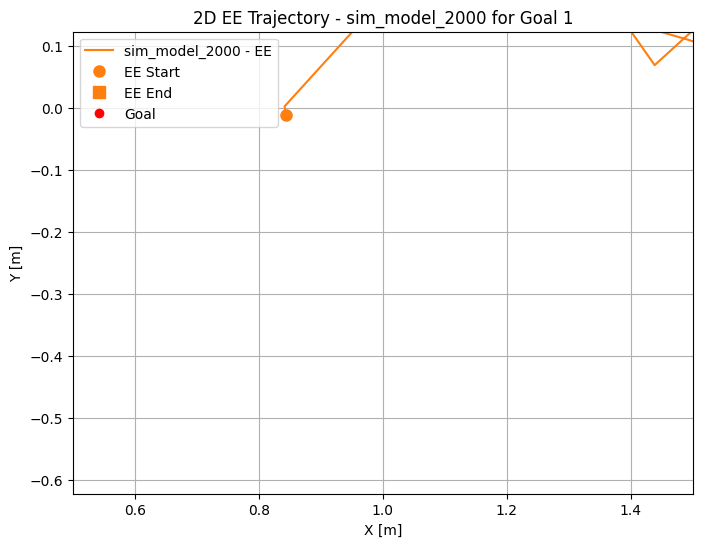

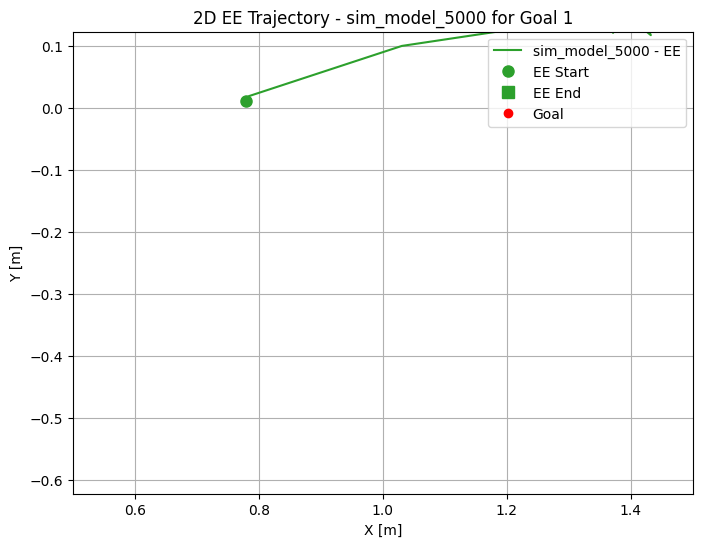

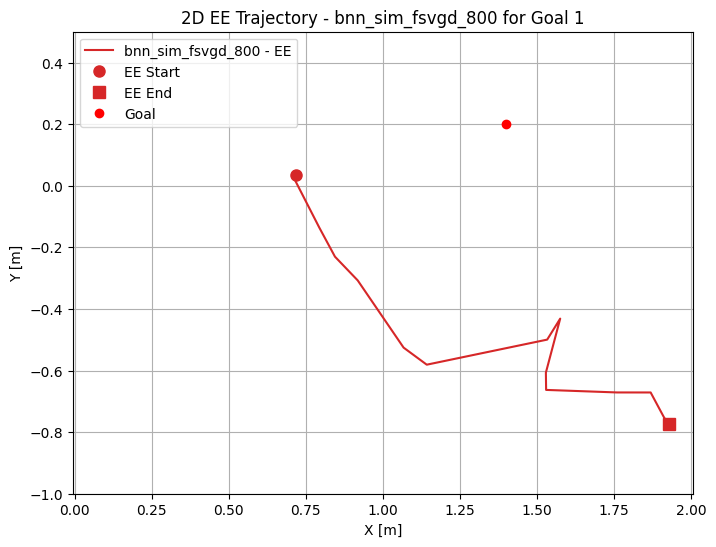

...

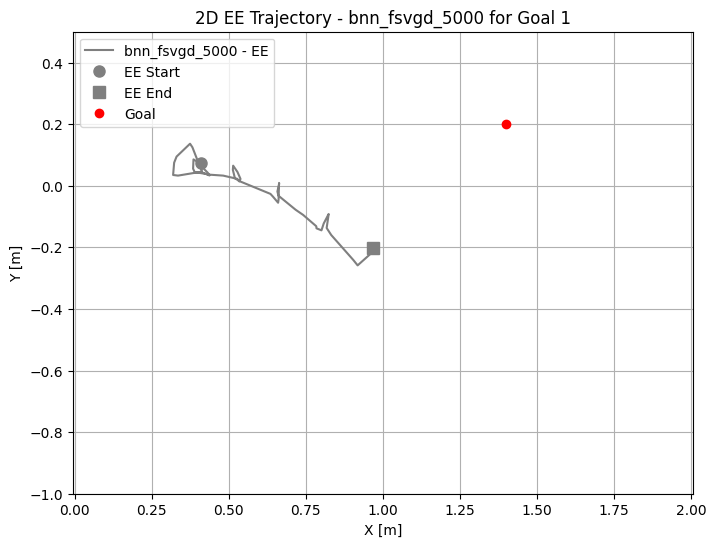

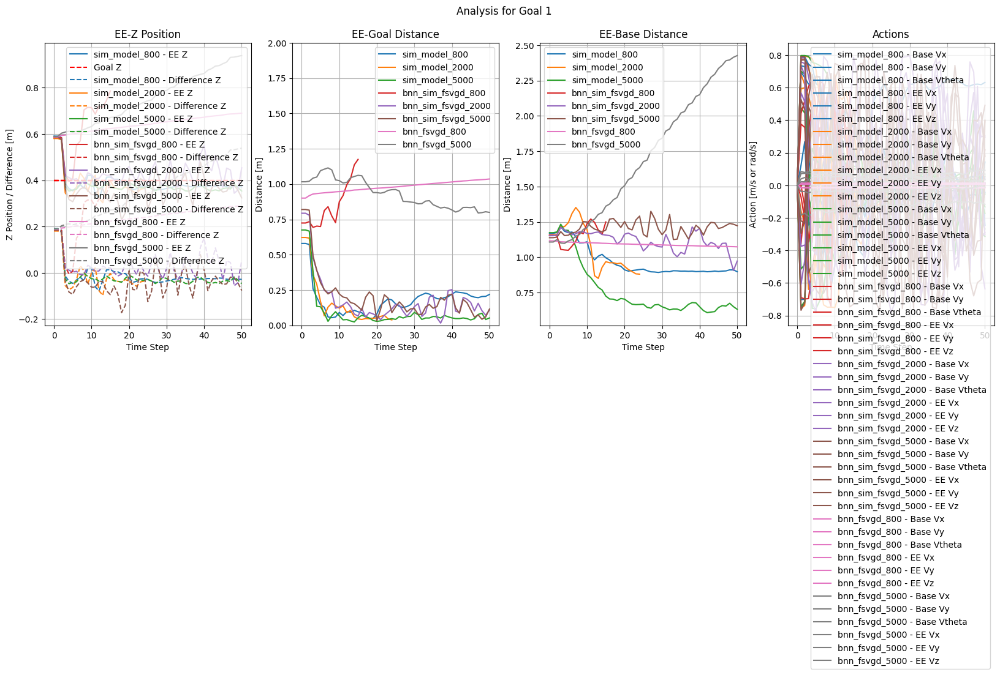

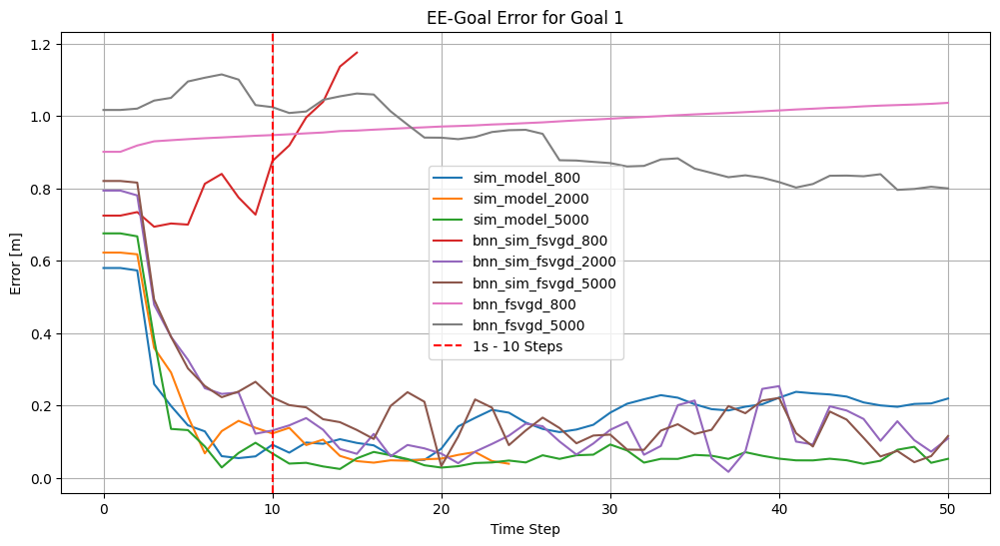

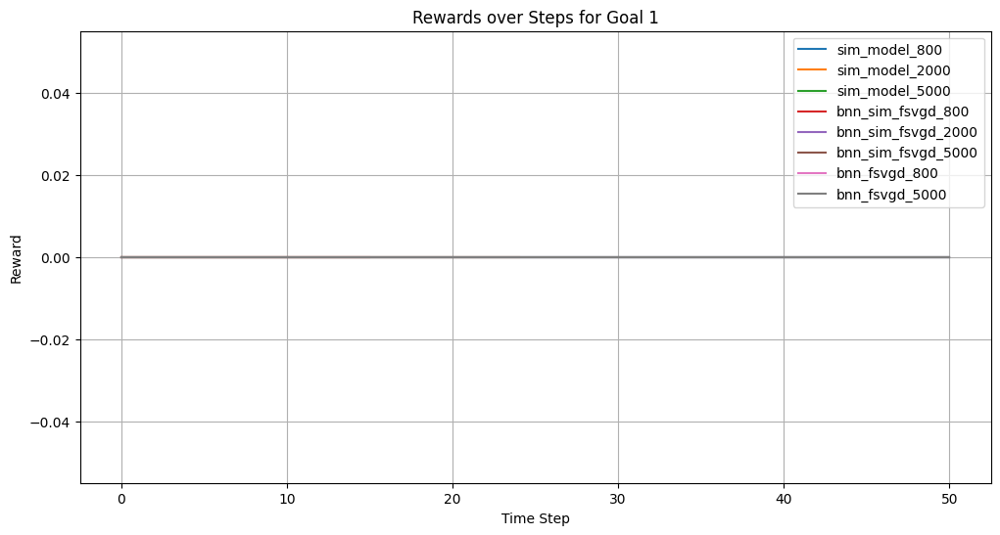

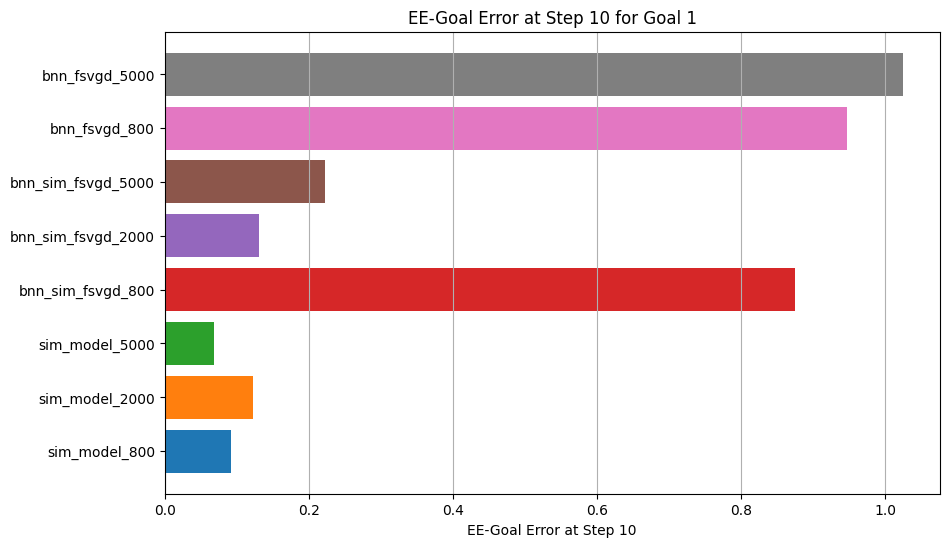

Performing analysis for Goal 2


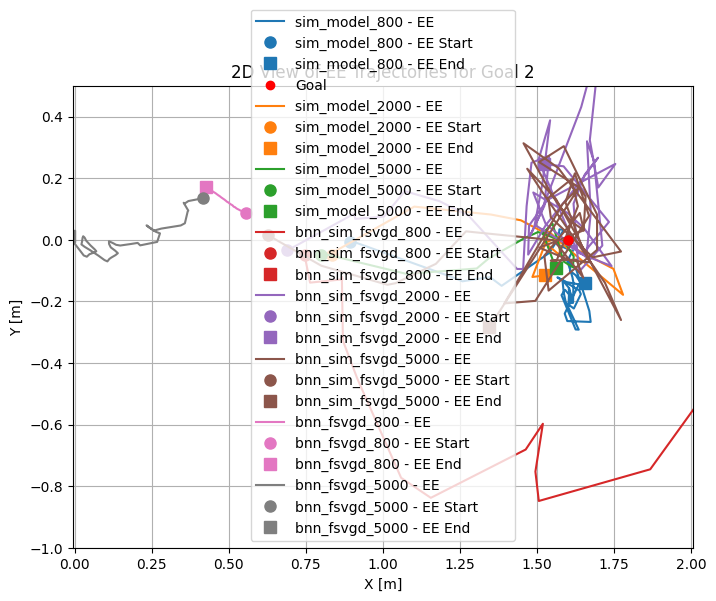

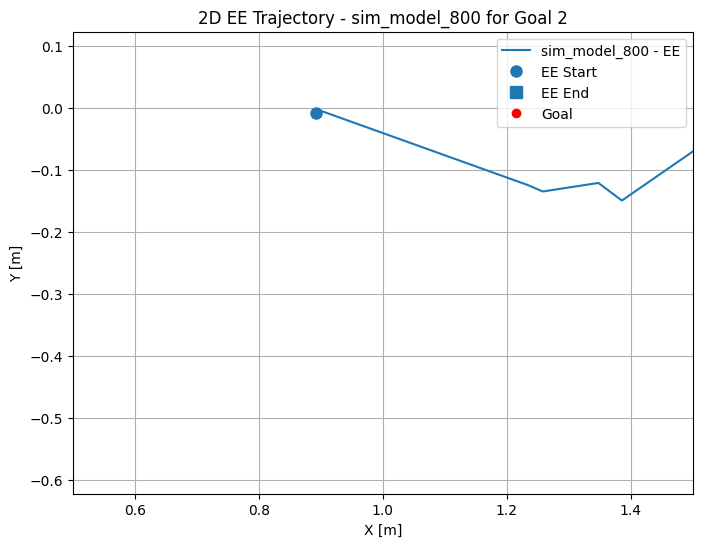

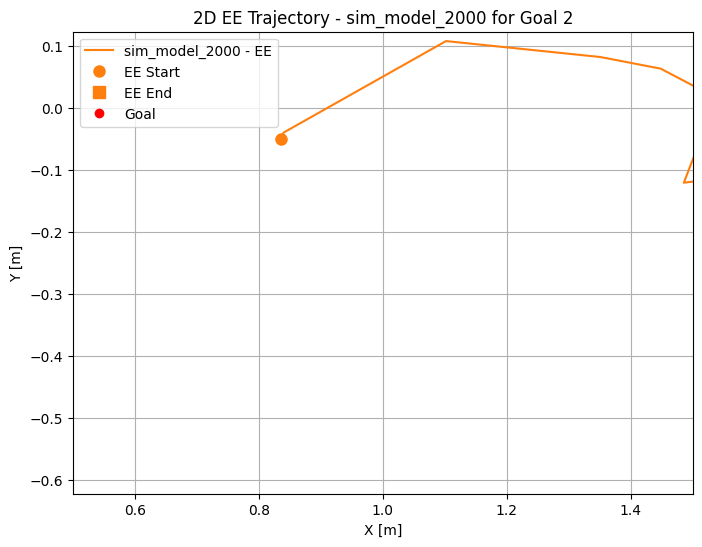

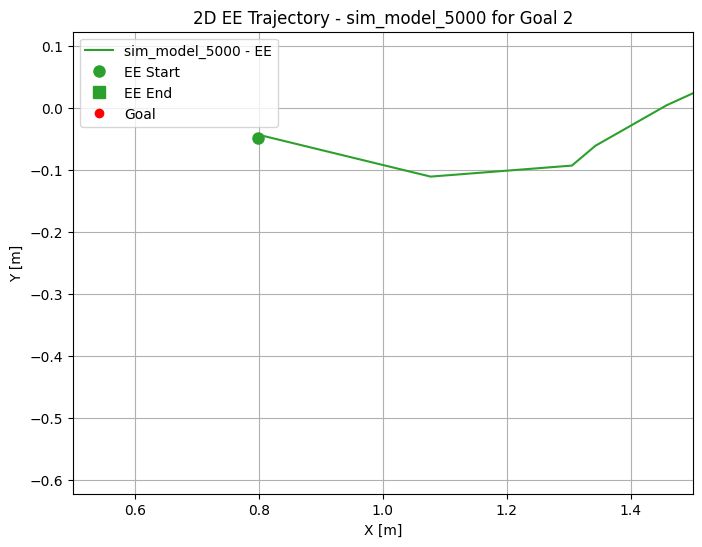

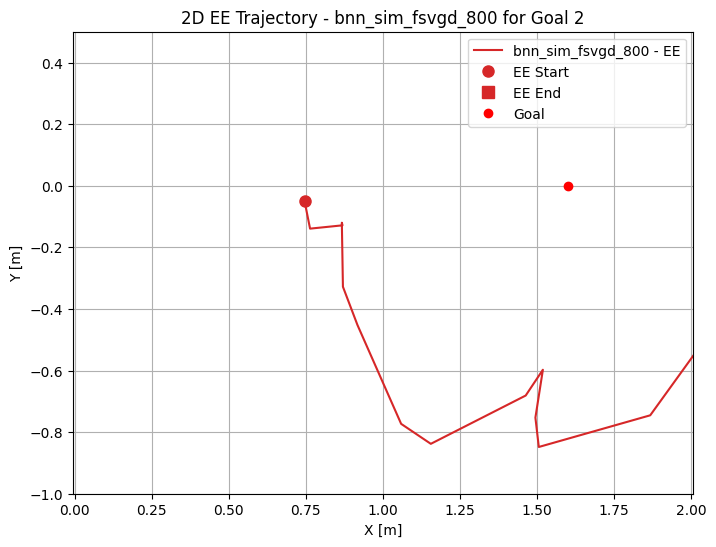

...

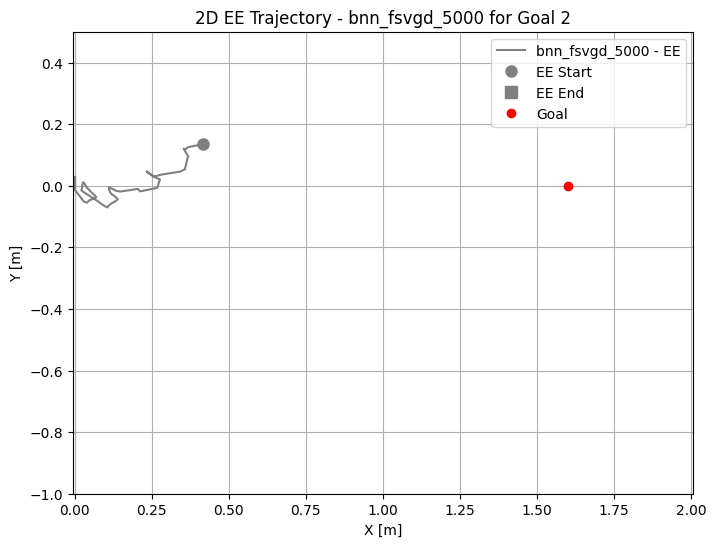

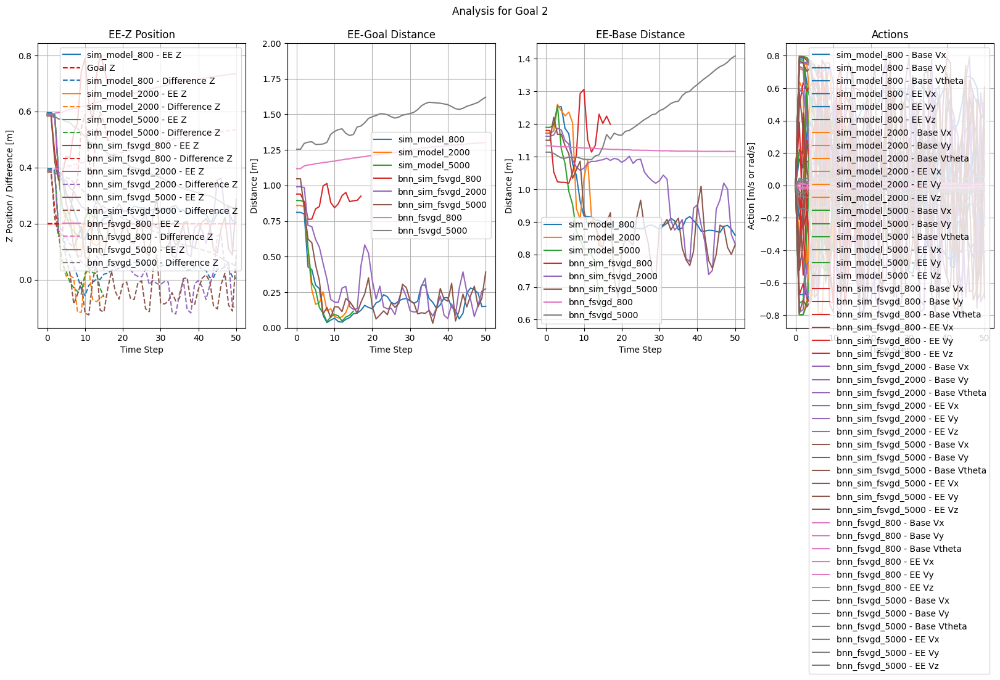

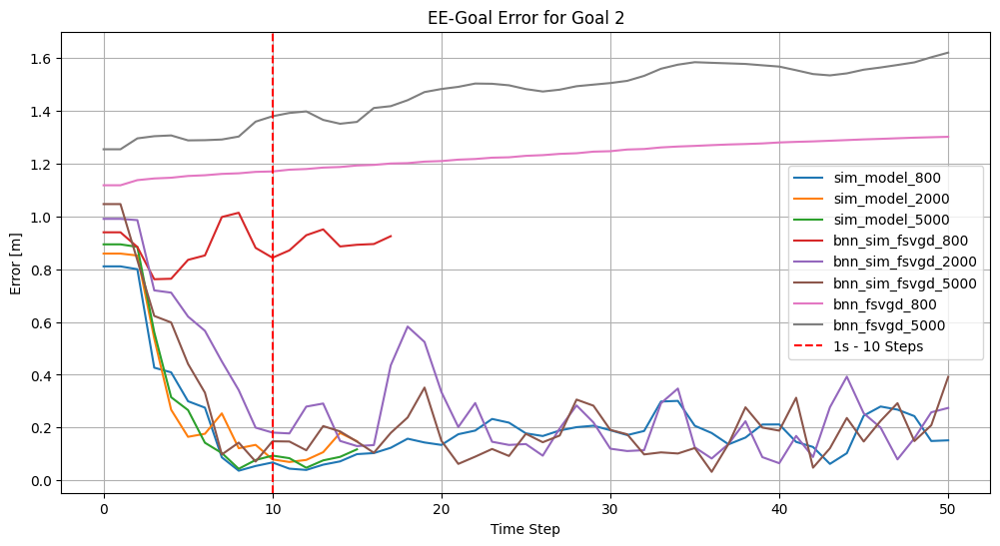

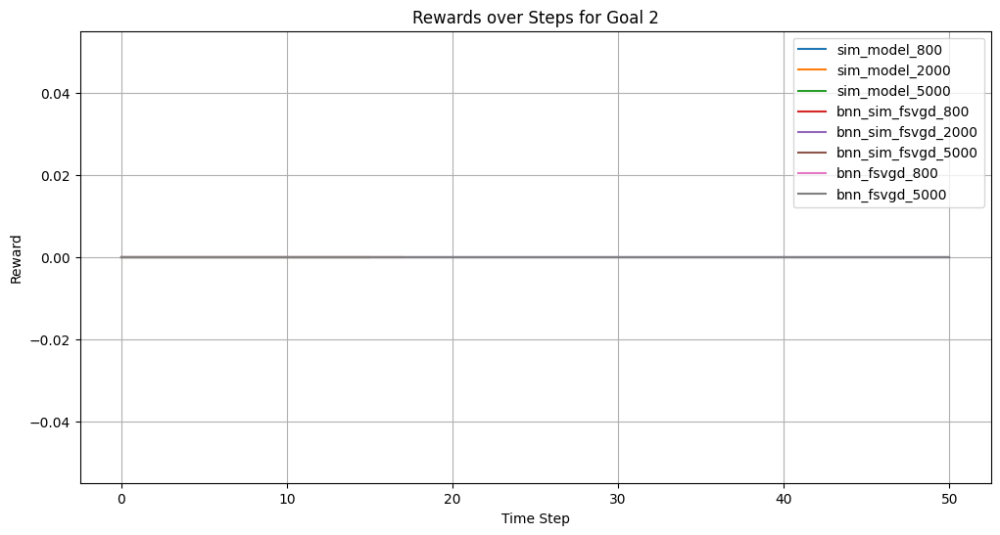

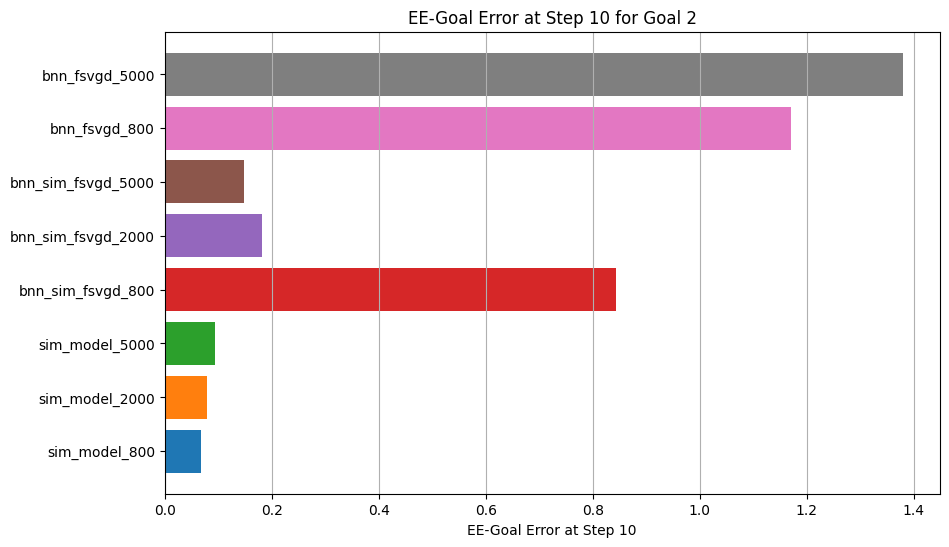

In [18]:
import pickle
import numpy as np
import matplotlib.pyplot as plt
from sim_transfer.sims.util import plot_spot_trajectory, decode_angles
from brax.training.types import Transition
import jax.tree_util as jtu
import jax.numpy as jnp
import re  # Import regular expressions module

# Define the list of trajectory files and their corresponding labels
file_paths = [
    # uses goal 0
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150458_policy_testing_partial_v4_hck2b2u0_sim-model_800_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150610_policy_testing_partial_v4_chn3iu4r_sim-model_2000_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150732_policy_testing_partial_v4_yjgeqtmy_sim-model_5000_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150840_policy_testing_partial_v4_sq0k6akn_bnn-sim-fsvgd_800_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150940_policy_testing_partial_v4_k5kepn4q_bnn-sim-fsvgd_2000_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151040_policy_testing_partial_v4_891g63gq_bnn-sim-fsvgd_5000_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151158_policy_testing_partial_v4_hjbw63y8_bnn-fsvgd_800_3_0__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151259_policy_testing_partial_v4_0dslu87b_bnn-fsvgd_2000_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151342_policy_testing_partial_v4_hq7f5yzu_bnn-fsvgd_5000_3_0__0.8/brax_transitions.pickle",
    
    # uses goal 1
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151922_policy_testing_partial_v4_hck2b2u0_sim-model_800_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152030_policy_testing_partial_v4_chn3iu4r_sim-model_2000_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152121_policy_testing_partial_v4_yjgeqtmy_sim-model_5000_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152233_policy_testing_partial_v4_sq0k6akn_bnn-sim-fsvgd_800_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152321_policy_testing_partial_v4_k5kepn4q_bnn-sim-fsvgd_2000_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152422_policy_testing_partial_v4_891g63gq_bnn-sim-fsvgd_5000_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152521_policy_testing_partial_v4_hjbw63y8_bnn-fsvgd_800_3_1__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152618_policy_testing_partial_v4_0dslu87b_bnn-fsvgd_2000_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152707_policy_testing_partial_v4_hq7f5yzu_bnn-fsvgd_5000_3_1__0.8/brax_transitions.pickle",

    # uses goal 2
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153401_policy_testing_partial_v4_hck2b2u0_sim-model_800_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153511_policy_testing_partial_v4_chn3iu4r_sim-model_2000_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153617_policy_testing_partial_v4_yjgeqtmy_sim-model_5000_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153718_policy_testing_partial_v4_sq0k6akn_bnn-sim-fsvgd_800_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153806_policy_testing_partial_v4_k5kepn4q_bnn-sim-fsvgd_2000_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153907_policy_testing_partial_v4_891g63gq_bnn-sim-fsvgd_5000_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-154010_policy_testing_partial_v4_hjbw63y8_bnn-fsvgd_800_3_2__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-154103_policy_testing_partial_v4_0dslu87b_bnn-fsvgd_2000_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-154148_policy_testing_partial_v4_hq7f5yzu_bnn-fsvgd_5000_3_2__0.8/brax_transitions.pickle",
]

labels = [
    # uses goal 0
    "sim_model_800",
    "sim_model_2000",
    "sim_model_5000",
    "bnn_sim_fsvgd_800",
    "bnn_sim_fsvgd_2000",
    "bnn_sim_fsvgd_5000",
    "bnn_fsvgd_800",
    # "bnn_fsvgd_2000",
    "bnn_fsvgd_5000",
    
    # uses goal 1
    "sim_model_800",
    "sim_model_2000",
    "sim_model_5000",
    "bnn_sim_fsvgd_800",
    "bnn_sim_fsvgd_2000",
    "bnn_sim_fsvgd_5000",
    "bnn_fsvgd_800",
    # "bnn_fsvgd_2000",
    "bnn_fsvgd_5000",

    # uses goal 2
    "sim_model_800",
    "sim_model_2000",
    "sim_model_5000",
    "bnn_sim_fsvgd_800",
    "bnn_sim_fsvgd_2000",
    "bnn_sim_fsvgd_5000",
    "bnn_fsvgd_800",
    # "bnn_fsvgd_2000",
    "bnn_fsvgd_5000",
]

goal_1 = jnp.array([1.2, -0.2, 0.8])
goal_2 = jnp.array([1.4, 0.2, 0.4])
goal_3 = jnp.array([1.6, 0.0, 0.2])

goals = [goal_1, goal_2, goal_3]

# Set global x and y limits for the 2D plots
x_limits = (0.5, 1.5)
y_limits = (-1, 0.5)

# Initialize a dictionary to store data per goal
goal_data = {}

# Loop over each trajectory file
for idx, file_path in enumerate(file_paths):
    # Load trajectory from policy simulation
    with open(file_path, "rb") as file:
        traj_raw = pickle.load(file)

    # Extract goal index from file path
    match = re.search(r'_3_(\d+)__', file_path)
    if match:
        goal_index = int(match.group(1))
    else:
        # Default to 0 or raise an error
        goal_index = 0
    if goal_index >= len(goals):
        print(f"Goal index {goal_index} out of range for file {file_path}")
        goal_index = 0  # Handle as appropriate

    goal = goals[goal_index]

    # Initialize data structures for this goal if not already done
    if goal_index not in goal_data:
        goal_data[goal_index] = {
            'file_paths': [],
            'labels': [],
            'observations': [],
            'actions': [],
            'rewards': [],
            'ee_goal_errors_at_step': [],
        }

    # Add goal to observations
    def add_goal_to_obs(obs: jnp.ndarray, goal: jnp.ndarray) -> jnp.ndarray:
        return jnp.concatenate([obs, goal])

    new_traj = []

    # Add goal to each observation in the trajectory
    for i in range(len(traj_raw)):
        obs = traj_raw[i].observation
        next_obs = traj_raw[i].next_observation
        obs = add_goal_to_obs(obs, goal)
        next_obs = add_goal_to_obs(next_obs, goal)
        new_traj.append(
            Transition(
                observation=obs,
                action=traj_raw[i].action,
                reward=jnp.array(0),
                next_observation=next_obs,
                discount=traj_raw[i].discount,
            )
        )

    traj = jtu.tree_map(lambda *xs: jnp.stack(xs, axis=0), *new_traj)

    # Convert transitions to trajectory
    observations = traj.observation
    actions = traj.action
    rewards = traj.reward

    # Decode angles if needed
    if observations.shape[-1] == 16:
        print(f"Decoding angles for {file_path}")
        observations = decode_angles(observations, 2)

    # Convert observations to numpy array
    observations_np = np.array(observations)

    # Calculate EE-Goal error at step 10 for this trajectory
    ee_pos = observations_np[:, 6:9]
    goal_pos = observations_np[:, -3:]
    error = np.linalg.norm(ee_pos - goal_pos, axis=1)
    step_index = 10  # Index for step 10

    ee_goal_error_at_step = error[step_index] if len(error) > step_index else np.nan

    # Append data to the corresponding goal
    goal_data[goal_index]['file_paths'].append(file_path)
    goal_data[goal_index]['labels'].append(labels[idx])
    goal_data[goal_index]['observations'].append(observations_np)
    goal_data[goal_index]['actions'].append(np.array(actions))
    goal_data[goal_index]['rewards'].append(np.array(rewards))
    goal_data[goal_index]['ee_goal_errors_at_step'].append(ee_goal_error_at_step)

# Plotting functions remain unchanged, but we'll call them per goal

def plot_ee_2d_view(traj_curr, labels, x_limits, y_limits, goal_index):
    """Plot EE trajectories for all models in a single plot."""
    plt.figure(figsize=(8, 6))
    cmap = plt.get_cmap("tab10")  # Define colormap outside the loop
    for idx, data in enumerate(traj_curr):
        # Use the colormap to assign consistent colors
        color = cmap(idx % 10)

        # Plot end-effector trajectory
        plt.plot(data[:, 6], data[:, 7], label=f"{labels[idx]} - EE", color=color)

        # Plot EE start and end points
        plt.plot(
            data[0, 6],
            data[0, 7],
            "o",
            color=color,
            markersize=8,
            label=f"{labels[idx]} - EE Start",
        )
        plt.plot(
            data[-1, 6],
            data[-1, 7],
            "s",
            color=color,
            markersize=8,
            label=f"{labels[idx]} - EE End",
        )

        # Plot goal position
        plt.plot(data[0, -3], data[0, -2], "ro", label="Goal" if idx == 0 else None)

    plt.title(f"2D View of EE Trajectories for Goal {goal_index}")
    plt.xlabel("X [m]")
    plt.ylabel("Y [m]")
    plt.axis("equal")
    plt.xlim(x_limits)
    plt.ylim(y_limits)
    plt.legend()
    plt.grid(True)
    plt.show()


def plot_individual_ee_trajectories(traj_curr, labels, x_limits, y_limits, goal_index):
    """Plot individual EE trajectories for each model."""
    cmap = plt.get_cmap("tab10")  # Define colormap outside the loop
    for idx, data in enumerate(traj_curr):
        plt.figure(figsize=(8, 6))
        # Use the colormap to assign consistent colors
        color = cmap(idx % 10)

        # Plot end-effector trajectory
        plt.plot(data[:, 6], data[:, 7], label=f"{labels[idx]} - EE", color=color)

        # Plot EE start and end points
        plt.plot(
            data[0, 6], data[0, 7], "o", color=color, markersize=8, label="EE Start"
        )
        plt.plot(
            data[-1, 6], data[-1, 7], "s", color=color, markersize=8, label="EE End"
        )

        # Plot goal position
        plt.plot(data[0, -3], data[0, -2], "ro", label="Goal")

        plt.title(f"2D EE Trajectory - {labels[idx]} for Goal {goal_index}")
        plt.xlabel("X [m]")
        plt.ylabel("Y [m]")
        plt.axis("equal")
        plt.xlim(x_limits)
        plt.ylim(y_limits)
        plt.legend()
        plt.grid(True)
        plt.show()


def plot_goal_and_traj(traj_curr, actions_curr, labels, goal_index):
    # Adjusted subplots to exclude the 2D view
    fig, axs = plt.subplots(1, 4, figsize=(20, 6))
    ax2, ax3, ax4, ax5 = axs

    cmap = plt.get_cmap("tab10")  # Define colormap for consistency

    # 2. Z Component Analysis
    for idx, data in enumerate(traj_curr):
        color = cmap(idx % 10)
        ee_z = data[:, 8]
        goal_z = data[0, -1]
        time_steps = np.arange(data.shape[0])
        ax2.plot(time_steps, ee_z, label=f"{labels[idx]} - EE Z", color=color)
        ax2.hlines(
            goal_z,
            time_steps[0],
            time_steps[-1],
            colors="r",
            linestyles="--",
            label="Goal Z" if idx == 0 else None,
        )
        diff_z = ee_z - goal_z
        ax2.plot(
            time_steps,
            diff_z,
            linestyle="--",
            label=f"{labels[idx]} - Difference Z",
            color=color,
        )
    ax2.set_title("EE-Z Position")
    ax2.set_xlabel("Time Step")
    ax2.set_ylabel("Z Position / Difference [m]")
    ax2.legend()
    ax2.grid(True)

    # 3. EE-Goal Distance
    for idx, data in enumerate(traj_curr):
        color = cmap(idx % 10)
        ee_pos = data[:, 6:9]
        goal_pos = data[:, -3:]
        distance = np.linalg.norm(ee_pos - goal_pos, axis=1)
        time_steps = np.arange(data.shape[0])
        ax3.plot(time_steps, distance, label=f"{labels[idx]}", color=color)
    ax3.set_title("EE-Goal Distance")
    ax3.set_xlabel("Time Step")
    ax3.set_ylabel("Distance [m]")
    ax3.set_ylim(0, 2)
    ax3.legend()
    ax3.grid(True)

    # 4. EE-Base Distance
    for idx, data in enumerate(traj_curr):
        color = cmap(idx % 10)
        ee_pos = data[:, 6:9]
        base_pos = data[:, 0:3]
        distance = np.linalg.norm(ee_pos - base_pos, axis=1)
        time_steps = np.arange(data.shape[0])
        ax4.plot(time_steps, distance, label=f"{labels[idx]}", color=color)
    ax4.set_title("EE-Base Distance")
    ax4.set_xlabel("Time Step")
    ax4.set_ylabel("Distance [m]")
    ax4.legend()
    ax4.grid(True)

    # 5. Actions
    for idx, data in enumerate(actions_curr):
        color = cmap(idx % 10)
        time_steps = np.arange(data.shape[0])
        ax5.plot(time_steps, data[:, 0], label=f"{labels[idx]} - Base Vx", color=color)
        ax5.plot(time_steps, data[:, 1], label=f"{labels[idx]} - Base Vy", color=color)
        ax5.plot(
            time_steps, data[:, 2], label=f"{labels[idx]} - Base Vtheta", color=color
        )
        ax5.plot(time_steps, data[:, 3], label=f"{labels[idx]} - EE Vx", color=color)
        ax5.plot(time_steps, data[:, 4], label=f"{labels[idx]} - EE Vy", color=color)
        ax5.plot(time_steps, data[:, 5], label=f"{labels[idx]} - EE Vz", color=color)
    ax5.set_title("Actions")
    ax5.set_xlabel("Time Step")
    ax5.set_ylabel("Action [m/s or rad/s]")
    ax5.legend()
    ax5.grid(True)

    plt.suptitle(f"Analysis for Goal {goal_index}")
    plt.show()


def plot_ee_goal_error(trajs, labels, goal_index):
    # Calculate error between EE and Goal
    ee_goal_error = []
    for traj in trajs:
        ee_pos = traj[:, 6:9]
        goal_pos = traj[:, -3:]
        error = np.linalg.norm(ee_pos - goal_pos, axis=1)
        ee_goal_error.append(error)
    # ee_goal_error = np.array(ee_goal_error)

    # Plot errors
    plt.figure(figsize=(12, 6))
    cmap = plt.get_cmap("tab10")

    # Plot all errors
    for idx, error in enumerate(ee_goal_error):
        color = cmap(idx % 10)
        time_steps = np.arange(error.shape[0])
        plt.plot(time_steps, error, label=f"{labels[idx]}", color=color)
    plt.axvline(10, color="r", linestyle="--", label="1s - 10 Steps")
    plt.title(f"EE-Goal Error for Goal {goal_index}")
    plt.xlabel("Time Step")
    plt.ylabel("Error [m]")
    plt.legend()
    plt.grid(True)
    plt.show()


def plot_rewards(all_rewards, labels, goal_index):
    plt.figure(figsize=(12, 6))
    cmap = plt.get_cmap("tab10")
    for idx, rewards in enumerate(all_rewards):
        color = cmap(idx % 10)
        time_steps = np.arange(len(rewards))
        plt.plot(time_steps, rewards, label=f"{labels[idx]}", color=color)
    plt.title(f"Rewards over Steps for Goal {goal_index}")
    plt.xlabel("Time Step")
    plt.ylabel("Reward")
    plt.legend()
    plt.grid(True)
    plt.show()


def plot_ee_goal_error_at_step(errors, labels, step_index, goal_index):
    """Plot a horizontal bar plot of EE-Goal errors at a specific step."""
    plt.figure(figsize=(10, 6))
    y_positions = np.arange(len(labels))
    cmap = plt.get_cmap("tab10")
    colors = [
        cmap(idx % 10) for idx in range(len(labels))
    ]  # Assign colors consistently

    plt.barh(y_positions, errors, align="center", color=colors)
    plt.yticks(y_positions, labels)
    plt.xlabel(f"EE-Goal Error at Step {step_index}")
    plt.title(f"EE-Goal Error at Step {step_index} for Goal {goal_index}")
    plt.grid(True, axis="x")
    plt.show()


# Now, perform the analysis per goal
for goal_index, data in goal_data.items():
    print(f"Performing analysis for Goal {goal_index}")
    observations = data['observations']
    actions = data['actions']
    labels = data['labels']
    ee_goal_errors_at_step = data['ee_goal_errors_at_step']
    rewards = data['rewards']

    # Plot the standalone 2D EE trajectory view with new x and y limits
    plot_ee_2d_view(observations, labels, x_limits, y_limits, goal_index)

    # Plot individual 2D EE trajectories for each model with new x and y limits
    plot_individual_ee_trajectories(observations, labels, x_limits, y_limits, goal_index)

    # Plot the other subplots without the 2D view
    plot_goal_and_traj(observations, actions, labels, goal_index)

    # Plot EE-Goal Error without mean/std plot
    plot_ee_goal_error(observations, labels, goal_index)

    # Plot rewards over steps
    plot_rewards(rewards, labels, goal_index)

    # Plot EE-Goal Error at Step 10 using a horizontal bar plot with consistent colors
    plot_ee_goal_error_at_step(ee_goal_errors_at_step, labels, step_index=10, goal_index=goal_index)


Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150458_policy_testing_partial_v4_hck2b2u0_sim-model_800_3_0__0.8/brax_transitions.pickle
Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150610_policy_testing_partial_v4_chn3iu4r_sim-model_2000_3_0__0.8/brax_transitions.pickle
Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150732_policy_testing_partial_v4_yjgeqtmy_sim-model_5000_3_0__0.8/brax_transitions.pickle
Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150840_policy_testing_partial_v4_sq0k6akn_bnn-sim-fsvgd_800_3_0__0.8/brax_transitions.pickle
Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150940_policy_testing_partial_v4_k5kepn4q_bnn-sim-fsvgd_2000_3_0__0.8/brax_transitions.pickle
Decoding angle

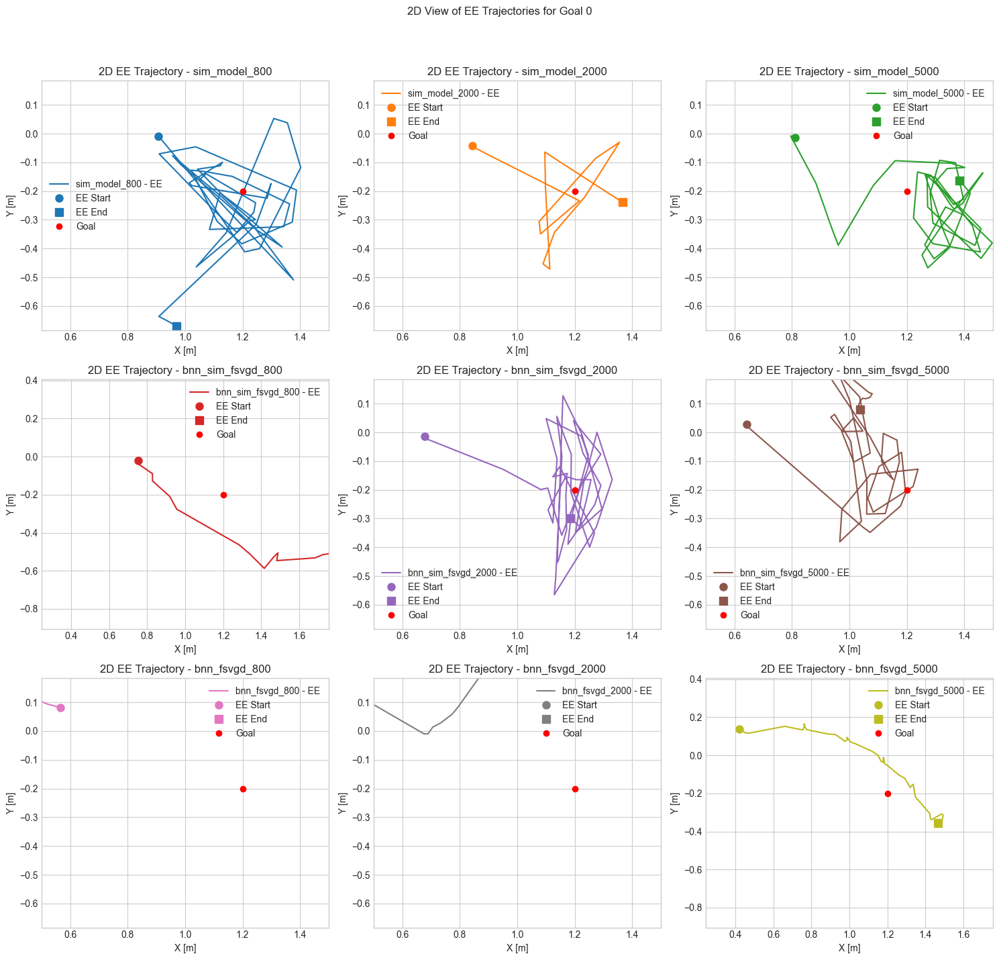

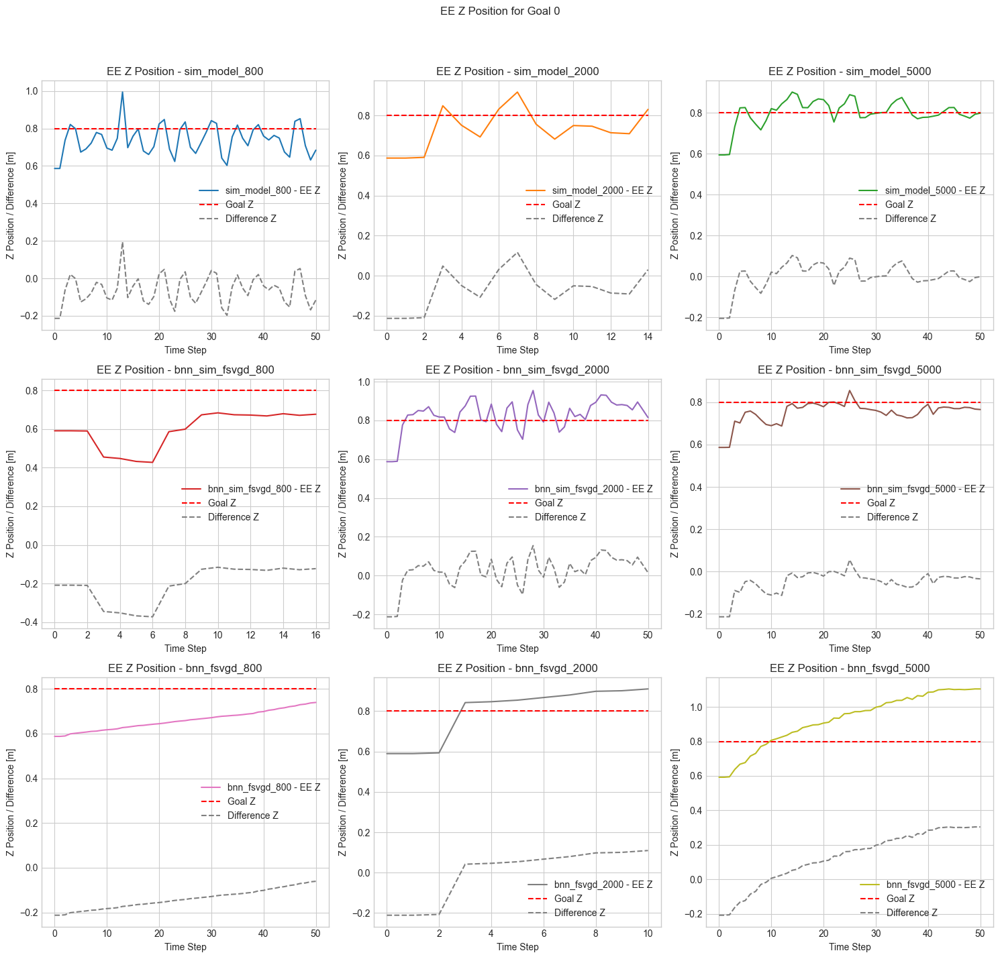

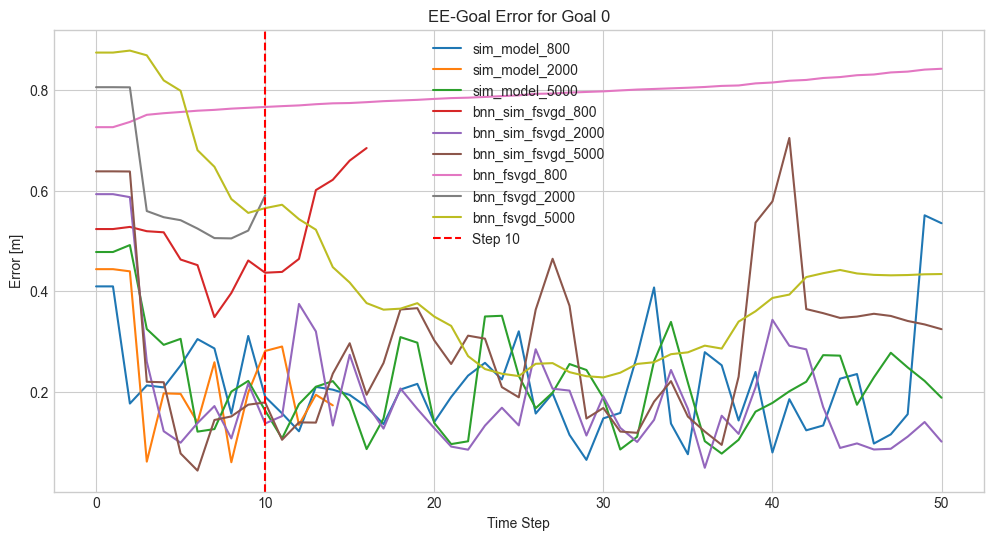

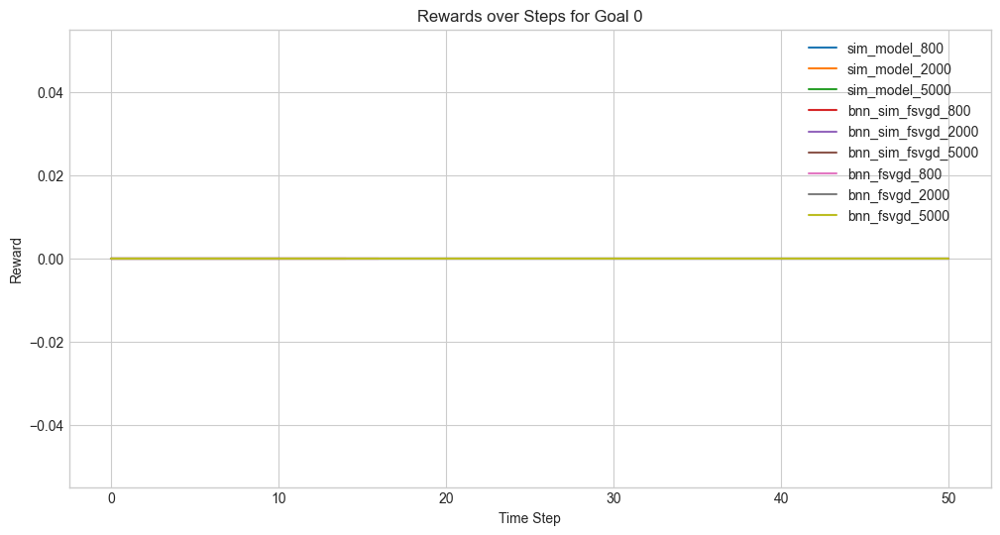

Performing analysis for Goal 1


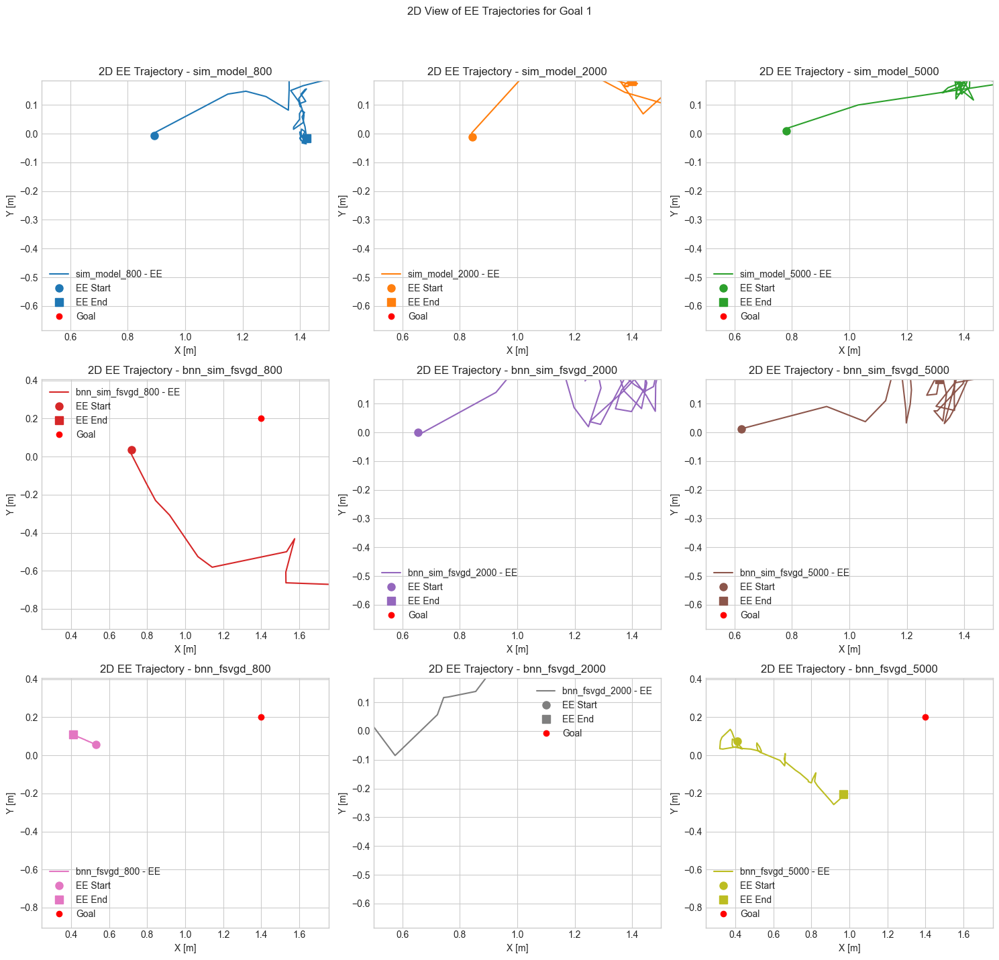

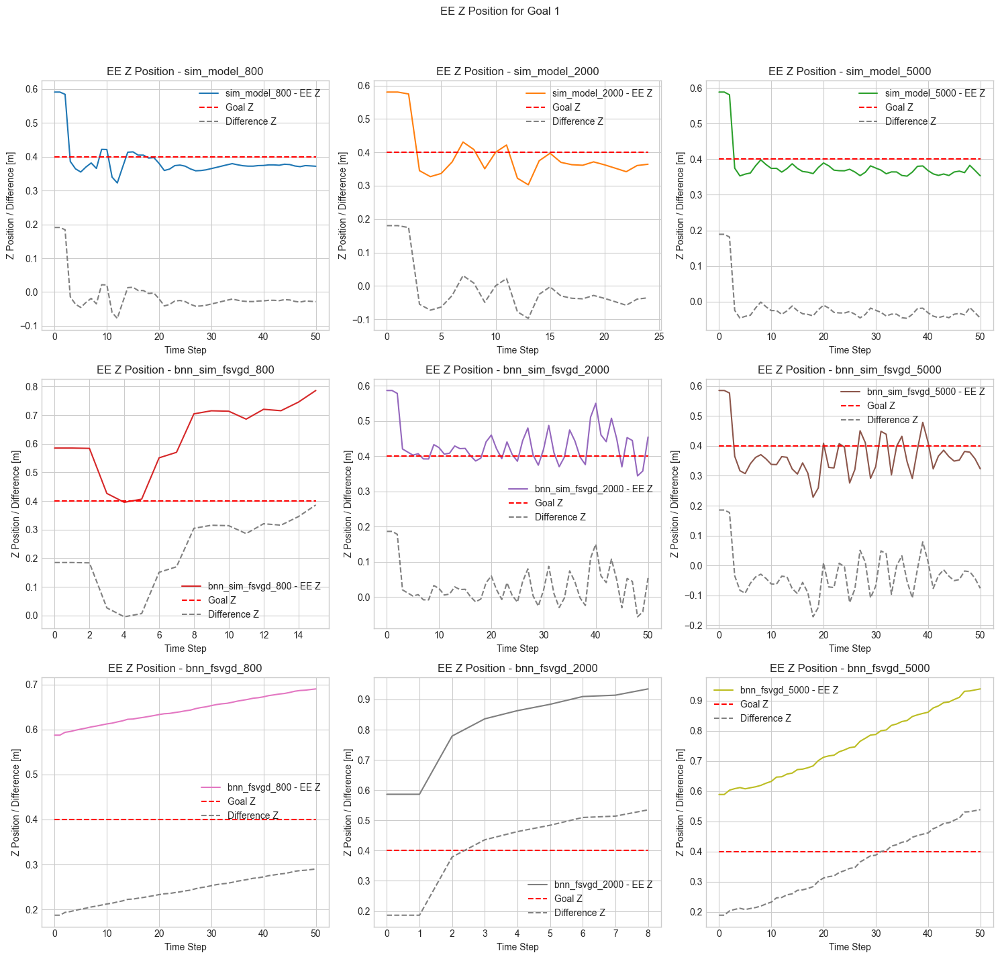

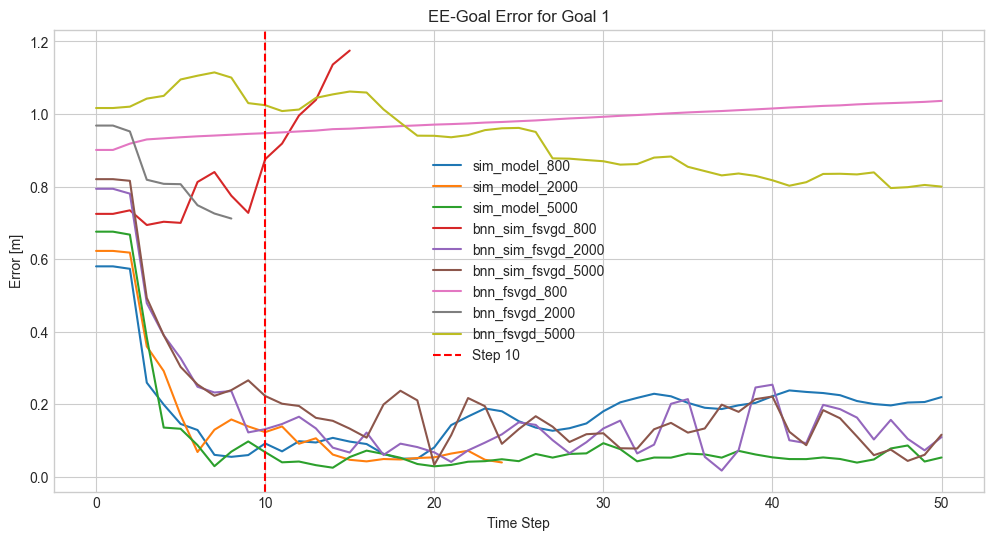

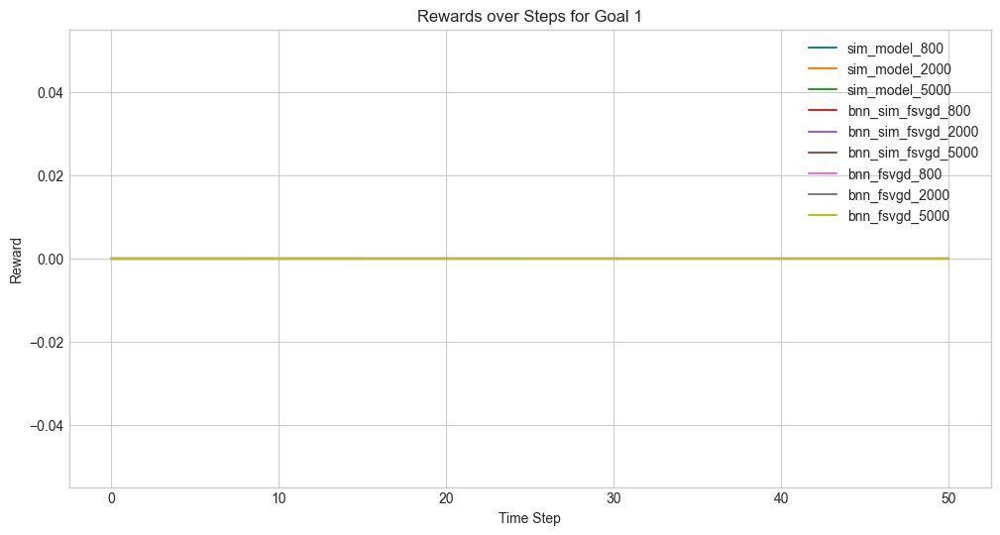

Performing analysis for Goal 2


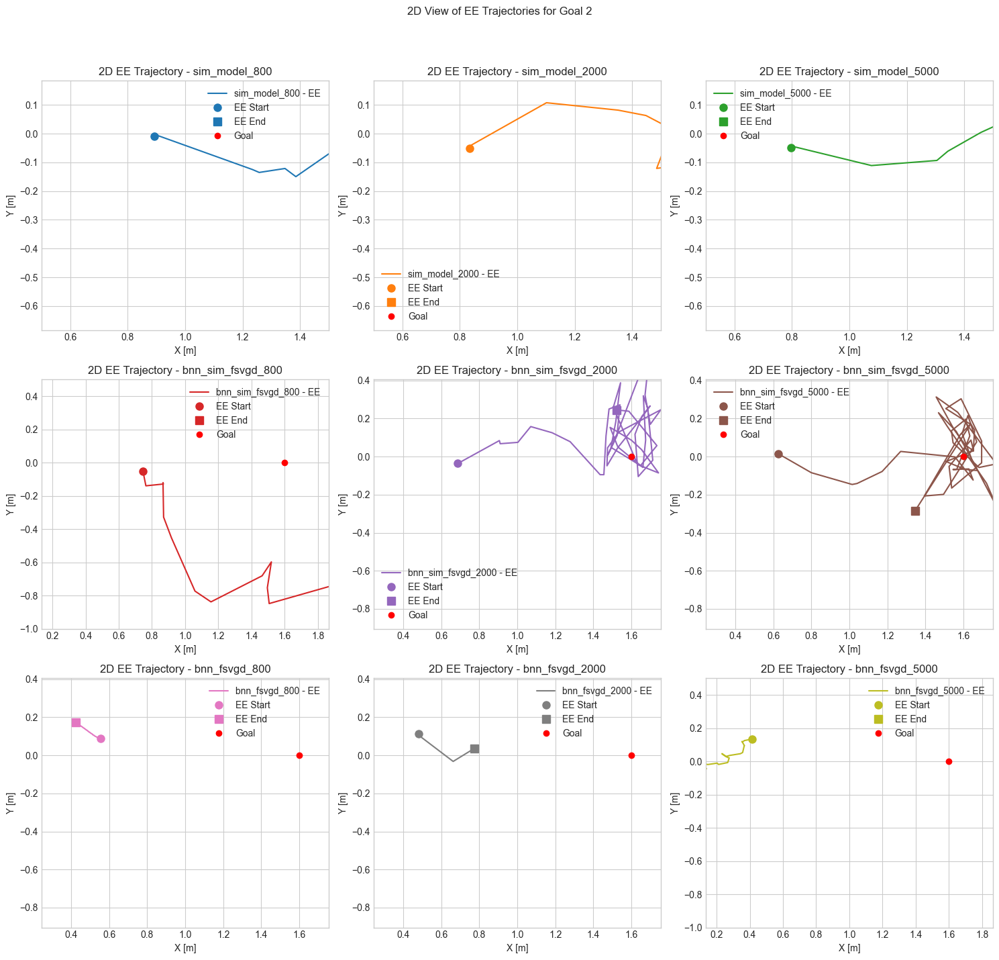

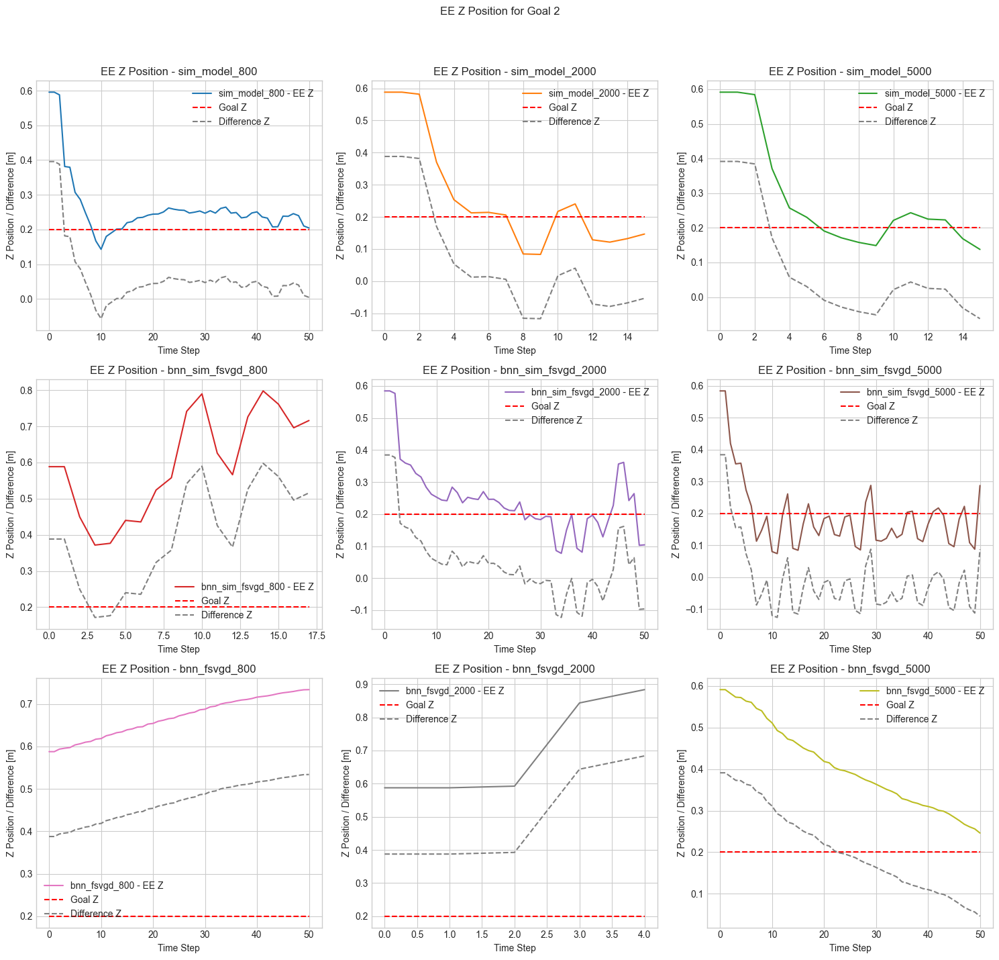

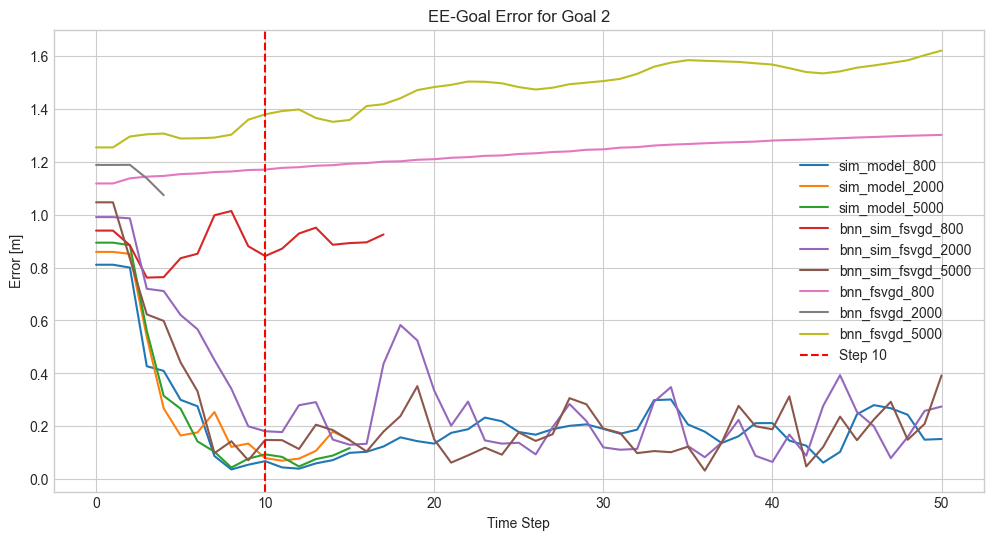

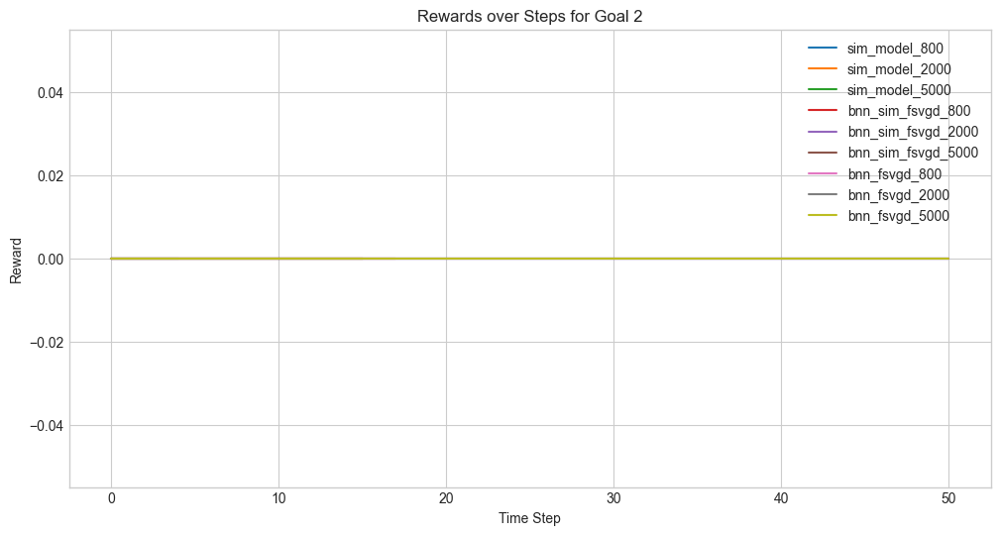

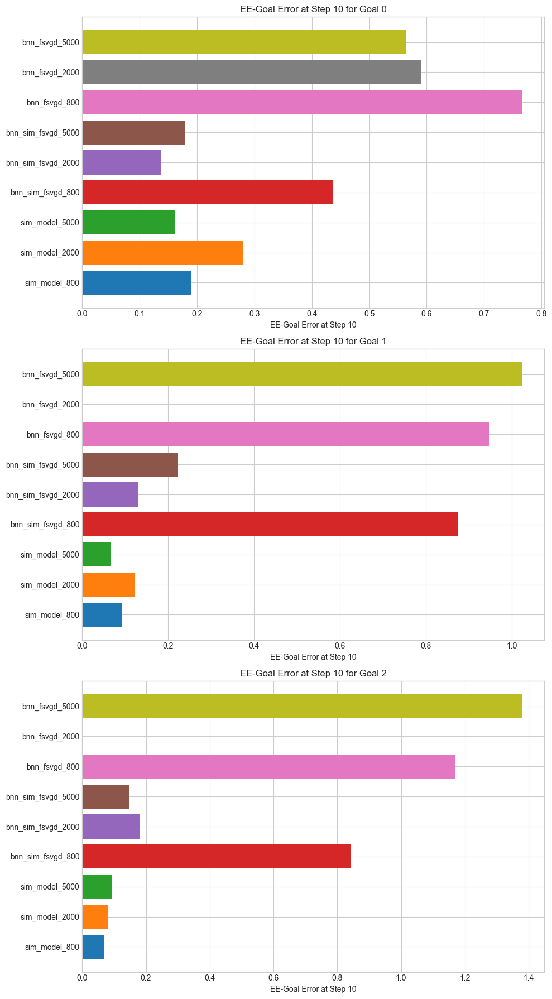

In [10]:
import pickle
import numpy as np
import matplotlib.pyplot as plt
from sim_transfer.sims.util import decode_angles
from brax.training.types import Transition
import jax.tree_util as jtu
import jax.numpy as jnp
import re

# Global variables
step_index = 10  # Define the step index for error calculation
plot_analysis = False  # Set to True to enable 'Analysis for Goal x' plots

# Define the list of trajectory files and their corresponding labels
file_paths = [
    # uses goal 0
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150458_policy_testing_partial_v4_hck2b2u0_sim-model_800_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150610_policy_testing_partial_v4_chn3iu4r_sim-model_2000_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150732_policy_testing_partial_v4_yjgeqtmy_sim-model_5000_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150840_policy_testing_partial_v4_sq0k6akn_bnn-sim-fsvgd_800_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150940_policy_testing_partial_v4_k5kepn4q_bnn-sim-fsvgd_2000_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151040_policy_testing_partial_v4_891g63gq_bnn-sim-fsvgd_5000_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151158_policy_testing_partial_v4_hjbw63y8_bnn-fsvgd_800_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151259_policy_testing_partial_v4_0dslu87b_bnn-fsvgd_2000_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151342_policy_testing_partial_v4_hq7f5yzu_bnn-fsvgd_5000_3_0__0.8/brax_transitions.pickle",
    
    # uses goal 1
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151922_policy_testing_partial_v4_hck2b2u0_sim-model_800_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152030_policy_testing_partial_v4_chn3iu4r_sim-model_2000_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152121_policy_testing_partial_v4_yjgeqtmy_sim-model_5000_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152233_policy_testing_partial_v4_sq0k6akn_bnn-sim-fsvgd_800_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152321_policy_testing_partial_v4_k5kepn4q_bnn-sim-fsvgd_2000_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152422_policy_testing_partial_v4_891g63gq_bnn-sim-fsvgd_5000_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152521_policy_testing_partial_v4_hjbw63y8_bnn-fsvgd_800_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152618_policy_testing_partial_v4_0dslu87b_bnn-fsvgd_2000_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152707_policy_testing_partial_v4_hq7f5yzu_bnn-fsvgd_5000_3_1__0.8/brax_transitions.pickle",

    # uses goal 2
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153401_policy_testing_partial_v4_hck2b2u0_sim-model_800_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153511_policy_testing_partial_v4_chn3iu4r_sim-model_2000_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153617_policy_testing_partial_v4_yjgeqtmy_sim-model_5000_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153718_policy_testing_partial_v4_sq0k6akn_bnn-sim-fsvgd_800_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153806_policy_testing_partial_v4_k5kepn4q_bnn-sim-fsvgd_2000_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153907_policy_testing_partial_v4_891g63gq_bnn-sim-fsvgd_5000_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-154010_policy_testing_partial_v4_hjbw63y8_bnn-fsvgd_800_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-154103_policy_testing_partial_v4_0dslu87b_bnn-fsvgd_2000_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-154148_policy_testing_partial_v4_hq7f5yzu_bnn-fsvgd_5000_3_2__0.8/brax_transitions.pickle",
]

labels = [
    # uses goal 0
    "sim_model_800",
    "sim_model_2000",
    "sim_model_5000",
    "bnn_sim_fsvgd_800",
    "bnn_sim_fsvgd_2000",
    "bnn_sim_fsvgd_5000",
    "bnn_fsvgd_800",
    "bnn_fsvgd_2000",
    "bnn_fsvgd_5000",
    
    # uses goal 1
    "sim_model_800",
    "sim_model_2000",
    "sim_model_5000",
    "bnn_sim_fsvgd_800",
    "bnn_sim_fsvgd_2000",
    "bnn_sim_fsvgd_5000",
    "bnn_fsvgd_800",
    "bnn_fsvgd_2000",
    "bnn_fsvgd_5000",

    # uses goal 2
    "sim_model_800",
    "sim_model_2000",
    "sim_model_5000",
    "bnn_sim_fsvgd_800",
    "bnn_sim_fsvgd_2000",
    "bnn_sim_fsvgd_5000",
    "bnn_fsvgd_800",
    "bnn_fsvgd_2000",
    "bnn_fsvgd_5000",
]

goal_1 = jnp.array([1.2, -0.2, 0.8])
goal_2 = jnp.array([1.4, 0.2, 0.4])
goal_3 = jnp.array([1.6, 0.0, 0.2])

goals = [goal_1, goal_2, goal_3]

# Set global x and y limits for the 2D plots
x_limits = (0.5, 1.5)
y_limits = (-1, 0.5)

# Initialize a dictionary to store data per goal
goal_data = {}

# Loop over each trajectory file
for idx, file_path in enumerate(file_paths):
    # Load trajectory from policy simulation
    with open(file_path, "rb") as file:
        traj_raw = pickle.load(file)

    # Extract goal index from file path
    match = re.search(r'_3_(\d+)__', file_path)
    if match:
        goal_index = int(match.group(1))
    else:
        # Default to 0 or raise an error
        goal_index = 0
    if goal_index >= len(goals):
        print(f"Goal index {goal_index} out of range for file {file_path}")
        goal_index = 0  # Handle as appropriate

    goal = goals[goal_index]

    # Initialize data structures for this goal if not already done
    if goal_index not in goal_data:
        goal_data[goal_index] = {
            'file_paths': [],
            'labels': [],
            'observations': [],
            'actions': [],
            'rewards': [],
            'ee_goal_errors_at_step': [],
        }

    # Add goal to observations
    def add_goal_to_obs(obs: jnp.ndarray, goal: jnp.ndarray) -> jnp.ndarray:
        return jnp.concatenate([obs, goal])

    new_traj = []

    # Add goal to each observation in the trajectory
    for i in range(len(traj_raw)):
        obs = traj_raw[i].observation
        next_obs = traj_raw[i].next_observation
        obs = add_goal_to_obs(obs, goal)
        next_obs = add_goal_to_obs(next_obs, goal)
        new_traj.append(
            Transition(
                observation=obs,
                action=traj_raw[i].action,
                reward=jnp.array(0),
                next_observation=next_obs,
                discount=traj_raw[i].discount,
            )
        )

    traj = jtu.tree_map(lambda *xs: jnp.stack(xs, axis=0), *new_traj)

    # Convert transitions to trajectory
    observations = traj.observation
    actions = traj.action
    rewards = traj.reward

    # Decode angles if needed
    if observations.shape[-1] == 16:
        print(f"Decoding angles for {file_path}")
        observations = decode_angles(observations, 2)

    # Convert observations to numpy array
    observations_np = np.array(observations)

    # Calculate EE-Goal error at step_index for this trajectory
    ee_pos = observations_np[:, 6:9]
    goal_pos = observations_np[:, -3:]
    error = np.linalg.norm(ee_pos - goal_pos, axis=1)
    if len(error) > step_index:
        ee_goal_error_at_step = error[step_index]
    else:
        # Handle case where trajectory is shorter than step_index+1 steps
        ee_goal_error_at_step = np.nan

    # Append data to the corresponding goal
    goal_data[goal_index]['file_paths'].append(file_path)
    goal_data[goal_index]['labels'].append(labels[idx])
    goal_data[goal_index]['observations'].append(observations_np)
    goal_data[goal_index]['actions'].append(np.array(actions))
    goal_data[goal_index]['rewards'].append(np.array(rewards))
    goal_data[goal_index]['ee_goal_errors_at_step'].append(ee_goal_error_at_step)

# Plotting functions

def plot_ee_2d_view(traj_curr, labels, x_limits, y_limits, goal_index):
    """Plot EE trajectories for all models in subplots."""
    num_models = len(traj_curr)
    num_cols = 3
    num_rows = (num_models + num_cols - 1) // num_cols

    fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))
    axs = axs.flatten()
    cmap = plt.get_cmap("tab10")

    for idx, data in enumerate(traj_curr):
        ax = axs[idx]
        color = cmap(idx % 10)
        # Plot end-effector trajectory
        ax.plot(data[:, 6], data[:, 7], label=f"{labels[idx]} - EE", color=color)
        # Plot EE start and end points
        ax.plot(data[0, 6], data[0, 7], "o", color=color, markersize=8, label="EE Start")
        ax.plot(data[-1, 6], data[-1, 7], "s", color=color, markersize=8, label="EE End")
        # Plot goal position
        ax.plot(data[0, -3], data[0, -2], "ro", label="Goal")
        ax.set_title(f"2D EE Trajectory - {labels[idx]}")
        ax.set_xlabel("X [m]")
        ax.set_ylabel("Y [m]")
        ax.axis("equal")
        ax.set_xlim(x_limits)
        ax.set_ylim(y_limits)
        ax.legend()
        ax.grid(True)

    # Hide any unused subplots
    for idx in range(len(traj_curr), len(axs)):
        fig.delaxes(axs[idx])

    plt.suptitle(f"2D View of EE Trajectories for Goal {goal_index}")
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

def plot_ee_z_position(traj_curr, labels, goal_index):
    """Plot EE Z position for all models in subplots."""
    num_models = len(traj_curr)
    num_cols = 3
    num_rows = (num_models + num_cols - 1) // num_cols

    fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))
    axs = axs.flatten()
    cmap = plt.get_cmap("tab10")

    for idx, data in enumerate(traj_curr):
        ax = axs[idx]
        color = cmap(idx % 10)
        time_steps = np.arange(data.shape[0])
        ee_z = data[:, 8]
        goal_z = data[0, -1]
        ax.plot(time_steps, ee_z, label=f"{labels[idx]} - EE Z", color=color)
        ax.hlines(goal_z, time_steps[0], time_steps[-1], colors="r", linestyles="--", label="Goal Z")
        diff_z = ee_z - goal_z
        ax.plot(time_steps, diff_z, linestyle="--", label=f"Difference Z", color='gray')
        ax.set_title(f"EE Z Position - {labels[idx]}")
        ax.set_xlabel("Time Step")
        ax.set_ylabel("Z Position / Difference [m]")
        ax.legend()
        ax.grid(True)

    # Hide any unused subplots
    for idx in range(len(traj_curr), len(axs)):
        fig.delaxes(axs[idx])

    plt.suptitle(f"EE Z Position for Goal {goal_index}")
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

def plot_ee_goal_error_at_step(errors_dict, step_index):
    """Plot a horizontal bar plot of EE-Goal errors at a specific step with subplots for each goal."""
    num_goals = len(errors_dict)
    num_cols = 1
    num_rows = num_goals

    fig, axs = plt.subplots(num_rows, num_cols, figsize=(10, 6 * num_rows))
    if num_goals == 1:
        axs = [axs]  # Ensure axs is iterable
    cmap = plt.get_cmap("tab10")

    for idx, (goal_index, data) in enumerate(errors_dict.items()):
        errors = data['ee_goal_errors_at_step']
        labels_goal = data['labels']
        y_positions = np.arange(len(labels_goal))
        colors = [cmap(i % 10) for i in range(len(labels_goal))]
        ax = axs[idx]
        ax.barh(y_positions, errors, align="center", color=colors)
        ax.set_yticks(y_positions)
        ax.set_yticklabels(labels_goal)
        ax.set_xlabel(f"EE-Goal Error at Step {step_index}")
        ax.set_title(f"EE-Goal Error at Step {step_index} for Goal {goal_index}")
        ax.grid(True, axis="x")

    plt.tight_layout()
    plt.show()

def plot_goal_and_traj(traj_curr, actions_curr, labels, goal_index):
    # Adjusted subplots to exclude the 2D view
    fig, axs = plt.subplots(1, 4, figsize=(20, 6))
    ax2, ax3, ax4, ax5 = axs

    cmap = plt.get_cmap("tab10")  # Define colormap for consistency

    # 2. Z Component Analysis
    for idx, data in enumerate(traj_curr):
        color = cmap(idx % 10)
        ee_z = data[:, 8]
        goal_z = data[0, -1]
        time_steps = np.arange(data.shape[0])
        ax2.plot(time_steps, ee_z, label=f"{labels[idx]} - EE Z", color=color)
        ax2.hlines(
            goal_z,
            time_steps[0],
            time_steps[-1],
            colors="r",
            linestyles="--",
            label="Goal Z" if idx == 0 else None,
        )
        diff_z = ee_z - goal_z
        ax2.plot(
            time_steps,
            diff_z,
            linestyle="--",
            label=f"{labels[idx]} - Difference Z",
            color=color,
        )
    ax2.set_title("EE-Z Position")
    ax2.set_xlabel("Time Step")
    ax2.set_ylabel("Z Position / Difference [m]")
    ax2.legend()
    ax2.grid(True)

    # 3. EE-Goal Distance
    for idx, data in enumerate(traj_curr):
        color = cmap(idx % 10)
        ee_pos = data[:, 6:9]
        goal_pos = data[:, -3:]
        distance = np.linalg.norm(ee_pos - goal_pos, axis=1)
        time_steps = np.arange(data.shape[0])
        ax3.plot(time_steps, distance, label=f"{labels[idx]}", color=color)
    ax3.set_title("EE-Goal Distance")
    ax3.set_xlabel("Time Step")
    ax3.set_ylabel("Distance [m]")
    ax3.set_ylim(0, 2)
    ax3.legend()
    ax3.grid(True)

    # 4. EE-Base Distance
    for idx, data in enumerate(traj_curr):
        color = cmap(idx % 10)
        ee_pos = data[:, 6:9]
        base_pos = data[:, 0:3]
        distance = np.linalg.norm(ee_pos - base_pos, axis=1)
        time_steps = np.arange(data.shape[0])
        ax4.plot(time_steps, distance, label=f"{labels[idx]}", color=color)
    ax4.set_title("EE-Base Distance")
    ax4.set_xlabel("Time Step")
    ax4.set_ylabel("Distance [m]")
    ax4.legend()
    ax4.grid(True)

    # 5. Actions
    for idx, data in enumerate(actions_curr):
        color = cmap(idx % 10)
        time_steps = np.arange(data.shape[0])
        ax5.plot(time_steps, data[:, 0], label=f"{labels[idx]} - Base Vx", color=color)
        ax5.plot(time_steps, data[:, 1], label=f"{labels[idx]} - Base Vy", color=color)
        ax5.plot(
            time_steps, data[:, 2], label=f"{labels[idx]} - Base Vtheta", color=color
        )
        ax5.plot(time_steps, data[:, 3], label=f"{labels[idx]} - EE Vx", color=color)
        ax5.plot(time_steps, data[:, 4], label=f"{labels[idx]} - EE Vy", color=color)
        ax5.plot(time_steps, data[:, 5], label=f"{labels[idx]} - EE Vz", color=color)
    ax5.set_title("Actions")
    ax5.set_xlabel("Time Step")
    ax5.set_ylabel("Action [m/s or rad/s]")
    ax5.legend()
    ax5.grid(True)

    plt.suptitle(f"Analysis for Goal {goal_index}")
    plt.tight_layout()
    plt.show()

def plot_ee_goal_error(trajs, labels, goal_index):
    # Calculate error between EE and Goal
    ee_goal_error = []
    for traj in trajs:
        ee_pos = traj[:, 6:9]
        goal_pos = traj[:, -3:]
        error = np.linalg.norm(ee_pos - goal_pos, axis=1)
        ee_goal_error.append(error)

    # Plot errors
    plt.figure(figsize=(12, 6))
    cmap = plt.get_cmap("tab10")

    # Plot all errors
    for idx, error in enumerate(ee_goal_error):
        color = cmap(idx % 10)
        time_steps = np.arange(error.shape[0])
        plt.plot(time_steps, error, label=f"{labels[idx]}", color=color)
    plt.axvline(step_index, color="r", linestyle="--", label=f"Step {step_index}")
    plt.title(f"EE-Goal Error for Goal {goal_index}")
    plt.xlabel("Time Step")
    plt.ylabel("Error [m]")
    plt.legend()
    plt.grid(True)
    plt.show()

def plot_rewards(all_rewards, labels, goal_index):
    plt.figure(figsize=(12, 6))
    cmap = plt.get_cmap("tab10")
    for idx, rewards in enumerate(all_rewards):
        color = cmap(idx % 10)
        time_steps = np.arange(len(rewards))
        plt.plot(time_steps, rewards, label=f"{labels[idx]}", color=color)
    plt.title(f"Rewards over Steps for Goal {goal_index}")
    plt.xlabel("Time Step")
    plt.ylabel("Reward")
    plt.legend()
    plt.grid(True)
    plt.show()

# Now, perform the analysis per goal
# Collect ee_goal_errors_at_step per goal for plotting
errors_per_goal = {}

for goal_index, data in goal_data.items():
    print(f"Performing analysis for Goal {goal_index}")
    observations = data['observations']
    actions = data['actions']
    labels = data['labels']
    ee_goal_errors_at_step = data['ee_goal_errors_at_step']
    rewards = data['rewards']

    errors_per_goal[goal_index] = {
        'ee_goal_errors_at_step': ee_goal_errors_at_step,
        'labels': labels
    }

    # Plot the standalone 2D EE trajectory view with subplots
    plot_ee_2d_view(observations, labels, x_limits, y_limits, goal_index)

    # Plot EE Z position with subplots
    plot_ee_z_position(observations, labels, goal_index)

    # Plot individual analyses if enabled
    if plot_analysis:
        # Plot the other subplots without the 2D view
        plot_goal_and_traj(observations, actions, labels, goal_index)

    # Plot EE-Goal Error over time
    plot_ee_goal_error(observations, labels, goal_index)

    # Plot rewards over steps
    plot_rewards(rewards, labels, goal_index)

# Plot EE-Goal Error at Step x using subplots for each goal
plot_ee_goal_error_at_step(errors_per_goal, step_index)


Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150458_policy_testing_partial_v4_hck2b2u0_sim-model_800_3_0__0.8/brax_transitions.pickle
Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150610_policy_testing_partial_v4_chn3iu4r_sim-model_2000_3_0__0.8/brax_transitions.pickle
Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150732_policy_testing_partial_v4_yjgeqtmy_sim-model_5000_3_0__0.8/brax_transitions.pickle
Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150840_policy_testing_partial_v4_sq0k6akn_bnn-sim-fsvgd_800_3_0__0.8/brax_transitions.pickle
Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150940_policy_testing_partial_v4_k5kepn4q_bnn-sim-fsvgd_2000_3_0__0.8/brax_transitions.pickle
Decoding angle

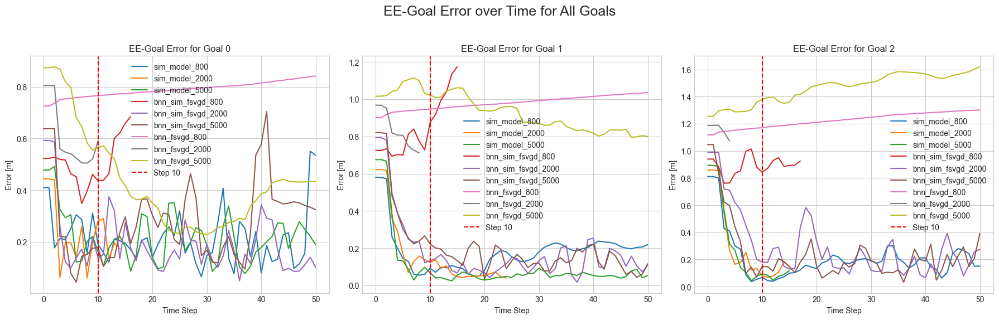

Performing analysis for Goal 1


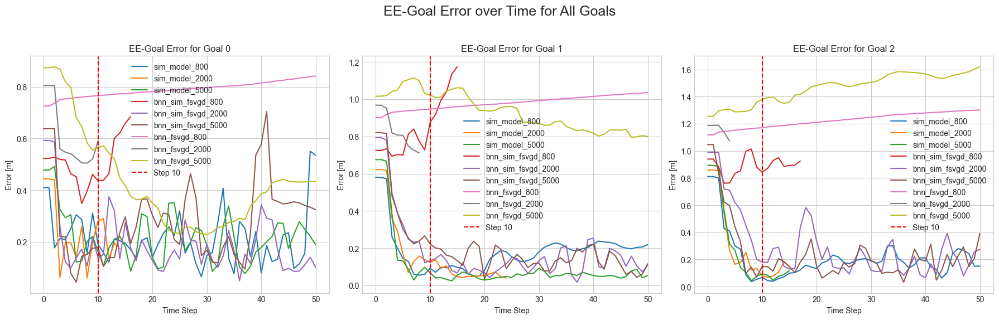

Performing analysis for Goal 2


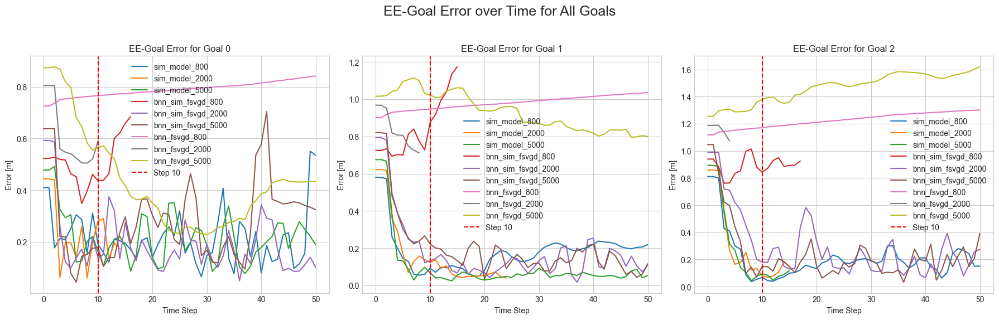

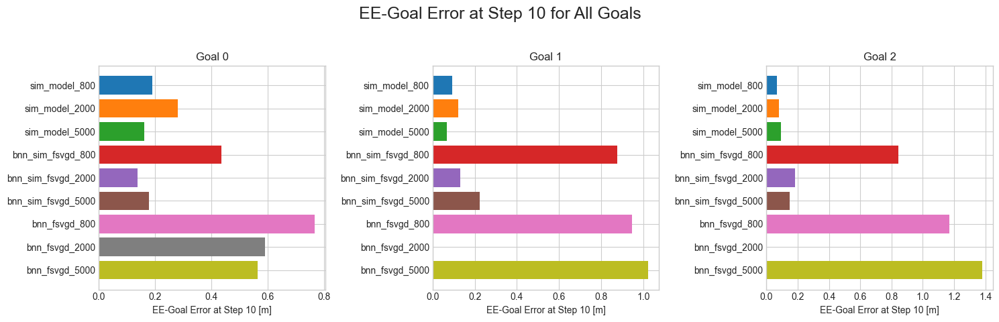

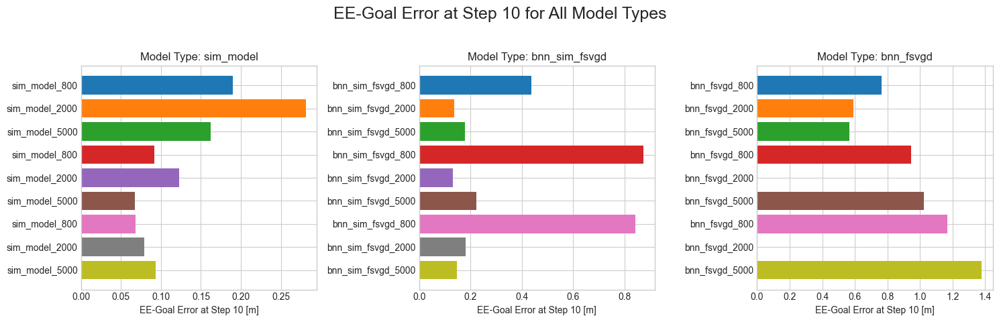

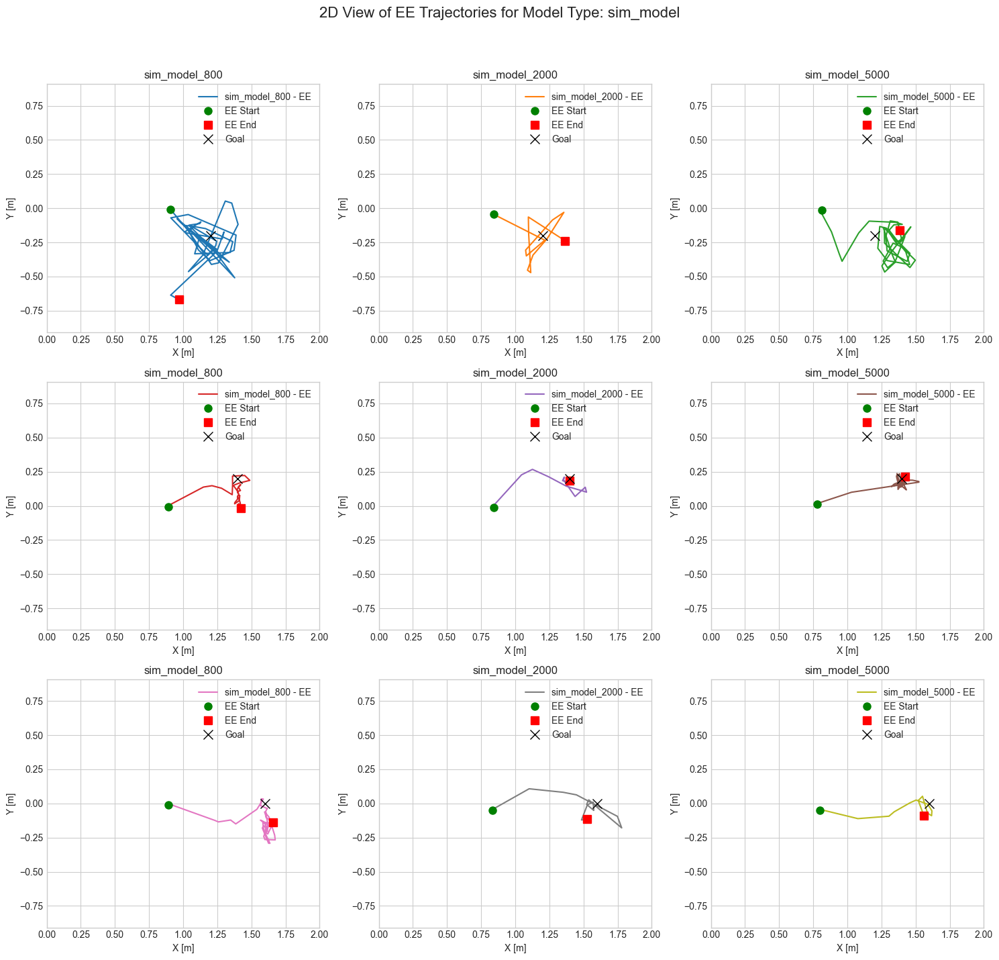

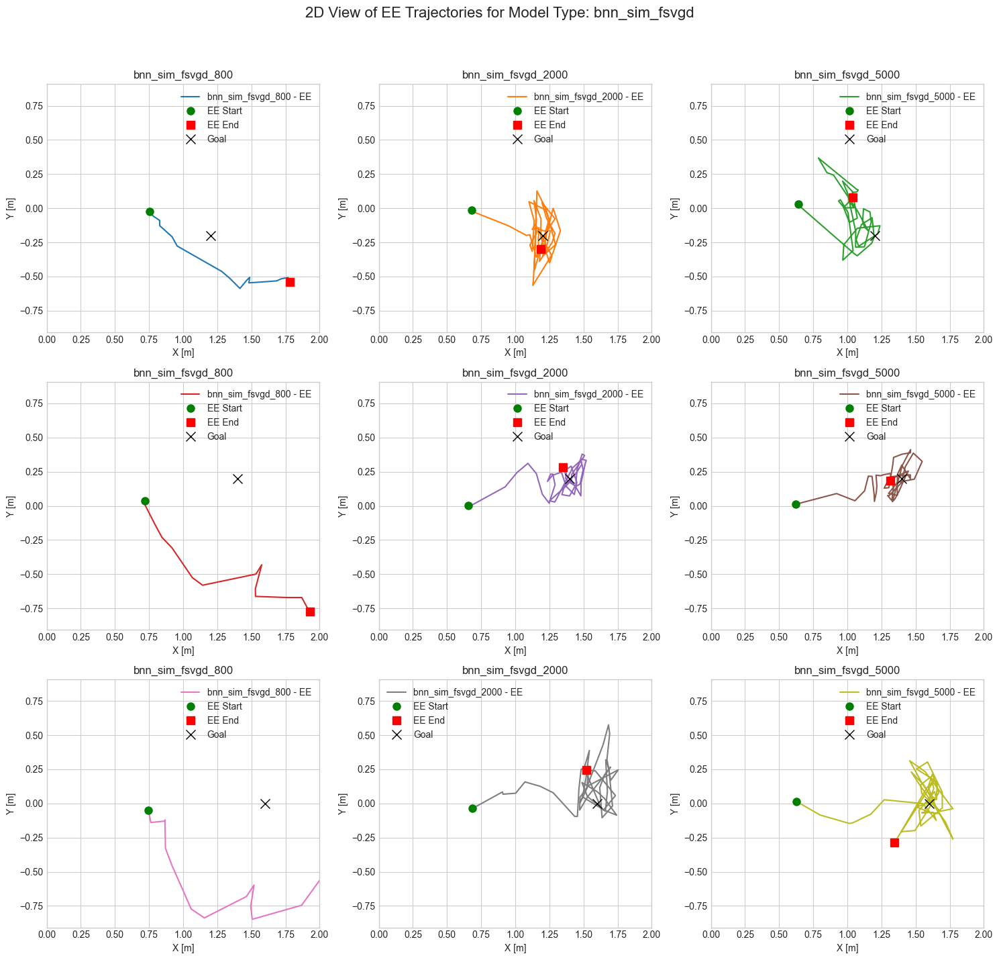

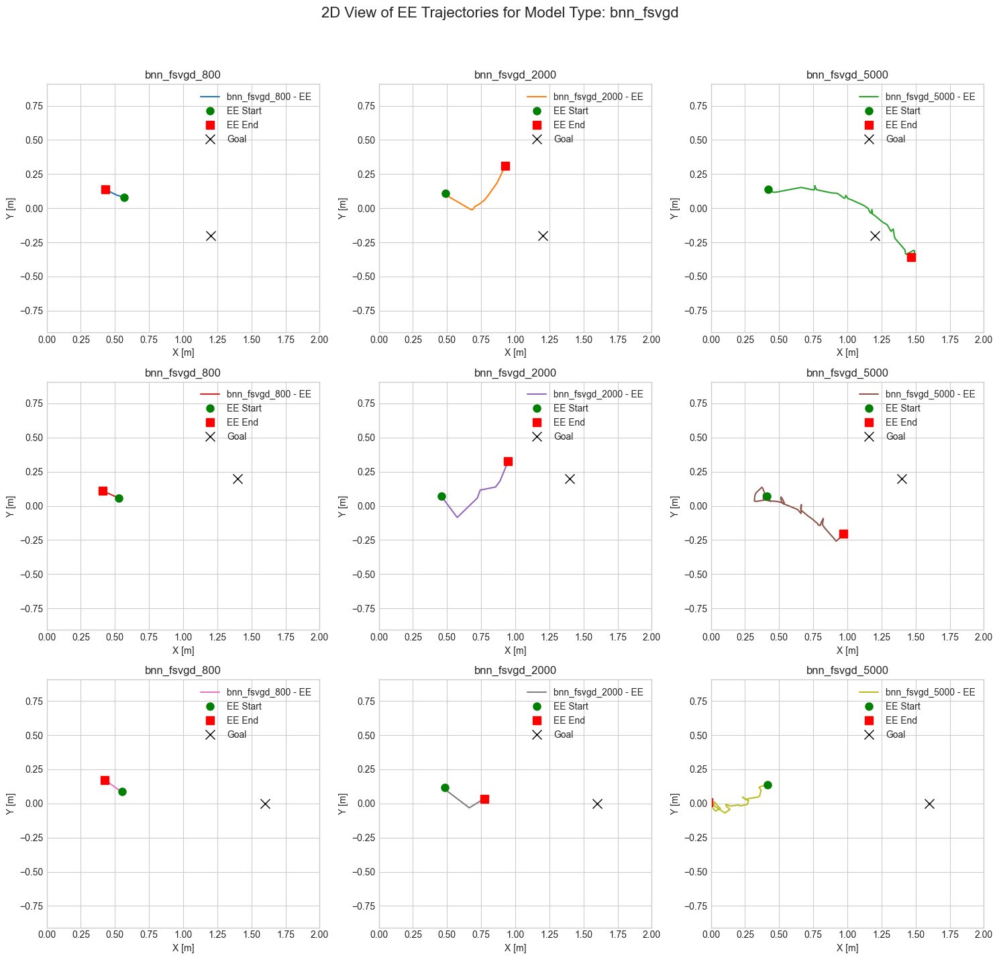

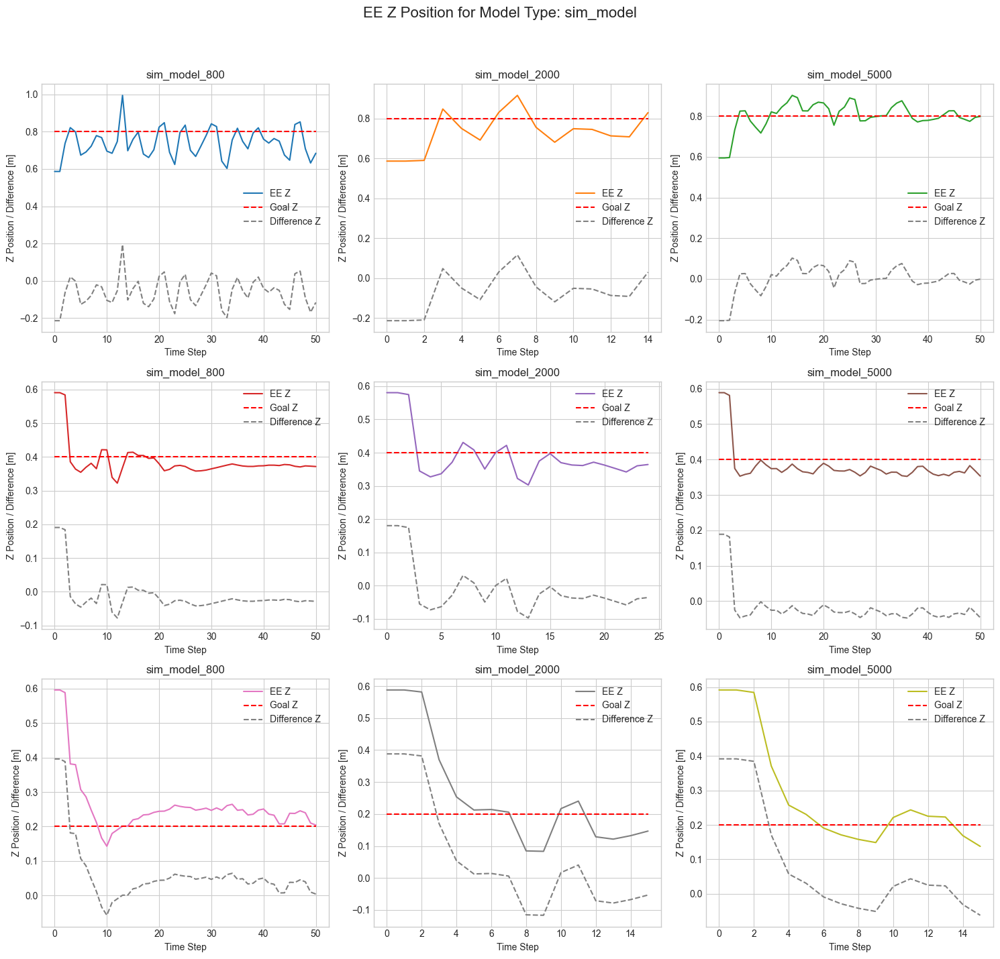

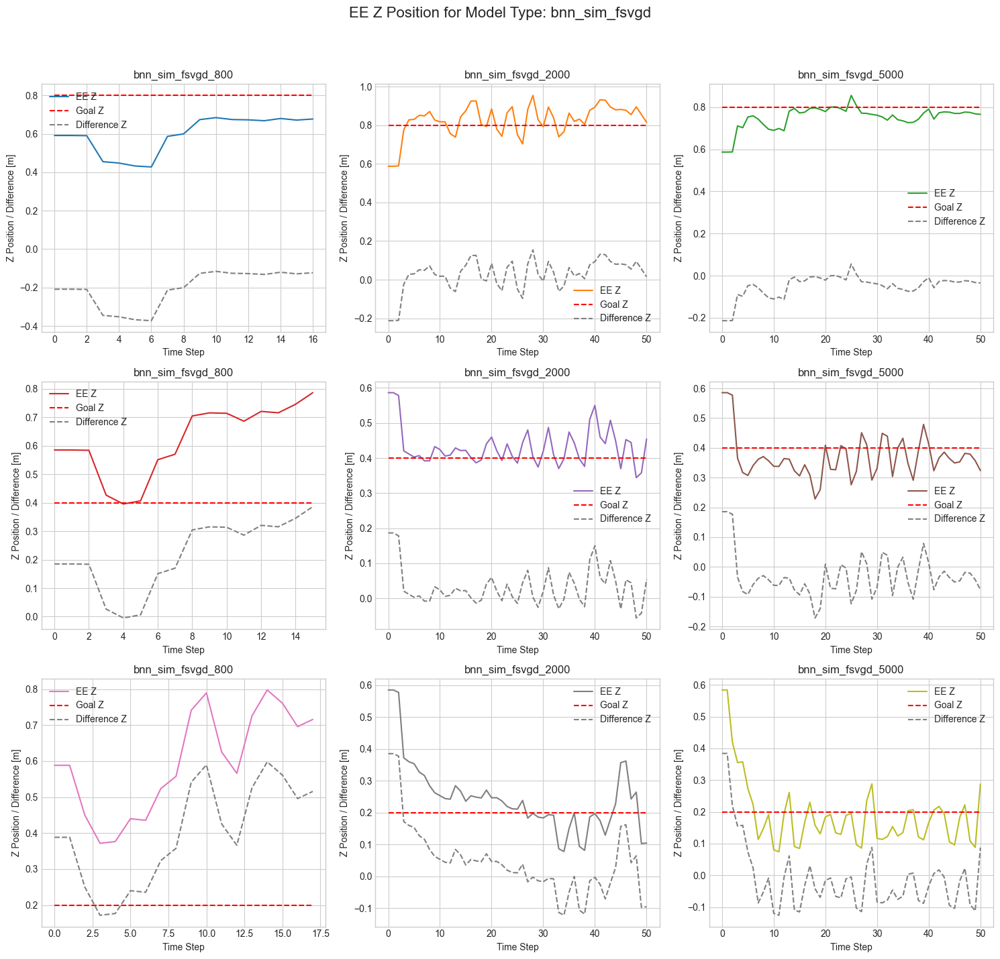

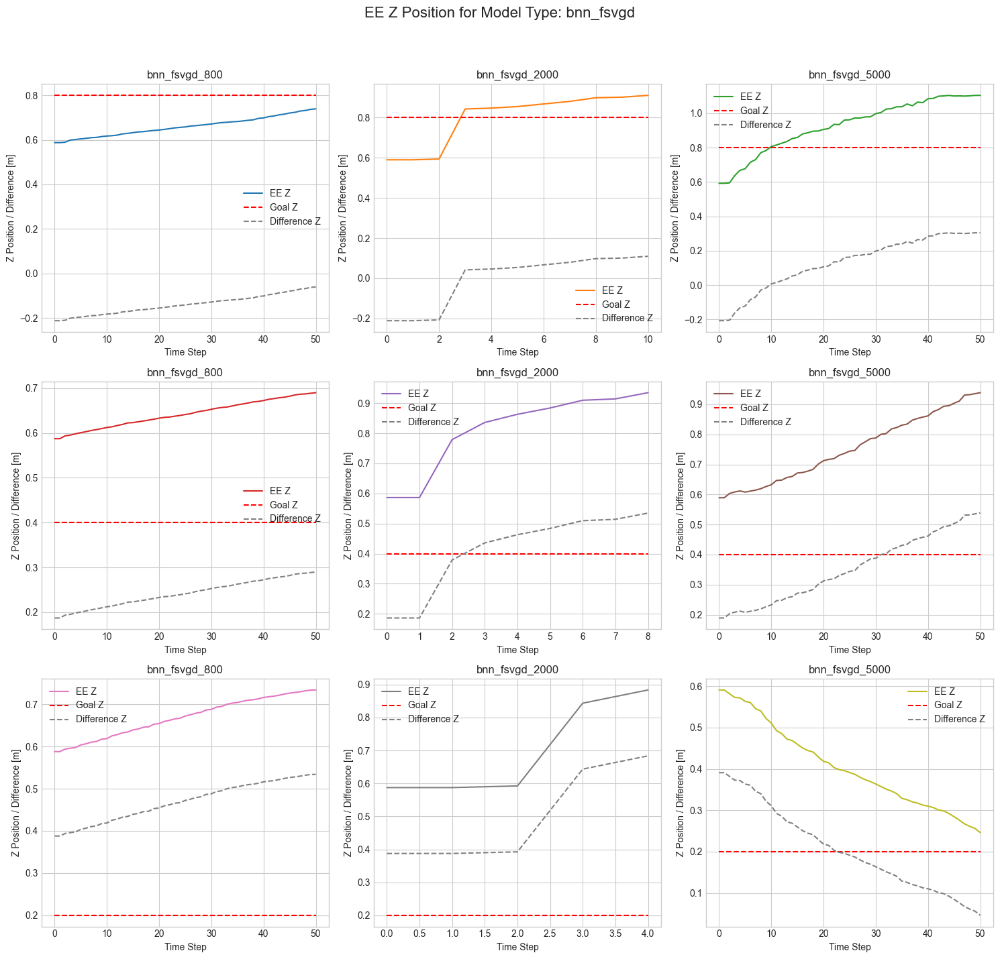

In [2]:
import pickle
import numpy as np
import matplotlib.pyplot as plt
from sim_transfer.sims.util import decode_angles
from brax.training.types import Transition
import jax.tree_util as jtu
import jax.numpy as jnp
import re

# Use a style for better aesthetics
plt.style.use("seaborn-v0_8-whitegrid")

# Global variables
step_index = 10  # Define the step index for error calculation
plot_analysis = False  # Set to True to enable 'Analysis for Goal x' plots

# Define the list of trajectory files and their corresponding labels
file_paths = [
    # uses goal 0
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150458_policy_testing_partial_v4_hck2b2u0_sim-model_800_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150610_policy_testing_partial_v4_chn3iu4r_sim-model_2000_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150732_policy_testing_partial_v4_yjgeqtmy_sim-model_5000_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150840_policy_testing_partial_v4_sq0k6akn_bnn-sim-fsvgd_800_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150940_policy_testing_partial_v4_k5kepn4q_bnn-sim-fsvgd_2000_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151040_policy_testing_partial_v4_891g63gq_bnn-sim-fsvgd_5000_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151158_policy_testing_partial_v4_hjbw63y8_bnn-fsvgd_800_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151259_policy_testing_partial_v4_0dslu87b_bnn-fsvgd_2000_3_0__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151342_policy_testing_partial_v4_hq7f5yzu_bnn-fsvgd_5000_3_0__0.8/brax_transitions.pickle",
    
    # uses goal 1
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151922_policy_testing_partial_v4_hck2b2u0_sim-model_800_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152030_policy_testing_partial_v4_chn3iu4r_sim-model_2000_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152121_policy_testing_partial_v4_yjgeqtmy_sim-model_5000_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152233_policy_testing_partial_v4_sq0k6akn_bnn-sim-fsvgd_800_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152321_policy_testing_partial_v4_k5kepn4q_bnn-sim-fsvgd_2000_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152422_policy_testing_partial_v4_891g63gq_bnn-sim-fsvgd_5000_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152521_policy_testing_partial_v4_hjbw63y8_bnn-fsvgd_800_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152618_policy_testing_partial_v4_0dslu87b_bnn-fsvgd_2000_3_1__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152707_policy_testing_partial_v4_hq7f5yzu_bnn-fsvgd_5000_3_1__0.8/brax_transitions.pickle",

    # uses goal 2
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153401_policy_testing_partial_v4_hck2b2u0_sim-model_800_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153511_policy_testing_partial_v4_chn3iu4r_sim-model_2000_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153617_policy_testing_partial_v4_yjgeqtmy_sim-model_5000_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153718_policy_testing_partial_v4_sq0k6akn_bnn-sim-fsvgd_800_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153806_policy_testing_partial_v4_k5kepn4q_bnn-sim-fsvgd_2000_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153907_policy_testing_partial_v4_891g63gq_bnn-sim-fsvgd_5000_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-154010_policy_testing_partial_v4_hjbw63y8_bnn-fsvgd_800_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-154103_policy_testing_partial_v4_0dslu87b_bnn-fsvgd_2000_3_2__0.8/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-154148_policy_testing_partial_v4_hq7f5yzu_bnn-fsvgd_5000_3_2__0.8/brax_transitions.pickle",
]

labels = [
    # uses goal 0
    "sim_model_800",
    "sim_model_2000",
    "sim_model_5000",
    "bnn_sim_fsvgd_800",
    "bnn_sim_fsvgd_2000",
    "bnn_sim_fsvgd_5000",
    "bnn_fsvgd_800",
    "bnn_fsvgd_2000",
    "bnn_fsvgd_5000",
    
    # uses goal 1
    "sim_model_800",
    "sim_model_2000",
    "sim_model_5000",
    "bnn_sim_fsvgd_800",
    "bnn_sim_fsvgd_2000",
    "bnn_sim_fsvgd_5000",
    "bnn_fsvgd_800",
    "bnn_fsvgd_2000",
    "bnn_fsvgd_5000",

    # uses goal 2
    "sim_model_800",
    "sim_model_2000",
    "sim_model_5000",
    "bnn_sim_fsvgd_800",
    "bnn_sim_fsvgd_2000",
    "bnn_sim_fsvgd_5000",
    "bnn_fsvgd_800",
    "bnn_fsvgd_2000",
    "bnn_fsvgd_5000",
]

goal_1 = jnp.array([1.2, -0.2, 0.8])
goal_2 = jnp.array([1.4, 0.2, 0.4])
goal_3 = jnp.array([1.6, 0.0, 0.2])

goals = [goal_1, goal_2, goal_3]

# Set global x and y limits for the 2D plots
x_limits = (0.0, 2.0)
y_limits = (-1.5, 1.5)

# Initialize dictionaries to store data per goal and per model type
goal_data = {}
model_data = {}

def get_model_type(label):
    """Extract model type from label."""
    return '_'.join(label.split('_')[:-1])

# Loop over each trajectory file
for idx, file_path in enumerate(file_paths):
    # Load trajectory from policy simulation
    with open(file_path, "rb") as file:
        traj_raw = pickle.load(file)

    # Extract goal index from file path
    match = re.search(r'_3_(\d+)__', file_path)
    if match:
        goal_index = int(match.group(1))
    else:
        # Default to 0 or raise an error
        goal_index = 0
    if goal_index >= len(goals):
        print(f"Goal index {goal_index} out of range for file {file_path}")
        goal_index = 0  # Handle as appropriate

    goal = goals[goal_index]

    label = labels[idx]
    model_type = get_model_type(label)

    # Initialize data structures for this goal if not already done
    if goal_index not in goal_data:
        goal_data[goal_index] = {
            'file_paths': [],
            'labels': [],
            'observations': [],
            'actions': [],
            'rewards': [],
            'ee_goal_errors_at_step': [],
        }

    # Initialize data structures for this model type if not already done
    if model_type not in model_data:
        model_data[model_type] = {
            'labels': [],
            'observations': [],
            'actions': [],
            'rewards': [],
            'ee_goal_errors_at_step': [],
        }

    # Add goal to observations
    def add_goal_to_obs(obs: jnp.ndarray, goal: jnp.ndarray) -> jnp.ndarray:
        return jnp.concatenate([obs, goal])

    new_traj = []

    # Add goal to each observation in the trajectory
    for i in range(len(traj_raw)):
        obs = traj_raw[i].observation
        next_obs = traj_raw[i].next_observation
        obs = add_goal_to_obs(obs, goal)
        next_obs = add_goal_to_obs(next_obs, goal)
        new_traj.append(
            Transition(
                observation=obs,
                action=traj_raw[i].action,
                reward=jnp.array(0),
                next_observation=next_obs,
                discount=traj_raw[i].discount,
            )
        )

    traj = jtu.tree_map(lambda *xs: jnp.stack(xs, axis=0), *new_traj)

    # Convert transitions to trajectory
    observations = traj.observation
    actions = traj.action
    rewards = traj.reward

    # Decode angles if needed
    if observations.shape[-1] == 16:
        print(f"Decoding angles for {file_path}")
        observations = decode_angles(observations, 2)

    # Convert observations to numpy array
    observations_np = np.array(observations)

    # Calculate EE-Goal error at step_index for this trajectory
    ee_pos = observations_np[:, 6:9]
    goal_pos = observations_np[:, -3:]
    error = np.linalg.norm(ee_pos - goal_pos, axis=1)
    if len(error) > step_index:
        ee_goal_error_at_step = error[step_index]
    else:
        # Handle case where trajectory is shorter than step_index+1 steps
        ee_goal_error_at_step = np.nan

    # Append data to the corresponding goal
    goal_data[goal_index]['file_paths'].append(file_path)
    goal_data[goal_index]['labels'].append(label)
    goal_data[goal_index]['observations'].append(observations_np)
    goal_data[goal_index]['actions'].append(np.array(actions))
    goal_data[goal_index]['rewards'].append(np.array(rewards))
    goal_data[goal_index]['ee_goal_errors_at_step'].append(ee_goal_error_at_step)

    # Append data to the corresponding model type
    model_data[model_type]['labels'].append(label)
    model_data[model_type]['observations'].append(observations_np)
    model_data[model_type]['actions'].append(np.array(actions))
    model_data[model_type]['rewards'].append(np.array(rewards))
    model_data[model_type]['ee_goal_errors_at_step'].append(ee_goal_error_at_step)

# Plotting functions

def plot_ee_2d_view_per_model(model_data, x_limits, y_limits):
    """Plot EE trajectories per model type with subplots for each version."""
    for model_type, data in model_data.items():
        observations = data['observations']
        labels = data['labels']
        num_models = len(observations)
        num_cols = 3
        num_rows = (num_models + num_cols - 1) // num_cols

        fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))
        axs = axs.flatten()
        cmap = plt.get_cmap("tab10")

        for idx, obs in enumerate(observations):
            ax = axs[idx]
            color = cmap(idx % 10)
            label = labels[idx]
            # Plot EE trajectory
            ax.plot(obs[:, 6], obs[:, 7], label=f"{label} - EE", color=color)
            # Plot EE start and end points
            ax.plot(obs[0, 6], obs[0, 7], "o", color='green', markersize=8, label="EE Start")
            ax.plot(obs[-1, 6], obs[-1, 7], "s", color='red', markersize=8, label="EE End")
            # Plot goal position
            ax.plot(obs[0, -3], obs[0, -2], "x", color='black', markersize=10, label="Goal")
            ax.set_title(f"{label}")
            ax.set_xlabel("X [m]")
            ax.set_ylabel("Y [m]")
            ax.axis("equal")
            ax.set_xlim(x_limits)
            ax.set_ylim(y_limits)
            ax.legend()
            ax.grid(True)

        # Hide any unused subplots
        for idx in range(len(observations), len(axs)):
            fig.delaxes(axs[idx])

        plt.suptitle(f"2D View of EE Trajectories for Model Type: {model_type}", fontsize=16)
        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()

def plot_ee_z_position_per_model(model_data):
    """Plot EE Z position per model type with subplots for each version."""
    for model_type, data in model_data.items():
        observations = data['observations']
        labels = data['labels']
        num_models = len(observations)
        num_cols = 3
        num_rows = (num_models + num_cols - 1) // num_cols

        fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))
        axs = axs.flatten()
        cmap = plt.get_cmap("tab10")

        for idx, obs in enumerate(observations):
            ax = axs[idx]
            color = cmap(idx % 10)
            label = labels[idx]
            time_steps = np.arange(obs.shape[0])
            ee_z = obs[:, 8]
            goal_z = obs[0, -1]
            ax.plot(time_steps, ee_z, label=f"EE Z", color=color)
            ax.hlines(goal_z, time_steps[0], time_steps[-1], colors="r", linestyles="--", label="Goal Z")
            diff_z = ee_z - goal_z
            ax.plot(time_steps, diff_z, linestyle="--", label=f"Difference Z", color='gray')
            ax.set_title(f"{label}")
            ax.set_xlabel("Time Step")
            ax.set_ylabel("Z Position / Difference [m]")
            ax.legend()
            ax.grid(True)

        # Hide any unused subplots
        for idx in range(len(observations), len(axs)):
            fig.delaxes(axs[idx])

        plt.suptitle(f"EE Z Position for Model Type: {model_type}", fontsize=16)
        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()

def plot_ee_goal_error(goal_data):
    """Plot EE-Goal Error over time with subplots for each goal."""
    num_goals = len(goal_data)
    num_cols = 3
    num_rows = (num_goals + num_cols - 1) // num_cols

    fig, axs = plt.subplots(num_rows, num_cols, figsize=(18, 6 * num_rows))
    axs = axs.flatten()
    cmap = plt.get_cmap("tab10")

    for idx, (goal_index, data) in enumerate(goal_data.items()):
        ax = axs[idx]
        observations = data['observations']
        labels = data['labels']
        for i, obs in enumerate(observations):
            color = cmap(i % 10)
            ee_pos = obs[:, 6:9]
            goal_pos = obs[:, -3:]
            error = np.linalg.norm(ee_pos - goal_pos, axis=1)
            time_steps = np.arange(len(error))
            ax.plot(time_steps, error, label=f"{labels[i]}", color=color)
        ax.axvline(step_index, color="r", linestyle="--", label=f"Step {step_index}")
        ax.set_title(f"EE-Goal Error for Goal {goal_index}")
        ax.set_xlabel("Time Step")
        ax.set_ylabel("Error [m]")
        ax.legend()
        ax.grid(True)

    # Hide any unused subplots
    for idx in range(len(goal_data), len(axs)):
        fig.delaxes(axs[idx])

    plt.suptitle("EE-Goal Error over Time for All Goals", fontsize=18)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

def plot_ee_goal_error_at_step(errors_per_goal, step_index):
    """Plot EE-Goal Error at a specific step with subplots per goal."""
    num_goals = len(errors_per_goal)
    num_cols = 3
    num_rows = (num_goals + num_cols - 1) // num_cols

    fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))
    axs = axs.flatten()
    cmap = plt.get_cmap("tab10")

    for idx, (goal_index, data) in enumerate(errors_per_goal.items()):
        errors = data['ee_goal_errors_at_step']
        labels_goal = data['labels']
        y_positions = np.arange(len(labels_goal))
        colors = [cmap(i % 10) for i in range(len(labels_goal))]
        ax = axs[idx]
        ax.barh(y_positions, errors, align="center", color=colors)
        ax.set_yticks(y_positions)
        ax.set_yticklabels(labels_goal)
        ax.set_xlabel(f"EE-Goal Error at Step {step_index} [m]")
        ax.set_title(f"Goal {goal_index}")
        ax.invert_yaxis()
        ax.grid(True, axis="x")

    # Hide any unused subplots
    for idx in range(len(errors_per_goal), len(axs)):
        fig.delaxes(axs[idx])

    plt.suptitle(f"EE-Goal Error at Step {step_index} for All Goals", fontsize=18)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

def plot_ee_goal_error_at_step_per_model(errors_per_model, step_index):
    """Plot EE-Goal Error at a specific step with subplots per model type."""
    num_models = len(errors_per_model)
    num_cols = 3
    num_rows = (num_models + num_cols - 1) // num_cols

    fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))
    axs = axs.flatten()
    cmap = plt.get_cmap("tab10")

    for idx, (model_type, data) in enumerate(errors_per_model.items()):
        errors = data['ee_goal_errors_at_step']
        labels_model = data['labels']
        y_positions = np.arange(len(labels_model))
        colors = [cmap(i % 10) for i in range(len(labels_model))]
        ax = axs[idx]
        ax.barh(y_positions, errors, align="center", color=colors)
        ax.set_yticks(y_positions)
        ax.set_yticklabels(labels_model)
        ax.set_xlabel(f"EE-Goal Error at Step {step_index} [m]")
        ax.set_title(f"Model Type: {model_type}")
        ax.invert_yaxis()
        ax.grid(True, axis="x")

    # Hide any unused subplots
    for idx in range(len(errors_per_model), len(axs)):
        fig.delaxes(axs[idx])

    plt.suptitle(f"EE-Goal Error at Step {step_index} for All Model Types", fontsize=18)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

# Now, perform the analysis per goal
# Collect ee_goal_errors_at_step per goal and per model type for plotting
errors_per_goal = {}
errors_per_model = {}

for goal_index, data in goal_data.items():
    print(f"Performing analysis for Goal {goal_index}")
    observations = data['observations']
    actions = data['actions']
    labels = data['labels']
    ee_goal_errors_at_step = data['ee_goal_errors_at_step']
    rewards = data['rewards']

    errors_per_goal[goal_index] = {
        'ee_goal_errors_at_step': ee_goal_errors_at_step,
        'labels': labels
    }

    # Plot EE-Goal Error over time
    plot_ee_goal_error(goal_data)

    # Plot individual analyses if enabled
    if plot_analysis:
        # Plot the other subplots without the 2D view
        plot_goal_and_traj(observations, actions, labels, goal_index)

# Plot EE-Goal Error at Step x using subplots for each goal
plot_ee_goal_error_at_step(errors_per_goal, step_index)

# Collect errors per model type
for model_type, data in model_data.items():
    errors_per_model[model_type] = {
        'ee_goal_errors_at_step': data['ee_goal_errors_at_step'],
        'labels': data['labels']
    }

# Plot EE-Goal Error at Step x grouping by model type
plot_ee_goal_error_at_step_per_model(errors_per_model, step_index)

# Plot EE 2D Trajectories per model type
plot_ee_2d_view_per_model(model_data, x_limits, y_limits)

# Plot EE Z Position per model type
plot_ee_z_position_per_model(model_data)

# Optional: Define plot_goal_and_traj function if needed for analysis
def plot_goal_and_traj(traj_curr, actions_curr, labels, goal_index):
    # Adjusted subplots to exclude the 2D view
    fig, axs = plt.subplots(1, 4, figsize=(24, 6))
    ax2, ax3, ax4, ax5 = axs

    cmap = plt.get_cmap("tab10")  # Define colormap for consistency

    # 2. Z Component Analysis
    for idx, data in enumerate(traj_curr):
        color = cmap(idx % 10)
        ee_z = data[:, 8]
        goal_z = data[0, -1]
        time_steps = np.arange(data.shape[0])
        ax2.plot(time_steps, ee_z, label=f"{labels[idx]} - EE Z", color=color)
        ax2.hlines(
            goal_z,
            time_steps[0],
            time_steps[-1],
            colors="r",
            linestyles="--",
            label="Goal Z" if idx == 0 else None,
        )
        diff_z = ee_z - goal_z
        ax2.plot(
            time_steps,
            diff_z,
            linestyle="--",
            label=f"{labels[idx]} - Difference Z",
            color=color,
        )
    ax2.set_title("EE-Z Position")
    ax2.set_xlabel("Time Step")
    ax2.set_ylabel("Z Position / Difference [m]")
    ax2.legend()
    ax2.grid(True)

    # 3. EE-Goal Distance
    for idx, data in enumerate(traj_curr):
        color = cmap(idx % 10)
        ee_pos = data[:, 6:9]
        goal_pos = data[:, -3:]
        distance = np.linalg.norm(ee_pos - goal_pos, axis=1)
        time_steps = np.arange(data.shape[0])
        ax3.plot(time_steps, distance, label=f"{labels[idx]}", color=color)
    ax3.set_title("EE-Goal Distance")
    ax3.set_xlabel("Time Step")
    ax3.set_ylabel("Distance [m]")
    ax3.set_ylim(0, 2)
    ax3.legend()
    ax3.grid(True)

    # 4. EE-Base Distance
    for idx, data in enumerate(traj_curr):
        color = cmap(idx % 10)
        ee_pos = data[:, 6:9]
        base_pos = data[:, 0:3]
        distance = np.linalg.norm(ee_pos - base_pos, axis=1)
        time_steps = np.arange(data.shape[0])
        ax4.plot(time_steps, distance, label=f"{labels[idx]}", color=color)
    ax4.set_title("EE-Base Distance")
    ax4.set_xlabel("Time Step")
    ax4.set_ylabel("Distance [m]")
    ax4.legend()
    ax4.grid(True)

    # 5. Actions
    for idx, data in enumerate(actions_curr):
        color = cmap(idx % 10)
        time_steps = np.arange(data.shape[0])
        ax5.plot(time_steps, data[:, 0], label=f"{labels[idx]} - Base Vx", color=color)
        ax5.plot(time_steps, data[:, 1], label=f"{labels[idx]} - Base Vy", color=color)
        ax5.plot(
            time_steps, data[:, 2], label=f"{labels[idx]} - Base Vtheta", color=color
        )
        ax5.plot(time_steps, data[:, 3], label=f"{labels[idx]} - EE Vx", color=color)
        ax5.plot(time_steps, data[:, 4], label=f"{labels[idx]} - EE Vy", color=color)
        ax5.plot(time_steps, data[:, 5], label=f"{labels[idx]} - EE Vz", color=color)
    ax5.set_title("Actions")
    ax5.set_xlabel("Time Step")
    ax5.set_ylabel("Action [m/s or rad/s]")
    ax5.legend()
    ax5.grid(True)

    plt.suptitle(f"Analysis for Goal {goal_index}", fontsize=18)
    plt.tight_layout()
    plt.show()


Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241016-131049_action_stack_testing_xcmnhhfq_bnn-sim-fsvgd_5000_1_2__1.1/brax_transitions.pickle
Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241016-131152_action_stack_testing_xcmnhhfq_bnn-sim-fsvgd_5000_1_1__1.1/brax_transitions.pickle
Decoding angles for /home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241016-131252_action_stack_testing_xcmnhhfq_bnn-sim-fsvgd_5000_1_0__1.1/brax_transitions.pickle
Processing data for Goal 2
Processing data for Goal 1
Processing data for Goal 0


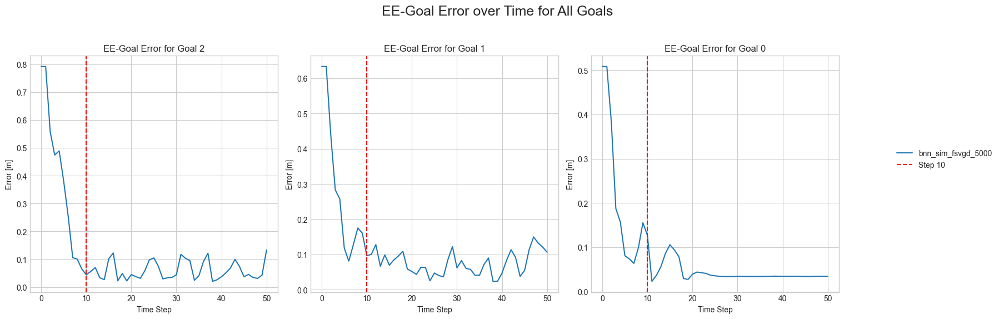

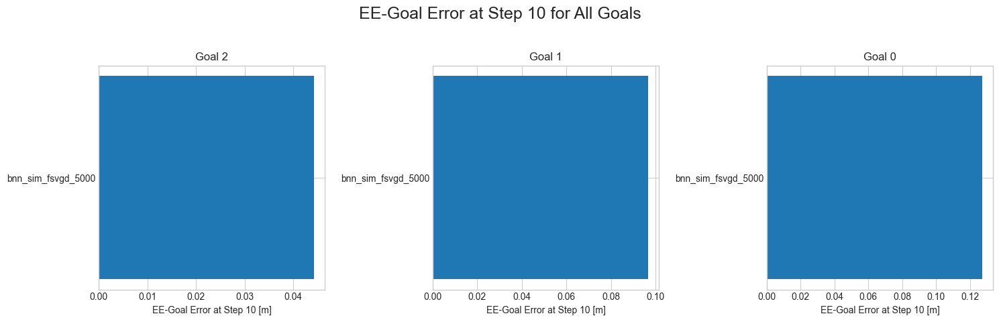

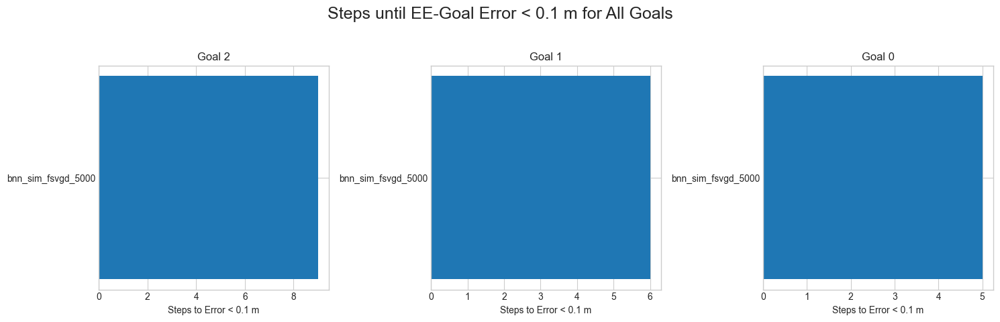

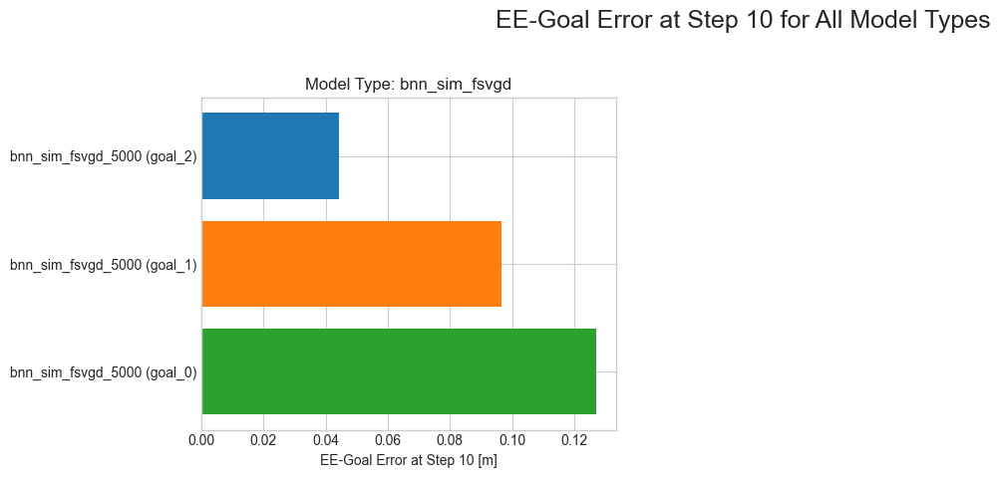

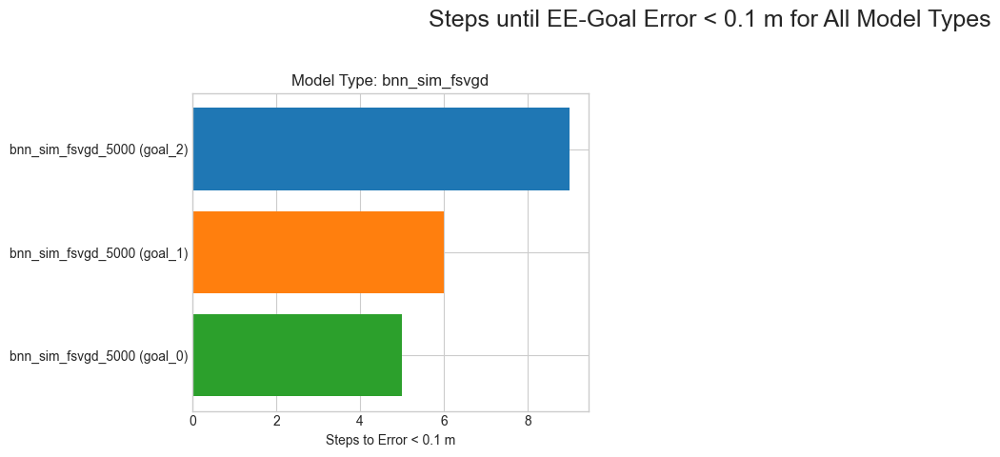

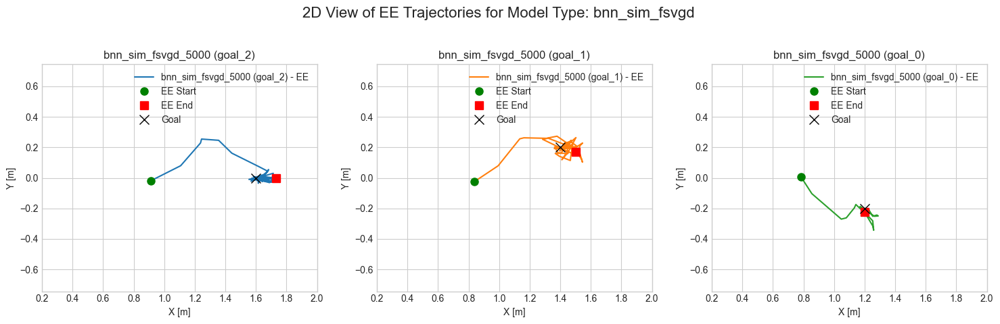

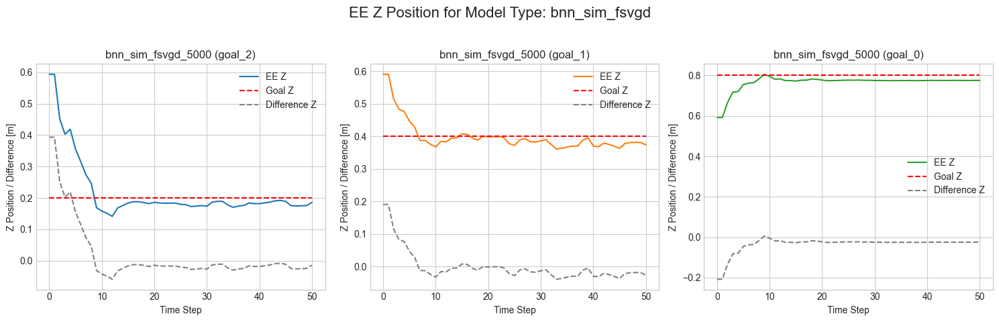

In [2]:
""" FUll evaluation of policy performance on real robot """

import pickle
import numpy as np
import matplotlib.pyplot as plt
from sim_transfer.sims.util import decode_angles
from brax.training.types import Transition
import jax.tree_util as jtu
import jax.numpy as jnp
import re

# Use a style for better aesthetics
plt.style.use('seaborn-v0_8-whitegrid')

# Global variables
step_index = 10  # Define the step index for error calculation
error_threshold = 0.1  # Threshold for EE-Goal error
plot_analysis = False  # Set to True to enable 'Analysis for Goal x' plots

# Define the list of trajectory files and their corresponding labels
file_paths = [
    # # uses goal 0
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150458_policy_testing_partial_v4_hck2b2u0_sim-model_800_3_0__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150610_policy_testing_partial_v4_chn3iu4r_sim-model_2000_3_0__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150732_policy_testing_partial_v4_yjgeqtmy_sim-model_5000_3_0__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150840_policy_testing_partial_v4_sq0k6akn_bnn-sim-fsvgd_800_3_0__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-150940_policy_testing_partial_v4_k5kepn4q_bnn-sim-fsvgd_2000_3_0__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151040_policy_testing_partial_v4_891g63gq_bnn-sim-fsvgd_5000_3_0__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151158_policy_testing_partial_v4_hjbw63y8_bnn-fsvgd_800_3_0__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151259_policy_testing_partial_v4_0dslu87b_bnn-fsvgd_2000_3_0__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151342_policy_testing_partial_v4_hq7f5yzu_bnn-fsvgd_5000_3_0__0.8/brax_transitions.pickle",
    
    # # uses goal 1
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-151922_policy_testing_partial_v4_hck2b2u0_sim-model_800_3_1__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152030_policy_testing_partial_v4_chn3iu4r_sim-model_2000_3_1__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152121_policy_testing_partial_v4_yjgeqtmy_sim-model_5000_3_1__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152233_policy_testing_partial_v4_sq0k6akn_bnn-sim-fsvgd_800_3_1__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152321_policy_testing_partial_v4_k5kepn4q_bnn-sim-fsvgd_2000_3_1__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152422_policy_testing_partial_v4_891g63gq_bnn-sim-fsvgd_5000_3_1__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152521_policy_testing_partial_v4_hjbw63y8_bnn-fsvgd_800_3_1__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152618_policy_testing_partial_v4_0dslu87b_bnn-fsvgd_2000_3_1__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-152707_policy_testing_partial_v4_hq7f5yzu_bnn-fsvgd_5000_3_1__0.8/brax_transitions.pickle",

    # # uses goal 2
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153401_policy_testing_partial_v4_hck2b2u0_sim-model_800_3_2__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153511_policy_testing_partial_v4_chn3iu4r_sim-model_2000_3_2__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153617_policy_testing_partial_v4_yjgeqtmy_sim-model_5000_3_2__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153718_policy_testing_partial_v4_sq0k6akn_bnn-sim-fsvgd_800_3_2__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153806_policy_testing_partial_v4_k5kepn4q_bnn-sim-fsvgd_2000_3_2__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-153907_policy_testing_partial_v4_891g63gq_bnn-sim-fsvgd_5000_3_2__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-154010_policy_testing_partial_v4_hjbw63y8_bnn-fsvgd_800_3_2__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-154103_policy_testing_partial_v4_0dslu87b_bnn-fsvgd_2000_3_2__0.8/brax_transitions.pickle",
    # "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241014-154148_policy_testing_partial_v4_hq7f5yzu_bnn-fsvgd_5000_3_2__0.8/brax_transitions.pickle",

    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241016-131049_action_stack_testing_xcmnhhfq_bnn-sim-fsvgd_5000_1_2__1.1/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241016-131152_action_stack_testing_xcmnhhfq_bnn-sim-fsvgd_5000_1_1__1.1/brax_transitions.pickle",
    "/home/bhoffman/Documents/MT FS24/active-learning-dynamics/collected_data/test20241016-131252_action_stack_testing_xcmnhhfq_bnn-sim-fsvgd_5000_1_0__1.1/brax_transitions.pickle",
]

labels = [
    # # uses goal 0
    # "sim_model_800",
    # "sim_model_2000",
    # "sim_model_5000",
    # "bnn_sim_fsvgd_800",
    # "bnn_sim_fsvgd_2000",
    # "bnn_sim_fsvgd_5000",
    # "bnn_fsvgd_800",
    # "bnn_fsvgd_2000",
    # "bnn_fsvgd_5000",
    
    # # uses goal 1
    # "sim_model_800",
    # "sim_model_2000",
    # "sim_model_5000",
    # "bnn_sim_fsvgd_800",
    # "bnn_sim_fsvgd_2000",
    # "bnn_sim_fsvgd_5000",
    # "bnn_fsvgd_800",
    # "bnn_fsvgd_2000",
    # "bnn_fsvgd_5000",

    # # uses goal 2
    # "sim_model_800",
    # "sim_model_2000",
    # "sim_model_5000",
    # "bnn_sim_fsvgd_800",
    # "bnn_sim_fsvgd_2000",
    # "bnn_sim_fsvgd_5000",
    # "bnn_fsvgd_800",
    # "bnn_fsvgd_2000",
    # "bnn_fsvgd_5000",
    "bnn_sim_fsvgd_5000",
    "bnn_sim_fsvgd_5000",
    "bnn_sim_fsvgd_5000",
]

goal_1 = jnp.array([1.2, -0.2, 0.8])
goal_2 = jnp.array([1.4, 0.2, 0.4])
goal_3 = jnp.array([1.6, 0.0, 0.2])

goals = [goal_1, goal_2, goal_3]

# Set global x and y limits for the 2D plots
x_limits = (0.2, 2.0)
y_limits = (-1.5, 1.5)

# Initialize dictionaries to store data per goal and per model type
goal_data = {}
model_data = {}

def get_model_type(label):
    """Extract model type from label."""
    parts = label.split('_')
    if len(parts) > 2:
        return '_'.join(parts[:-1])
    else:
        return label

# Loop over each trajectory file
for idx, file_path in enumerate(file_paths):
    # Load trajectory from policy simulation
    with open(file_path, "rb") as file:
        traj_raw = pickle.load(file)

    # Extract goal index from file path
    match = re.search(r'_(\d+)__', file_path)
    if match:
        goal_index = int(match.group(1))
    else:
        # Default to 0 or raise an error
        goal_index = 0
    if goal_index >= len(goals):
        print(f"Goal index {goal_index} out of range for file {file_path}")
        goal_index = 0  # Handle as appropriate

    goal = goals[goal_index]

    label = labels[idx]
    model_type = get_model_type(label)

    # Initialize data structures for this goal if not already done
    if goal_index not in goal_data:
        goal_data[goal_index] = {
            'file_paths': [],
            'labels': [],
            'observations': [],
            'actions': [],
            'rewards': [],
            'ee_goal_errors_at_step': [],
            'steps_below_threshold': [],
        }

    # Initialize data structures for this model type if not already done
    if model_type not in model_data:
        model_data[model_type] = {
            'labels': [],
            'observations': [],
            'actions': [],
            'rewards': [],
            'ee_goal_errors_at_step': [],
            'steps_below_threshold': [],
            'goals': [],
        }

    # Add goal to observations
    def add_goal_to_obs(obs: jnp.ndarray, goal: jnp.ndarray) -> jnp.ndarray:
        return jnp.concatenate([obs, goal])

    new_traj = []

    # Add goal to each observation in the trajectory
    for i in range(len(traj_raw)):
        obs = traj_raw[i].observation
        next_obs = traj_raw[i].next_observation
        obs = add_goal_to_obs(obs, goal)
        next_obs = add_goal_to_obs(next_obs, goal)
        new_traj.append(
            Transition(
                observation=obs,
                action=traj_raw[i].action,
                reward=jnp.array(0),
                next_observation=next_obs,
                discount=traj_raw[i].discount,
            )
        )

    traj = jtu.tree_map(lambda *xs: jnp.stack(xs, axis=0), *new_traj)

    # Convert transitions to trajectory
    observations = traj.observation
    actions = traj.action
    rewards = traj.reward

    # Decode angles if needed
    if observations.shape[-1] == 16:
        print(f"Decoding angles for {file_path}")
        observations = decode_angles(observations, 2)

    # Convert observations to numpy array
    observations_np = np.array(observations)

    # Calculate EE-Goal error over time
    ee_pos = observations_np[:, 6:9]
    goal_pos = observations_np[:, -3:]
    error = np.linalg.norm(ee_pos - goal_pos, axis=1)

    # EE-Goal error at step_index
    if len(error) > step_index:
        ee_goal_error_at_step = error[step_index]
    else:
        ee_goal_error_at_step = np.nan

    # Steps until error drops below threshold
    steps_below_threshold = np.where(error < error_threshold)[0]
    if steps_below_threshold.size > 0:
        steps_to_threshold = steps_below_threshold[0]
    else:
        steps_to_threshold = np.nan  # Did not reach threshold

    # Append data to the corresponding goal
    goal_data[goal_index]['file_paths'].append(file_path)
    goal_data[goal_index]['labels'].append(label)
    goal_data[goal_index]['observations'].append(observations_np)
    goal_data[goal_index]['actions'].append(np.array(actions))
    goal_data[goal_index]['rewards'].append(np.array(rewards))
    goal_data[goal_index]['ee_goal_errors_at_step'].append(ee_goal_error_at_step)
    goal_data[goal_index]['steps_below_threshold'].append(steps_to_threshold)

    # Append data to the corresponding model type
    model_data[model_type]['labels'].append(f"{label} (goal_{goal_index})")
    model_data[model_type]['observations'].append(observations_np)
    model_data[model_type]['actions'].append(np.array(actions))
    model_data[model_type]['rewards'].append(np.array(rewards))
    model_data[model_type]['ee_goal_errors_at_step'].append(ee_goal_error_at_step)
    model_data[model_type]['steps_below_threshold'].append(steps_to_threshold)
    model_data[model_type]['goals'].append(goal_index)

# Plotting functions

def plot_ee_2d_view_per_model(model_data, x_limits, y_limits):
    """Plot EE trajectories per model type with subplots for each version."""
    for model_type, data in model_data.items():
        observations = data['observations']
        labels = data['labels']
        num_models = len(observations)
        num_cols = 3
        num_rows = (num_models + num_cols - 1) // num_cols

        fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))
        axs = axs.flatten()
        cmap = plt.get_cmap("tab10")

        for idx, obs in enumerate(observations):
            ax = axs[idx]
            color = cmap(idx % 10)
            label = labels[idx]
            # Plot EE trajectory
            ax.plot(obs[:, 6], obs[:, 7], label=f"{label} - EE", color=color)
            # Plot EE start and end points
            ax.plot(obs[0, 6], obs[0, 7], "o", color='green', markersize=8, label="EE Start")
            ax.plot(obs[-1, 6], obs[-1, 7], "s", color='red', markersize=8, label="EE End")
            # Plot goal position
            ax.plot(obs[0, -3], obs[0, -2], "x", color='black', markersize=10, label="Goal")
            ax.set_title(f"{label}")
            ax.set_xlabel("X [m]")
            ax.set_ylabel("Y [m]")
            ax.axis("equal")
            ax.set_xlim(x_limits)
            ax.set_ylim(y_limits)
            ax.legend()
            ax.grid(True)

        # Hide any unused subplots
        for idx in range(len(observations), len(axs)):
            fig.delaxes(axs[idx])

        plt.suptitle(f"2D View of EE Trajectories for Model Type: {model_type}", fontsize=16)
        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()

def plot_ee_z_position_per_model(model_data):
    """Plot EE Z position per model type with subplots for each version."""
    for model_type, data in model_data.items():
        observations = data['observations']
        labels = data['labels']
        num_models = len(observations)
        num_cols = 3
        num_rows = (num_models + num_cols - 1) // num_cols

        fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))
        axs = axs.flatten()
        cmap = plt.get_cmap("tab10")

        for idx, obs in enumerate(observations):
            ax = axs[idx]
            color = cmap(idx % 10)
            label = labels[idx]
            time_steps = np.arange(obs.shape[0])
            ee_z = obs[:, 8]
            goal_z = obs[0, -1]
            ax.plot(time_steps, ee_z, label=f"EE Z", color=color)
            ax.hlines(goal_z, time_steps[0], time_steps[-1], colors="r", linestyles="--", label="Goal Z")
            diff_z = ee_z - goal_z
            ax.plot(time_steps, diff_z, linestyle="--", label=f"Difference Z", color='gray')
            ax.set_title(f"{label}")
            ax.set_xlabel("Time Step")
            ax.set_ylabel("Z Position / Difference [m]")
            ax.legend()
            ax.grid(True)

        # Hide any unused subplots
        for idx in range(len(observations), len(axs)):
            fig.delaxes(axs[idx])

        plt.suptitle(f"EE Z Position for Model Type: {model_type}", fontsize=16)
        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()

def plot_ee_goal_error(goal_data):
    """Plot EE-Goal Error over time with subplots for each goal."""
    num_goals = len(goal_data)
    num_cols = 3
    num_rows = (num_goals + num_cols - 1) // num_cols

    fig, axs = plt.subplots(num_rows, num_cols, figsize=(18, 6 * num_rows))
    axs = axs.flatten()
    cmap = plt.get_cmap("tab10")

    for idx, (goal_index, data) in enumerate(goal_data.items()):
        ax = axs[idx]
        observations = data['observations']
        labels = data['labels']
        for i, obs in enumerate(observations):
            color = cmap(i % 10)
            ee_pos = obs[:, 6:9]
            goal_pos = obs[:, -3:]
            error = np.linalg.norm(ee_pos - goal_pos, axis=1)
            time_steps = np.arange(len(error))
            ax.plot(time_steps, error, label=f"{labels[i]}", color=color)
        ax.axvline(step_index, color="r", linestyle="--", label=f"Step {step_index}")
        ax.set_title(f"EE-Goal Error for Goal {goal_index}")
        ax.set_xlabel("Time Step")
        ax.set_ylabel("Error [m]")
        ax.grid(True)
        if (idx+1) % num_cols == 0 or idx == len(goal_data) - 1:
            # Add legend to the right of the last subplot in the row
            handles, labels_leg = ax.get_legend_handles_labels()
            fig.legend(handles, labels_leg, loc='center right')

    # Hide any unused subplots
    for idx in range(len(goal_data), len(axs)):
        fig.delaxes(axs[idx])

    plt.suptitle("EE-Goal Error over Time for All Goals", fontsize=18)
    plt.tight_layout(rect=[0, 0.03, 0.85, 0.95])  # Adjusted to make room for legend
    plt.show()

def plot_ee_goal_error_at_step(errors_per_goal, step_index):
    """Plot EE-Goal Error at a specific step with subplots per goal."""
    num_goals = len(errors_per_goal)
    num_cols = 3
    num_rows = (num_goals + num_cols - 1) // num_cols

    fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))
    axs = axs.flatten()
    cmap = plt.get_cmap("tab10")

    for idx, (goal_index, data) in enumerate(errors_per_goal.items()):
        errors = data['ee_goal_errors_at_step']
        labels_goal = data['labels']
        y_positions = np.arange(len(labels_goal))
        colors = [cmap(i % 10) for i in range(len(labels_goal))]
        ax = axs[idx]
        ax.barh(y_positions, errors, align="center", color=colors)
        ax.set_yticks(y_positions)
        ax.set_yticklabels(labels_goal)
        ax.set_xlabel(f"EE-Goal Error at Step {step_index} [m]")
        ax.set_title(f"Goal {goal_index}")
        ax.invert_yaxis()
        ax.grid(True, axis="x")

    # Hide any unused subplots
    for idx in range(len(errors_per_goal), len(axs)):
        fig.delaxes(axs[idx])

    plt.suptitle(f"EE-Goal Error at Step {step_index} for All Goals", fontsize=18)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

def plot_steps_below_threshold(errors_per_goal, threshold):
    """Plot number of steps until EE-Goal error drops below threshold, with subplots per goal."""
    num_goals = len(errors_per_goal)
    num_cols = 3
    num_rows = (num_goals + num_cols - 1) // num_cols

    fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))
    axs = axs.flatten()
    cmap = plt.get_cmap("tab10")

    for idx, (goal_index, data) in enumerate(errors_per_goal.items()):
        steps = data['steps_below_threshold']
        labels_goal = data['labels']
        y_positions = np.arange(len(labels_goal))
        colors = [cmap(i % 10) for i in range(len(labels_goal))]
        ax = axs[idx]
        ax.barh(y_positions, steps, align="center", color=colors)
        ax.set_yticks(y_positions)
        ax.set_yticklabels(labels_goal)
        ax.set_xlabel(f"Steps to Error < {threshold} m")
        ax.set_title(f"Goal {goal_index}")
        ax.invert_yaxis()
        ax.grid(True, axis="x")

    # Hide any unused subplots
    for idx in range(len(errors_per_goal), len(axs)):
        fig.delaxes(axs[idx])

    plt.suptitle(f"Steps until EE-Goal Error < {threshold} m for All Goals", fontsize=18)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

def plot_ee_goal_error_at_step_per_model(errors_per_model, step_index):
    """Plot EE-Goal Error at a specific step with subplots per model type."""
    num_models = len(errors_per_model)
    num_cols = 3
    num_rows = (num_models + num_cols - 1) // num_cols

    fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))
    axs = axs.flatten()
    cmap = plt.get_cmap("tab10")

    for idx, (model_type, data) in enumerate(errors_per_model.items()):
        errors = data['ee_goal_errors_at_step']
        labels_model = data['labels']
        y_positions = np.arange(len(labels_model))
        colors = [cmap(i % 10) for i in range(len(labels_model))]
        ax = axs[idx]
        ax.barh(y_positions, errors, align="center", color=colors)
        ax.set_yticks(y_positions)
        ax.set_yticklabels(labels_model)
        ax.set_xlabel(f"EE-Goal Error at Step {step_index} [m]")
        ax.set_title(f"Model Type: {model_type}")
        ax.invert_yaxis()
        ax.grid(True, axis="x")

    # Hide any unused subplots
    for idx in range(len(errors_per_model), len(axs)):
        fig.delaxes(axs[idx])

    plt.suptitle(f"EE-Goal Error at Step {step_index} for All Model Types", fontsize=18)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

def plot_steps_below_threshold_per_model(errors_per_model, threshold):
    """Plot steps until EE-Goal error drops below threshold, with subplots per model type."""
    num_models = len(errors_per_model)
    num_cols = 3
    num_rows = (num_models + num_cols - 1) // num_cols

    fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))
    axs = axs.flatten()
    cmap = plt.get_cmap("tab10")

    for idx, (model_type, data) in enumerate(errors_per_model.items()):
        steps = data['steps_below_threshold']
        labels_model = data['labels']
        y_positions = np.arange(len(labels_model))
        colors = [cmap(i % 10) for i in range(len(labels_model))]
        ax = axs[idx]
        ax.barh(y_positions, steps, align="center", color=colors)
        ax.set_yticks(y_positions)
        ax.set_yticklabels(labels_model)
        ax.set_xlabel(f"Steps to Error < {threshold} m")
        ax.set_title(f"Model Type: {model_type}")
        ax.invert_yaxis()
        ax.grid(True, axis="x")

    # Hide any unused subplots
    for idx in range(len(errors_per_model), len(axs)):
        fig.delaxes(axs[idx])

    plt.suptitle(f"Steps until EE-Goal Error < {threshold} m for All Model Types", fontsize=18)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

# Now, perform the analysis per goal
# Collect ee_goal_errors_at_step per goal and per model type for plotting
errors_per_goal = {}
errors_per_model = {}

for goal_index, data in goal_data.items():
    print(f"Processing data for Goal {goal_index}")
    observations = data['observations']
    actions = data['actions']
    labels = data['labels']
    ee_goal_errors_at_step = data['ee_goal_errors_at_step']
    steps_below_threshold = data['steps_below_threshold']
    rewards = data['rewards']

    errors_per_goal[goal_index] = {
        'ee_goal_errors_at_step': ee_goal_errors_at_step,
        'steps_below_threshold': steps_below_threshold,
        'labels': labels
    }

# Collect errors per model type
for model_type, data in model_data.items():
    errors_per_model[model_type] = {
        'ee_goal_errors_at_step': data['ee_goal_errors_at_step'],
        'steps_below_threshold': data['steps_below_threshold'],
        'labels': data['labels'],
        'goals': data['goals']
    }

# Plot EE-Goal Error over time for all goals once
plot_ee_goal_error(goal_data)

# Plot EE-Goal Error at Step x using subplots for each goal
plot_ee_goal_error_at_step(errors_per_goal, step_index)

# Plot Steps until EE-Goal Error drops below threshold per goal
plot_steps_below_threshold(errors_per_goal, error_threshold)

# Plot EE-Goal Error at Step x grouping by model type
plot_ee_goal_error_at_step_per_model(errors_per_model, step_index)

# Plot Steps until EE-Goal Error drops below threshold per model type
plot_steps_below_threshold_per_model(errors_per_model, error_threshold)

# Plot EE 2D Trajectories per model type
plot_ee_2d_view_per_model(model_data, x_limits, y_limits)

# Plot EE Z Position per model type
plot_ee_z_position_per_model(model_data)

# Optional: Define plot_goal_and_traj function if needed for analysis
def plot_goal_and_traj(traj_curr, actions_curr, labels, goal_index):
    # Adjusted subplots to exclude the 2D view
    fig, axs = plt.subplots(1, 4, figsize=(24, 6))
    ax2, ax3, ax4, ax5 = axs

    cmap = plt.get_cmap("tab10")  # Define colormap for consistency

    # 2. Z Component Analysis
    for idx, data in enumerate(traj_curr):
        color = cmap(idx % 10)
        ee_z = data[:, 8]
        goal_z = data[0, -1]
        time_steps = np.arange(data.shape[0])
        ax2.plot(time_steps, ee_z, label=f"{labels[idx]} - EE Z", color=color)
        ax2.hlines(
            goal_z,
            time_steps[0],
            time_steps[-1],
            colors="r",
            linestyles="--",
            label="Goal Z" if idx == 0 else None,
        )
        diff_z = ee_z - goal_z
        ax2.plot(
            time_steps,
            diff_z,
            linestyle="--",
            label=f"{labels[idx]} - Difference Z",
            color=color,
        )
    ax2.set_title("EE-Z Position")
    ax2.set_xlabel("Time Step")
    ax2.set_ylabel("Z Position / Difference [m]")
    ax2.legend()
    ax2.grid(True)

    # 3. EE-Goal Distance
    for idx, data in enumerate(traj_curr):
        color = cmap(idx % 10)
        ee_pos = data[:, 6:9]
        goal_pos = data[:, -3:]
        distance = np.linalg.norm(ee_pos - goal_pos, axis=1)
        time_steps = np.arange(data.shape[0])
        ax3.plot(time_steps, distance, label=f"{labels[idx]}", color=color)
    ax3.set_title("EE-Goal Distance")
    ax3.set_xlabel("Time Step")
    ax3.set_ylabel("Distance [m]")
    ax3.set_ylim(0, 2)
    ax3.legend()
    ax3.grid(True)

    # 4. EE-Base Distance
    for idx, data in enumerate(traj_curr):
        color = cmap(idx % 10)
        ee_pos = data[:, 6:9]
        base_pos = data[:, 0:3]
        distance = np.linalg.norm(ee_pos - base_pos, axis=1)
        time_steps = np.arange(data.shape[0])
        ax4.plot(time_steps, distance, label=f"{labels[idx]}", color=color)
    ax4.set_title("EE-Base Distance")
    ax4.set_xlabel("Time Step")
    ax4.set_ylabel("Distance [m]")
    ax4.legend()
    ax4.grid(True)

    # 5. Actions
    for idx, data in enumerate(actions_curr):
        color = cmap(idx % 10)
        time_steps = np.arange(data.shape[0])
        ax5.plot(time_steps, data[:, 0], label=f"{labels[idx]} - Base Vx", color=color)
        ax5.plot(time_steps, data[:, 1], label=f"{labels[idx]} - Base Vy", color=color)
        ax5.plot(
            time_steps, data[:, 2], label=f"{labels[idx]} - Base Vtheta", color=color
        )
        ax5.plot(time_steps, data[:, 3], label=f"{labels[idx]} - EE Vx", color=color)
        ax5.plot(time_steps, data[:, 4], label=f"{labels[idx]} - EE Vy", color=color)
        ax5.plot(time_steps, data[:, 5], label=f"{labels[idx]} - EE Vz", color=color)
    ax5.set_title("Actions")
    ax5.set_xlabel("Time Step")
    ax5.set_ylabel("Action [m/s or rad/s]")
    ax5.legend()
    ax5.grid(True)

    plt.suptitle(f"Analysis for Goal {goal_index}", fontsize=18)
    plt.tight_layout()
    plt.show()
